## AIM: Train Graph Convulation Networks (GCNs) as multiclass classification models for predicting the psychiatric diagnosis based on EEG features

Standard GCN, and GraphLambda with & without edge attributes for predicting psychiatric diagnosis with statistical features of the power per frequency band per channel group (frontal, central, parietal, occipital) and connectivity features per frequency band per channel group (l/m/r; frontal, central, ). Statistical features are calculated with EC data, EO data and a with the ratio between EC divided by EO.

Have to use features before feature selection, to maintain even dimensions for each graph. Stat features are standardized before training. Models are tuned using multi-objective Optuna, maximizing val f1 and minimizing val loss

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os

import optuna

import lightning.pytorch as pl
import torch
import torch_geometric
import torch.nn.functional as F
from torch.nn import Sequential, Linear, ReLU, BatchNorm1d, Dropout, Dropout1d
from torch_geometric.nn import  GCNConv, global_add_pool,GATConv,GINConv, GATv2Conv
from torch_geometric.loader import DataLoader
from torch_geometric.data import Data
from torch_geometric.utils.convert import from_networkx, to_networkx
import lightning.pytorch as pl
from torchmetrics import F1Score, ConfusionMatrix
from lightning.pytorch.tuner import Tuner
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import ModelCheckpoint, TQDMProgressBar, RichProgressBar
from lightning.pytorch.callbacks.early_stopping import EarlyStopping

from optuna.visualization.matplotlib import plot_contour
from optuna.visualization.matplotlib import plot_edf
from optuna.visualization.matplotlib import plot_intermediate_values
from optuna.visualization.matplotlib import plot_optimization_history
from optuna.visualization.matplotlib import plot_parallel_coordinate
from optuna.visualization.matplotlib import plot_param_importances
from optuna.visualization.matplotlib import plot_rank
from optuna.visualization.matplotlib import plot_slice
from optuna.visualization.matplotlib import plot_timeline

### Load data & features

In [2]:
import pickle
def load_file(file):
    with open(file, 'rb') as handle:
        return pickle.load(handle)

In [3]:
# import stat & conn features without feature selection
df_stat_conn_features = pd.read_pickle('df_stat_conn_features.pkl')
df_stat_conn_features = df_stat_conn_features.dropna(subset=['diagnosis'])

# label encode diagnosis
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(df_stat_conn_features['diagnosis'])
df_stat_conn_features['diagnosis'] = le.transform(df_stat_conn_features['diagnosis'])

print(df_stat_conn_features.shape)
df_stat_conn_features.sample(3)

(2700, 1218)


,ID,diagnosis,epoch,EO_l_frontal_delta_std,EO_l_frontal_delta_mean,EO_l_frontal_delta_median,EO_l_frontal_delta_skew,EO_l_frontal_delta_kurt,EO_l_frontal_theta_std,EO_l_frontal_theta_mean,...,ratio_gamma_m_central-r_central,ratio_gamma_m_central-l_posterior,ratio_gamma_m_central-m_posterior,ratio_gamma_m_central-r_posterior,ratio_gamma_r_central-l_posterior,ratio_gamma_r_central-m_posterior,ratio_gamma_r_central-r_posterior,ratio_gamma_l_posterior-m_posterior,ratio_gamma_l_posterior-r_posterior,ratio_gamma_m_posterior-r_posterior
1461,sub-88043021,2,10,0.060401,0.099901,0.099901,0.938354,0.859010,0.033402,0.066984,...,1.069126,1.049291,1.056960,1.077076,1.080787,1.080953,1.103856,1.045908,1.060083,1.037568
2468,sub-88069113,0,9,0.085818,0.096292,0.096292,1.766116,3.557314,0.032907,0.059183,...,1.003773,0.977856,1.004847,1.001907,0.982445,1.010489,1.015607,0.972922,0.941517,0.974298
2201,sub-88063713,3,6,0.062013,0.095142,0.095142,1.038943,0.754757,0.031900,0.068122,...,1.008178,1.005482,1.013697,1.015167,0.986748,0.983663,0.983104,1.003634,1.015597,1.003252


In [4]:
# create 3 feature sets [EC, EO, ratio] with column ['ID', 'age', 'gender', 'diagnosis', 'epoch']
df_stat_conn_features_ec = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EO') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_eo = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('ratio'))]]
df_stat_conn_features_ratio = df_stat_conn_features[df_stat_conn_features.columns[~(df_stat_conn_features.columns.str.startswith('EC') | df_stat_conn_features.columns.str.startswith('EO'))]]
print(df_stat_conn_features_ratio.shape)
print(df_stat_conn_features_ec.shape)
print(df_stat_conn_features_eo.shape)

(2700, 408)
(2700, 408)
(2700, 408)


In [5]:
synchrony_feature_dict = load_file('synchrony_feature_dict.pkl')
subjects_ec_syncro_matrices = synchrony_feature_dict['EC_syncro']
subjects_eo_syncro_matrices = synchrony_feature_dict['EO_syncro']
subjects_ec_ids = synchrony_feature_dict['EC_IDs']
subjects_eo_ids = synchrony_feature_dict['EO_IDs']
print(len(subjects_ec_syncro_matrices), len(subjects_eo_syncro_matrices))
print(len(subjects_ec_ids), len(subjects_eo_ids))
print(subjects_ec_syncro_matrices[0].shape)
print(subjects_ec_ids[0])

224 225
224 225
(12, 5, 9, 9)
sub-87964717


In [6]:
# compute ratio [EC/EO] synchrony matrices

# Convert the lists to sets
subjects_ec_ids_set = set(subjects_ec_ids)
subjects_eo_ids_set = set(subjects_eo_ids)

# find the missing IDs to make sure ratio is computed within the same participant
missing_ids = subjects_eo_ids_set - subjects_ec_ids_set
missing_ids_indices = [subjects_eo_ids.index(id) for id in missing_ids]

# remove missing IDs from EO
ratio_subjects_eo_syncro_matrices = [matrix for i, matrix in enumerate(subjects_eo_syncro_matrices) if i not in missing_ids_indices]
assert len(ratio_subjects_eo_syncro_matrices) == len(subjects_ec_syncro_matrices)

# compute ratio
subjects_ratio_syncro_matrices = []
for i in range(len(subjects_ec_syncro_matrices)):
    ratio_matrix = subjects_ec_syncro_matrices[i] / ratio_subjects_eo_syncro_matrices[i]
    subjects_ratio_syncro_matrices.append(ratio_matrix)
subjects_ratio_ids = subjects_ec_ids
print(len(subjects_ratio_syncro_matrices), len(subjects_ratio_ids))

224 224


/tmp/ipykernel_1631227/1473655494.py:18: RuntimeWarning: invalid value encountered in divide
  ratio_matrix = subjects_ec_syncro_matrices[i] / ratio_subjects_eo_syncro_matrices[i]


In [7]:
# define function to store features in PyTorch Geometric Data objects
import networkx as nx
from joblib import Parallel, delayed # for parallel processing
from tqdm import tqdm
def process_subject(syncros, subject_id, df_features):
    graph_dataset = []
    y_list = []

    # obtain statistical features for subject
    subject_stat_features = df_features[df_features['ID'] == subject_id]
    stat_columns = ['epoch', 'mean', 'median', 'std', 'kurt', 'skew'] # select statistical features
    pattern = '|'.join(stat_columns)  # create a pattern string
    subject_stat_features = subject_stat_features[subject_stat_features.columns[subject_stat_features.columns.str.contains(pattern)]]
    
    for epoch, syncro_matrices in enumerate(syncros):
        num_edges = int((syncro_matrices.shape[1] * (syncro_matrices.shape[2] - 1)) / 2)
        bands = syncro_matrices.shape[0]
        edge_attrs = np.zeros((num_edges, bands)) # create empty array to store edge weights for each frequency band

        for i, syncro_matrix in enumerate(syncro_matrices):
            # print(f'{syncro_matrix.shape = }')
            syncro_graph = nx.from_numpy_array(syncro_matrix)
            # print(f'{syncro_graph = }')
            edge_list = nx.to_pandas_edgelist(syncro_graph)
            edge_list = edge_list.dropna(axis=0)
            # print(f'{edge_list = }')
            edge_index = edge_list.iloc[:,0:2].values.T # shape (2, num_edges), edge_index stays the same for all bands right?
            # print(f'{edge_index = }')
            edge_attr = edge_list.iloc[:,2].values#.reshape(-1,1)
            edge_attrs[:,i] = edge_attr

        y = df_stat_conn_features_ec[df_stat_conn_features_ec['ID'] == subject_id]['diagnosis'].values[0]
        
        # store statistical features for subject
        ch_groups = ['l_frontal', 'm_frontal', 'r_frontal', 'l_central', 'm_central', 'r_central', 'l_posterior', 'm_posterior', 'r_posterior']
        bands = ['delta', 'theta', 'alpha', 'beta', 'gamma']
        x = np.zeros((len(ch_groups), len(bands) * (len(stat_columns)-1))) # -1 because of epochs column in stat_columns
        # print(x.shape)
        for num, ch_group in enumerate(ch_groups):
            x[num] = subject_stat_features[subject_stat_features['epoch'] == (epoch + 1)][subject_stat_features.columns[subject_stat_features.columns.str.contains(ch_group)]].values[0]
            

        data = Data(x=torch.tensor(x, dtype=torch.float),                     # Node features [num_nodes, num_node_features]
                    edge_index=torch.tensor(edge_index, dtype=torch.long),    # Adjacency matrix [2, num_edges]
                    edge_attr=torch.tensor(edge_attrs,dtype=torch.float),  # Edge features [num_edges, num_edge_features]
                    y=torch.tensor([y], dtype=torch.long))                    # Target/Label (it should be a list) --> torch.long for classification, torch.float for regression
        graph_dataset.append(data)
        y_list.append(y)

    return graph_dataset, y_list

In [8]:
# retrieve and store data for EC features
# subjects__ec/eo_syncro_matrices : A list of lists, every list is a subject, every element in that list is an array of shape [n_epochs, n_bands, n_channels, n_channels]

results = Parallel(n_jobs=-1)(delayed(process_subject)(syncros, subject_id, df_stat_conn_features_ec) for syncros, subject_id in tqdm(zip(subjects_ec_syncro_matrices, subjects_ec_ids), total=len(subjects_ec_syncro_matrices)))

ec_graph_dataset = []
ec_y_list = []
for result in results:
    ec_graph_dataset.extend(result[0])
    ec_y_list.extend(result[1])
    
assert len(ec_graph_dataset) == len(ec_y_list)

print(f'{ec_graph_dataset[0].x.shape = }, stat features [num_nodes, num_node_features]')
print(f'{ec_graph_dataset[0].edge_attr.shape = }, [num_edges, n_bands]')
print(f'{ec_graph_dataset[0].edge_index.shape = }, [2, num_edges]')
print(f'{len(ec_graph_dataset) = }, subjects: {len(subjects_ec_syncro_matrices)}, epochs: {len(subjects_ec_syncro_matrices[0])}')
print(f'{ec_graph_dataset[0] = }')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 224/224 [00:05<00:00, 37.85it/s]


ec_graph_dataset[0].x.shape = torch.Size([9, 25]), stat features [num_nodes, num_node_features]
ec_graph_dataset[0].edge_attr.shape = torch.Size([36, 5]), [num_edges, n_bands]
ec_graph_dataset[0].edge_index.shape = torch.Size([2, 36]), [2, num_edges]
len(ec_graph_dataset) = 2688, subjects: 224, epochs: 12
ec_graph_dataset[0] = Data(x=[9, 25], edge_index=[2, 36], edge_attr=[36, 5], y=[1])


In [9]:
# retrieve and store data for EO features
# subjects__ec/eo_syncro_matrices : A list of lists, every list is a subject, every element in that list is an array of shape [n_epochs, n_bands, n_channels, n_channels]

results = Parallel(n_jobs=-1)(delayed(process_subject)(syncros, subject_id, df_stat_conn_features_eo) for syncros, subject_id in tqdm(zip(subjects_eo_syncro_matrices, subjects_eo_ids), total=len(subjects_eo_syncro_matrices)))

eo_graph_dataset = []
eo_y_list = []
for result in results:
    eo_graph_dataset.extend(result[0])
    eo_y_list.extend(result[1])
    
assert len(eo_graph_dataset) == len(eo_y_list)

print(f'{eo_graph_dataset[0].x.shape = }, stat features [num_nodes, num_node_features]')
print(f'{eo_graph_dataset[0].edge_attr.shape = }, [num_edges, n_bands]')
print(f'{eo_graph_dataset[0].edge_index.shape = }, [2, num_edges]')
print(f'{len(eo_graph_dataset) = }, subjects: {len(subjects_eo_syncro_matrices)}, epochs: {len(subjects_eo_syncro_matrices[0])}')
print(f'{eo_graph_dataset[0] = }')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 225/225 [00:02<00:00, 93.76it/s]


eo_graph_dataset[0].x.shape = torch.Size([9, 25]), stat features [num_nodes, num_node_features]
eo_graph_dataset[0].edge_attr.shape = torch.Size([36, 5]), [num_edges, n_bands]
eo_graph_dataset[0].edge_index.shape = torch.Size([2, 36]), [2, num_edges]
len(eo_graph_dataset) = 2700, subjects: 225, epochs: 12
eo_graph_dataset[0] = Data(x=[9, 25], edge_index=[2, 36], edge_attr=[36, 5], y=[1])


In [10]:
# retrieve and store data for EO features
# subjects__ec/eo_syncro_matrices : A list of lists, every list is a subject, every element in that list is an array of shape [n_epochs, n_bands, n_channels, n_channels]

results = Parallel(n_jobs=-1)(delayed(process_subject)(syncros, subject_id, df_stat_conn_features_ratio) for syncros, subject_id in tqdm(zip(subjects_ratio_syncro_matrices, subjects_ratio_ids), total=len(subjects_ratio_syncro_matrices)))

# process_subject(subjects_ratio_syncro_matrices[0], subjects_ratio_ids[0])

ratio_graph_dataset = []
ratio_y_list = []
for result in results:
    ratio_graph_dataset.extend(result[0])
    ratio_y_list.extend(result[1])
    
assert len(ratio_graph_dataset) == len(ratio_y_list)

print(f'{ratio_graph_dataset[0].x.shape = }, stat features [num_nodes, num_node_features]')
print(f'{ratio_graph_dataset[0].edge_attr.shape = }, [num_edges, n_bands]')
print(f'{ratio_graph_dataset[0].edge_index.shape = }, [2, num_edges]')
print(f'{len(ratio_graph_dataset) = }, subjects: {len(subjects_ratio_syncro_matrices)}, epochs: {len(subjects_ratio_syncro_matrices[0])}')
print(f'{ratio_graph_dataset[0] = }')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 224/224 [00:02<00:00, 87.08it/s]


ratio_graph_dataset[0].x.shape = torch.Size([9, 25]), stat features [num_nodes, num_node_features]
ratio_graph_dataset[0].edge_attr.shape = torch.Size([36, 5]), [num_edges, n_bands]
ratio_graph_dataset[0].edge_index.shape = torch.Size([2, 36]), [2, num_edges]
len(ratio_graph_dataset) = 2688, subjects: 224, epochs: 12
ratio_graph_dataset[0] = Data(x=[9, 25], edge_index=[2, 36], edge_attr=[36, 5], y=[1])


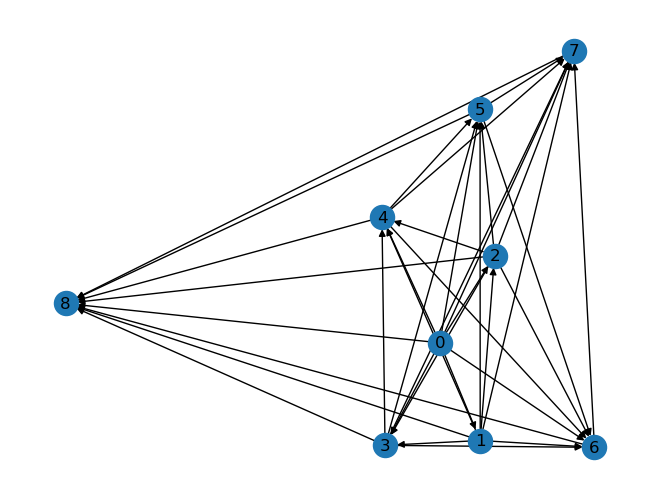

In [11]:
nx.draw(to_networkx(ratio_graph_dataset[0]), with_labels=True)

In [12]:
# load the indices of the validation sets from the ML models
data_split_indices = load_file('data_split_indices.pkl')

# GCN models:

### GCNConv with log_softmax activation function and NLLLoss

In [13]:
#Model
import lightning.pytorch as pl
from torchmetrics import F1Score, ConfusionMatrix
from torch.nn import Dropout1d
import seaborn as sns
import matplotlib.pyplot as plt

n_features = 25 # [Delta, Theta, Alpha, Beta, Gamma] * [mean, median, std, skew, kurt]
param = 64
num_classes = 5 # healthy, ADHD, MDD, OCD, SMC

class GCN(pl.LightningModule):
    def __init__(self, learning_rate, optimizer_name, dropout):
        super(GCN, self).__init__()
        self.learning_rate = learning_rate
        self.optimizer_name = optimizer_name

        self.conv1 = GCNConv(n_features, param, cached=False) # if you defined cache=True, the shape of batch must be same!
        self.bn1 = BatchNorm1d(param)
        self.do1 = Dropout1d(p=dropout)
        self.conv2 = GCNConv(param, param, cached=False)
        self.bn2 = BatchNorm1d(param)
        self.do2 = Dropout1d(p=dropout)
        self.fc1 = Linear(param, param)
        self.bn3 = BatchNorm1d(param)
        self.do3 = Dropout1d(p=dropout)
        self.fc2 = Linear(param, 8)
        self.fc3 = Linear(8, num_classes)

        # add metrics
        self.train_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_cm = ConfusionMatrix(task = 'binary', num_classes=num_classes, threshold=0.05)
        self.validation_step_yhats = []
        self.validation_step_ys = []

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = F.relu(self.conv1(x, edge_index))
        x = self.bn1(x)
        x = self.do1(x)
        x = F.relu(self.conv2(x, edge_index))
        x = self.bn2(x)
        x = self.do2(x)
        x = global_add_pool(x, data.batch)
        x = F.relu(self.fc1(x))
        x = self.bn3(x)
        x = self.do3(x)
        x = F.relu(self.fc2(x))
        #x = F.dropout(x, p=0.2, training=self.training)
        x = torch.flatten(x, start_dim=1)
        x = self.fc3(x)
        x = F.log_softmax(x, dim=1) # Activation function for classification
        return x
    
    def configure_optimizers(self):
        if self.optimizer_name == 'Adam':
            optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'RMSprop':
            optimizer = torch.optim.RMSprop(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'SGD':
            optimizer = torch.optim.SGD(self.parameters(), lr=self.learning_rate)
        else:
            raise ValueError(f'Unsupported optimizer: {self.optimizer_name}')
        return optimizer
    
    def training_step(self, train_batch, batch_idx):
            x, y = train_batch.x, train_batch.y
            output = self.forward(train_batch)
            loss = F.nll_loss(output, y)
            y_hat = output.argmax(dim=1)
            self.log('train_loss', loss, on_epoch=True, prog_bar=True)
            self.log('train_f1', self.train_f1(y, y_hat), on_epoch=True, prog_bar=True)
            return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch.x, val_batch.y
        output = self.forward(val_batch)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('val_loss', loss, on_epoch=True, prog_bar=True)
        self.log('val_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        self.validation_step_yhats.append(y_hat)
        self.validation_step_ys.append(y)
        return loss
    
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch.x, test_batch.y
        output = self.forward(test_batch)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('test_loss', loss, on_epoch=True, prog_bar=True)
        self.log('test_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        return loss

    # def on_train_epoch_end(self, training_step_outputs):
    #     # compute metrics
    #     train_f1 = self.train_f1.compute()
    #     # log metrics
    #     self.log("epoch_train_f1", train_f1)
    #     # reset all metrics
    #     self.train_f1.reset()
    #     print(f"\nf1: {train_f1:.4}")

    # def on_validation_epoch_end(self):
    #     # plot confusion matrix
    #     y_hat = torch.cat(self.validation_step_yhats)
    #     y = torch.cat(self.validation_step_ys)
    #     confusion_matrix = self.val_cm(y_hat, y.int())

    #     confusion_matrix_computed = confusion_matrix.detach().cpu().numpy().astype(int)

    #     df_cm = pd.DataFrame(confusion_matrix_computed)
    #     plt.figure(figsize = (10,7))
    #     fig_ = sns.heatmap(df_cm, annot=True, cmap='Spectral').get_figure()
    #     plt.close(fig_)
    #     self.loggers[0].experiment.add_figure("Confusion matrix", fig_, self.current_epoch)

    #     self.validation_step_yhats.clear() # free memory
    #     self.validation_step_ys.clear()
    
    def predict_step(self, batch):
        x, y = batch.x, batch.y
        output = self.forward(batch)
        y_hat = output.argmax(dim=1)
        return y_hat


    # def backward(self, trainer, loss, optimizer, optimizer_idx):
    #     loss.backward()
    
    # def optimizer_step(self, epoch, batch_idx, optimizer, optimizer_idx):
    #     optimizer.step()
    #     optimizer.zero_grad()

### Model: graphLambda without edge_attr

In [14]:
import lightning.pytorch as pl
from torchmetrics import F1Score, ConfusionMatrix
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import torch_geometric
from torch.nn import Sequential, Linear, ReLU, BatchNorm1d, Dropout, Dropout1d, ModuleList
import torch.nn.functional as F
from torch_geometric.nn import  GCNConv, global_add_pool, GATConv, GINConv


n_features = 25 # [Delta, Theta, Alpha, Beta, Gamma] * [mean, median, std, skew, kurt]
num_classes = 5 # healthy, ADHD, MDD, OCD, SMC

class graphLambda_wo_edge_attr(pl.LightningModule):
    def __init__(self, learning_rate, optimizer_name, fc_layers, dropout):
        super(graphLambda_wo_edge_attr, self).__init__()
        self.learning_rate = learning_rate
        self.optimizer_name = optimizer_name

        #GCN-representation
        self.conv1 = GCNConv(n_features, 256, cached=False )
        self.bn01 = BatchNorm1d(256)
        self.conv2 = GCNConv(256, 128, cached=False )
        self.bn02 = BatchNorm1d(128)
        self.conv3 = GCNConv(128, 128, cached=False)
        self.bn03 = BatchNorm1d(128)
        #GAT-representation
        self.gat1 = GATConv(n_features, 256, heads=3)
        self.bn11 = BatchNorm1d(256*3)
        self.gat2 = GATConv(256*3, 128, heads=3)
        self.bn12 = BatchNorm1d(128*3)
        self.gat3 = GATConv(128*3, 128, heads=3)
        self.bn13 = BatchNorm1d(128*3)
        #GIN-representation
        fc_gin1=Sequential(Linear(n_features, 256), ReLU(), Linear(256, 256))
        self.gin1 = GINConv(fc_gin1)
        self.bn21 = BatchNorm1d(256)
        fc_gin2=Sequential(Linear(256, 128), ReLU(), Linear(128, 128))
        self.gin2 = GINConv(fc_gin2)
        self.bn22 = BatchNorm1d(128)
        fc_gin3=Sequential(Linear(128, 64), ReLU(), Linear(64, 64))
        self.gin3 = GINConv(fc_gin3)
        self.bn23 = BatchNorm1d(64)
        # Fully connected layers for concatinating outputs (varied depending on fc_layers)
        self.fcs = ModuleList()
        self.dropouts = ModuleList()
        input_size = 128*4 + 64 # Input size for the first layer
        output_size = num_classes # Output size for the last layer
        sizes = np.linspace(input_size, output_size, fc_layers + 1, dtype=int) # Calculate the size for each layer
        for i in range(fc_layers): # Create the layers
            self.fcs.append(Linear(sizes[i], sizes[i + 1]))
            self.dropouts.append(Dropout(p=dropout))

        # add metrics
        self.train_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_cm = ConfusionMatrix(task = 'binary', num_classes=num_classes, threshold=0.05)
        self.validation_step_yhats = []
        self.validation_step_ys = []
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        y=x
        z=x
        #GCN-representation
        x = F.relu(self.conv1(x, edge_index))
        x = self.bn01(x)
        x = F.relu(self.conv2(x, edge_index))
        x = self.bn02(x)
        x = F.relu(self.conv3(x, edge_index))
        x = self.bn03(x)
        x = global_add_pool(x, data.batch)
        #GAT-representation
        y = F.relu(self.gat1(y, edge_index))
        y = self.bn11(y)
        y = F.relu(self.gat2(y, edge_index))
        y = self.bn12(y)
        y = F.relu(self.gat3(y, edge_index))
        y = self.bn13(y)
        y = global_add_pool(y, data.batch)
        #GIN-representation
        z = F.relu(self.gin1(z, edge_index))
        z = self.bn21(z)
        z = F.relu(self.gin2(z, edge_index))
        z = self.bn22(z)
        z = F.relu(self.gin3(z, edge_index))
        z = self.bn23(z)
        z = global_add_pool(z, data.batch)
        #Concatinating_representations
        cr=torch.cat((x,y,z),1)
        for fc, dropout in zip(self.fcs, self.dropouts):
            cr = F.relu(fc(cr))
            cr = dropout(cr)
        #cr = F.relu(cr).view(-1)
        cr = F.log_softmax(cr, dim=1) # Activation function for classification
        return cr  
    
    def configure_optimizers(self):
        if self.optimizer_name == 'Adam':
            optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'RMSprop':
            optimizer = torch.optim.RMSprop(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'SGD':
            optimizer = torch.optim.SGD(self.parameters(), lr=self.learning_rate)
        else:
            raise ValueError(f'Unsupported optimizer: {self.optimizer_name}')
        return optimizer
    
    def training_step(self, train_batch, batch_idx):
        x, y = train_batch.x, train_batch.y
        output = self.forward(train_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('train_loss', loss, on_epoch=True, prog_bar=True)
        self.log('train_f1', self.train_f1(y, y_hat), on_epoch=True, prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch.x, val_batch.y
        output = self.forward(val_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('val_loss', loss, on_epoch=True, prog_bar=True)
        self.log('val_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        self.validation_step_yhats.append(y_hat)
        self.validation_step_ys.append(y)
        return loss
    
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch.x, test_batch.y
        output = self.forward(test_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('test_loss', loss, on_epoch=True, prog_bar=True)
        self.log('test_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        return loss
    
    # def on_train_epoch_end(self, training_step_outputs):
    #     # compute metrics
    #     train_f1 = self.train_f1.compute()
    #     # log metrics
    #     self.log("epoch_train_f1", train_f1)
    #     # reset all metrics
    #     self.train_f1.reset()
    #     print(f"\nf1: {train_f1:.4}")

    # def on_validation_epoch_end(self):
    #     # plot confusion matrix
    #     y_hat = torch.cat(self.validation_step_yhats)
    #     y = torch.cat(self.validation_step_ys)
    #     confusion_matrix = self.val_cm(y_hat, y.int())

    #     confusion_matrix_computed = confusion_matrix.detach().cpu().numpy().astype(int)

    #     df_cm = pd.DataFrame(confusion_matrix_computed)
    #     plt.figure(figsize = (10,7))
    #     fig_ = sns.heatmap(df_cm, annot=True, cmap='Spectral').get_figure()
    #     plt.close(fig_)
    #     self.loggers[0].experiment.add_figure("Confusion matrix", fig_, self.current_epoch)

    #     self.validation_step_yhats.clear() # free memory
    #     self.validation_step_ys.clear()
    
    def predict_step(self, batch):
        x, y = batch.x, batch.y
        output = self.forward(batch)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        return y_hat

### Model: graphLambda with edge_attr

In [15]:
#Model
import lightning.pytorch as pl
from torchmetrics import F1Score, ConfusionMatrix
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import torch_geometric
from torch.nn import Sequential, Linear, ReLU, BatchNorm1d, Dropout, Dropout1d, ModuleList
import torch.nn.functional as F
from torch_geometric.nn import  GCNConv, global_add_pool, GATConv, GINConv, GATv2Conv


n_features = 25 # [Delta, Theta, Alpha, Beta, Gamma] * [mean, median, std, skew, kurt]
num_classes = 5 # healthy, ADHD, MDD, OCD, SMC
n_edge_attrs = 5 # [Delta, Theta, Alpha, Beta, Gamma]

class graphLambda_w_edge_attr(pl.LightningModule):
    def __init__(self, learning_rate, optimizer_name, fc_layers, dropout):
        super(graphLambda_w_edge_attr, self).__init__()
        self.learning_rate = learning_rate
        self.optimizer_name = optimizer_name

        #GCN-representation
        self.conv1 = GCNConv(n_features, 256, cached=False )
        self.bn01 = BatchNorm1d(256)
        self.conv2 = GCNConv(256, 128, cached=False )
        self.bn02 = BatchNorm1d(128)
        self.conv3 = GCNConv(128, 128, cached=False)
        self.bn03 = BatchNorm1d(128)
        #GAT-representation
        self.gat1 = GATv2Conv(n_features, 256, heads=3, edge_dim=n_edge_attrs)
        self.bn11 = BatchNorm1d(256*3)
        self.gat2 = GATv2Conv(256*3, 128, heads=3, edge_dim=n_edge_attrs)
        self.bn12 = BatchNorm1d(128*3)
        self.gat3 = GATv2Conv(128*3, 128, heads=3, edge_dim=n_edge_attrs)
        self.bn13 = BatchNorm1d(128*3)
        #GIN-representation
        fc_gin1=Sequential(Linear(n_features, 256), ReLU(), Linear(256, 256))
        self.gin1 = GINConv(fc_gin1)
        self.bn21 = BatchNorm1d(256)
        fc_gin2=Sequential(Linear(256, 128), ReLU(), Linear(128, 128))
        self.gin2 = GINConv(fc_gin2)
        self.bn22 = BatchNorm1d(128)
        fc_gin3=Sequential(Linear(128, 64), ReLU(), Linear(64, 64))
        self.gin3 = GINConv(fc_gin3)
        self.bn23 = BatchNorm1d(64)
        # Fully connected layers for concatinating outputs (varied depending on fc_layers)
        self.fcs = ModuleList()
        self.dropouts = ModuleList()
        input_size = 128*4 + 64 # Input size for the first layer
        output_size = num_classes # Output size for the last layer
        sizes = np.linspace(input_size, output_size, fc_layers + 1, dtype=int) # Calculate the size for each layer
        for i in range(fc_layers): # Create the layers
            self.fcs.append(Linear(sizes[i], sizes[i + 1]))
            self.dropouts.append(Dropout(p=dropout))

        # add metrics
        self.train_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_f1 = F1Score(task='multiclass', num_classes=num_classes, average='macro')
        self.val_cm = ConfusionMatrix(task = 'binary', num_classes=num_classes, threshold=0.05)
        self.validation_step_yhats = []
        self.validation_step_ys = []
        
    def forward(self, data):
        x, edge_index, edge_attr = data.x, data.edge_index, data.edge_attr
        y=x
        z=x
        #GCN-representation
        x = F.relu(self.conv1(x, edge_index))
        x = self.bn01(x)
        x = F.relu(self.conv2(x, edge_index))
        x = self.bn02(x)
        x = F.relu(self.conv3(x, edge_index))
        x = self.bn03(x)
        x = global_add_pool(x, data.batch)
        #GAT-representation
        y = F.relu(self.gat1(y, edge_index, edge_attr))
        y = self.bn11(y)
        y = F.relu(self.gat2(y, edge_index, edge_attr))
        y = self.bn12(y)
        y = F.relu(self.gat3(y, edge_index, edge_attr))
        y = self.bn13(y)
        y = global_add_pool(y, data.batch)
        #GIN-representation
        z = F.relu(self.gin1(z, edge_index))
        z = self.bn21(z)
        z = F.relu(self.gin2(z, edge_index))
        z = self.bn22(z)
        z = F.relu(self.gin3(z, edge_index))
        z = self.bn23(z)
        z = global_add_pool(z, data.batch)
        #Concatinating_representations
        cr=torch.cat((x,y,z),1)
        for fc, dropout in zip(self.fcs, self.dropouts):
            cr = F.relu(fc(cr))
            cr = dropout(cr)
        #cr = F.relu(cr).view(-1)
        cr = F.log_softmax(cr, dim=1) # Activation function for classification
        return cr  
    
    def configure_optimizers(self):
        if self.optimizer_name == 'Adam':
            optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'RMSprop':
            optimizer = torch.optim.RMSprop(self.parameters(), lr=self.learning_rate)
        elif self.optimizer_name == 'SGD':
            optimizer = torch.optim.SGD(self.parameters(), lr=self.learning_rate)
        else:
            raise ValueError(f'Unsupported optimizer: {self.optimizer_name}')
        return optimizer
    
    def training_step(self, train_batch, batch_idx):
        x, y = train_batch.x, train_batch.y
        output = self.forward(train_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('train_loss', loss, on_epoch=True, prog_bar=True)
        self.log('train_f1', self.train_f1(y, y_hat), on_epoch=True, prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch.x, val_batch.y
        output = self.forward(val_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('val_loss', loss, on_epoch=True, prog_bar=True)
        self.log('val_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        self.validation_step_yhats.append(y_hat)
        self.validation_step_ys.append(y)
        return loss
    
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch.x, test_batch.y
        output = self.forward(test_batch)
        output = output.to(torch.float)
        y = y.to(torch.long)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        self.log('test_loss', loss, on_epoch=True, prog_bar=True)
        self.log('test_f1', self.val_f1(y, y_hat), on_epoch=True, prog_bar=True)
        return loss
    
    # def on_train_epoch_end(self, training_step_outputs):
    #     # compute metrics
    #     train_f1 = self.train_f1.compute()
    #     # log metrics
    #     self.log("epoch_train_f1", train_f1)
    #     # reset all metrics
    #     self.train_f1.reset()
    #     print(f"\nf1: {train_f1:.4}")

    # def on_validation_epoch_end(self):
    #     # plot confusion matrix
    #     y_hat = torch.cat(self.validation_step_yhats)
    #     y = torch.cat(self.validation_step_ys)
    #     confusion_matrix = self.val_cm(y_hat, y.int())

    #     confusion_matrix_computed = confusion_matrix.detach().cpu().numpy().astype(int)

    #     df_cm = pd.DataFrame(confusion_matrix_computed)
    #     plt.figure(figsize = (10,7))
    #     fig_ = sns.heatmap(df_cm, annot=True, cmap='Spectral').get_figure()
    #     plt.close(fig_)
    #     self.loggers[0].experiment.add_figure("Confusion matrix", fig_, self.current_epoch)

    #     self.validation_step_yhats.clear() # free memory
    #     self.validation_step_ys.clear()
    
    def predict_step(self, batch):
        x, y = batch.x, batch.y
        output = self.forward(batch)
        loss = F.nll_loss(output, y)
        y_hat = output.argmax(dim=1)
        return y_hat

# 1. EC feature set

In [16]:
from sklearn.model_selection import StratifiedGroupKFold

baseline_rest_idxs = data_split_indices['EC'][0]
baseline_val_idxs = data_split_indices['EC'][1]

# first splitting validation data using the first split from the baseline RF model
groups = [elem for elem in subjects_ec_ids for i in range(12)] # times 12 for each epoch

print(f'{len(ec_graph_dataset) = }')
print(f'{len(baseline_rest_idxs) = }, {len(baseline_val_idxs) = }, total: {len(baseline_rest_idxs)+len(baseline_val_idxs)}')

X_traintest = [ec_graph_dataset[i] for i in baseline_rest_idxs] 
X_val = [ec_graph_dataset[i] for i in baseline_val_idxs]
Y_traintest =[ec_y_list[i] for i in baseline_rest_idxs]
Y_val = [ec_y_list[i] for i in baseline_val_idxs]
groups_traintest = [groups[i] for i in baseline_rest_idxs]
groups_val = [groups[i] for i in baseline_val_idxs]

# now splitting the test and training data with seperate StratifiedGroupKFold
desired_test_ratio = 0.20
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)  # should shuffle be true?

train_idxs, test_idxs = sgkf.split(X_traintest, Y_traintest, groups_traintest).__next__() # just take the first split
print(f'{len(X_traintest) = }, {len(X_val) = }')
print(f'{len(train_idxs) = }, {len(test_idxs) = }, total: {len(train_idxs)+len(test_idxs)}')

X_train = [X_traintest[i] for i in train_idxs] # X also includes y values, because they are stored in the Data object
X_test = [X_traintest[i] for i in test_idxs]
Y_train =[Y_traintest[i] for i in train_idxs]
Y_test = [Y_traintest[i] for i in test_idxs]

len(ec_graph_dataset) = 2688
len(baseline_rest_idxs) = 2148, len(baseline_val_idxs) = 540, total: 2688
len(X_traintest) = 2148, len(X_val) = 540
len(train_idxs) = 1716, len(test_idxs) = 432, total: 2148


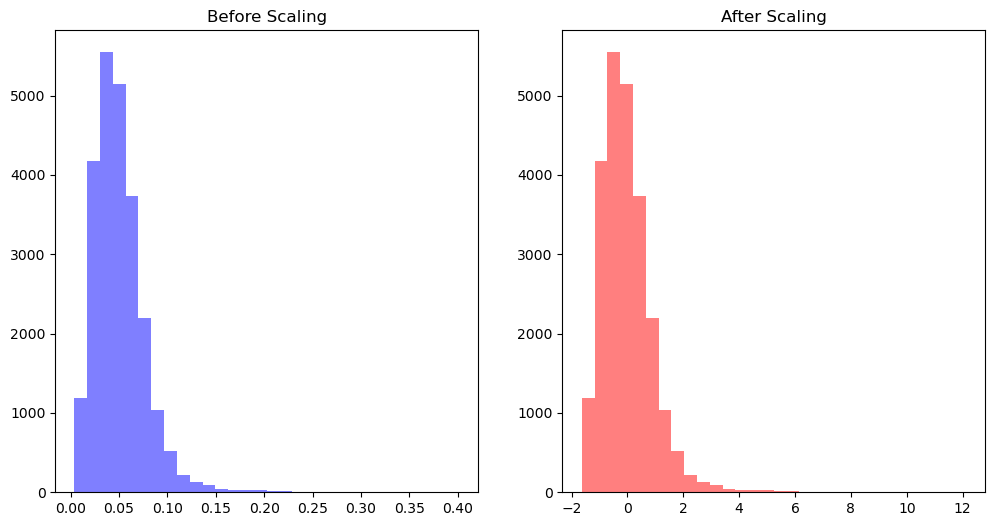

In [17]:
# standardize statistical node features
from sklearn.preprocessing import StandardScaler

# Concatenate all x values before scaling for the first feature, as a sanity check for standardization
x_before = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

scaler = StandardScaler()
scaler.fit(np.vstack([data.x.numpy() for data in X_train + X_val]))


# Transform the x values of the data in X_train
for data in X_train:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_val
for data in X_val:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_test
for data in X_test:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Concatenate all x values after scaling for the first feature, as a sanity check for standardization
x_after = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

# Plot the distribution of the first x feature before and after scaling as a sanity check
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(x_before, bins=30, color='b', alpha=0.5)
plt.title('Before Scaling')

plt.subplot(1, 2, 2)
plt.hist(x_after, bins=30, color='r', alpha=0.5)
plt.title('After Scaling')

plt.show()

### Model: Standard GCN

In [18]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
from pytorch_lightning.loggers import TensorBoardLogger
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = GCN(learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.MedianPruner(n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ec_results_stand_GCN_trials.pkl')

[I 2024-06-20 13:00:33,686] A new study created in memory with name: no-name-bf2fb71c-d3b5-4b20-a2eb-1ee10595f23a


Tested parameters: {'learning_rate': 0.0018730163524328387, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.43134889109683316}


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:03:42,425] Trial 0 finished with value: 0.2844116687774658 and parameters: {'learning_rate': 0.0018730163524328387, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.43134889109683316}. Best is trial 0 with value: 0.2844116687774658.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop

Tested parameters: {'learning_rate': 4.1162557195250554e-05, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.237915708899829}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 13:05:53,193] Trial 1 finished with value: 0.08007945865392685 and parameters: {'learning_rate': 4.1162557195250554e-05, 'optimizer': 'SGD', 'batch_size': 340, 'dropout': 0.237915708899829}. Best is trial 0 with value: 0.2844116687774658.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.007531465980477384, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.5032064007723158}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 13:08:33,332] Trial 2 finished with value: 0.29491856694221497 and parameters: {'learning_rate': 0.007531465980477384, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.5032064007723158}. Best is trial 2 with value: 0.29491856694221497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007452968192044523, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.1610807507670563}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 13:11:14,628] Trial 3 finished with value: 0.27352505922317505 and parameters: {'learning_rate': 0.007452968192044523, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.1610807507670563}. Best is trial 2 with value: 0.29491856694221497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0017138402748907002, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.48580757371683236}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 13:12:44,634] Trial 4 finished with value: 0.25791868567466736 and parameters: {'learning_rate': 0.0017138402748907002, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.48580757371683236}. Best is trial 2 with value: 0.29491856694221497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012426924687029979, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.5742196106799415}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 13:14:59,628] Trial 5 finished with value: 0.31705379486083984 and parameters: {'learning_rate': 0.012426924687029979, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.5742196106799415}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.2400087369913532e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.15816766321088516}


[I 2024-06-20 13:15:13,603] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007413671351436353, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.23128210284719117}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 13:19:42,080] Trial 7 finished with value: 0.27755412459373474 and parameters: {'learning_rate': 0.007413671351436353, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.23128210284719117}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003746847930165705, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.5770141648735632}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 13:22:23,733] Trial 8 finished with value: 0.2791432738304138 and parameters: {'learning_rate': 0.003746847930165705, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.5770141648735632}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013355065457288412, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.7960013184398336}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 13:24:42,331] Trial 9 finished with value: 0.2965874671936035 and parameters: {'learning_rate': 0.0013355065457288412, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.7960013184398336}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04207553979098247, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.672885231677175}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 13:26:59,882] Trial 10 finished with value: 0.28189048171043396 and parameters: {'learning_rate': 0.04207553979098247, 'optimizer': 'SGD', 'batch_size': 340, 'dropout': 0.672885231677175}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00022010634745439815, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.7858282748780226}


[I 2024-06-20 13:27:09,961] Trial 11 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09685961129898857, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.7442706108010988}


[I 2024-06-20 13:27:20,339] Trial 12 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00040094573547550324, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.6427283829274375}


[I 2024-06-20 13:27:30,537] Trial 13 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.024619685739311652, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.32256048479184946}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:30:38,932] Trial 14 finished with value: 0.3025553822517395 and parameters: {'learning_rate': 0.024619685739311652, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.32256048479184946}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.031639616324778005, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.31911700143818233}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:33:51,321] Trial 15 finished with value: 0.2912736237049103 and parameters: {'learning_rate': 0.031639616324778005, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.31911700143818233}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0191905172937375, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.033647579723661114}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:36:55,970] Trial 16 finished with value: 0.30213820934295654 and parameters: {'learning_rate': 0.0191905172937375, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.033647579723661114}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.080764774243864, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.37490926227670146}


[I 2024-06-20 13:37:03,526] Trial 17 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01706470551015034, 'optimizer_name': 'SGD', 'batch_size': 680, 'dropout': 0.5642207287322749}


[I 2024-06-20 13:37:10,642] Trial 18 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002570791927149035, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.33369360631074063}


[I 2024-06-20 13:37:18,050] Trial 19 pruned. Trial was pruned at epoch 103.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006266352109525395, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.022505755562225727}


[I 2024-06-20 13:37:28,130] Trial 20 pruned. Trial was pruned at epoch 129.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.018878802359305526, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.008947549334228855}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:40:38,012] Trial 21 finished with value: 0.28809839487075806 and parameters: {'learning_rate': 0.018878802359305526, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.008947549334228855}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01684887907146182, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.1004250218020234}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:43:42,368] Trial 22 finished with value: 0.28792381286621094 and parameters: {'learning_rate': 0.01684887907146182, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.1004250218020234}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0036017817182401567, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.2484097337737327}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:46:55,916] Trial 23 finished with value: 0.2806064784526825 and parameters: {'learning_rate': 0.0036017817182401567, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.2484097337737327}. Best is trial 5 with value: 0.31705379486083984.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.038907017293103086, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.4266623854186673}


[I 2024-06-20 13:47:02,791] Trial 24 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011080303542558333, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.6249376304075662}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 13:48:35,682] Trial 25 finished with value: 0.33018913865089417 and parameters: {'learning_rate': 0.011080303542558333, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.6249376304075662}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005783270206722894, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.6387188220687398}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 13:50:07,886] Trial 26 finished with value: 0.2912694811820984 and parameters: {'learning_rate': 0.005783270206722894, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.6387188220687398}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.949356751421159e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.5504985439655894}


[I 2024-06-20 13:50:21,558] Trial 27 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04987816605803182, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.7090586899436966}


[I 2024-06-20 13:50:34,594] Trial 28 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0035082395992241796, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.4992896284588052}


[I 2024-06-20 13:50:47,649] Trial 29 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012947239190656388, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.6042887020044853}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 13:53:03,433] Trial 30 finished with value: 0.2990013659000397 and parameters: {'learning_rate': 0.012947239190656388, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.6042887020044853}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.022822788678259657, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.07417879409990535}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:56:10,271] Trial 31 finished with value: 0.2800280451774597 and parameters: {'learning_rate': 0.022822788678259657, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.07417879409990535}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00993237413148356, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.45314313201140005}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 13:59:14,981] Trial 32 finished with value: 0.31079962849617004 and parameters: {'learning_rate': 0.00993237413148356, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.45314313201140005}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01064673565115268, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.45129054083478837}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 14:01:55,992] Trial 33 finished with value: 0.29636719822883606 and parameters: {'learning_rate': 0.01064673565115268, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.45129054083478837}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0034361546422375343, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.36275730474086376}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:05:07,312] Trial 34 finished with value: 0.2715519666671753 and parameters: {'learning_rate': 0.0034361546422375343, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.36275730474086376}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009016966480816563, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.5243994348806666}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:06:35,491] Trial 35 finished with value: 0.25959423184394836 and parameters: {'learning_rate': 0.0009016966480816563, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.5243994348806666}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022040922180798614, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.45367696832781723}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 14:09:18,684] Trial 36 finished with value: 0.3206602931022644 and parameters: {'learning_rate': 0.0022040922180798614, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.45367696832781723}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002364672722535381, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.46052947308090636}


[I 2024-06-20 14:09:26,592] Trial 37 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007411863272844462, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.4245793213985183}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 14:12:12,460] Trial 38 finished with value: 0.2890235185623169 and parameters: {'learning_rate': 0.007411863272844462, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.4245793213985183}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002042860760651253, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.6010358416675933}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 14:14:56,251] Trial 39 finished with value: 0.2751147150993347 and parameters: {'learning_rate': 0.002042860760651253, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.6010358416675933}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0978806805389772e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.5238002106508609}


[I 2024-06-20 14:15:04,010] Trial 40 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01064216838603275, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.2666298334182955}


[I 2024-06-20 14:19:13,602] Trial 41 pruned. Trial was pruned at epoch 3209.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005999251130536916, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.29604250416028866}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 14:21:36,237] Trial 42 finished with value: 0.2628942131996155 and parameters: {'learning_rate': 0.005999251130536916, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.29604250416028866}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02748027287748454, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.3798103191681694}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:23:02,949] Trial 43 finished with value: 0.2990173101425171 and parameters: {'learning_rate': 0.02748027287748454, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.3798103191681694}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05385931096408297, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.20361094038300342}


[I 2024-06-20 14:23:10,889] Trial 44 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011006566734278137, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.47678788841237507}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 14:25:21,989] Trial 45 finished with value: 0.28930044174194336 and parameters: {'learning_rate': 0.0011006566734278137, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.47678788841237507}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0052410452687843565, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.40469488593427844}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:28:29,851] Trial 46 finished with value: 0.2907414436340332 and parameters: {'learning_rate': 0.0052410452687843565, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.40469488593427844}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.06882588844681424, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.6683557354075726}


[I 2024-06-20 14:28:39,282] Trial 47 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010536578745085423, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5393476150019102}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:30:05,755] Trial 48 finished with value: 0.3212675154209137 and parameters: {'learning_rate': 0.010536578745085423, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.5393476150019102}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012384187981525286, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5350621185588466}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:31:39,827] Trial 49 finished with value: 0.2942717671394348 and parameters: {'learning_rate': 0.012384187981525286, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.5350621185588466}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002666155408525347, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5961020812115968}


[I 2024-06-20 14:31:52,728] Trial 50 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009022449989161255, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.4837715000315512}


[I 2024-06-20 14:32:05,579] Trial 51 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03031380843835172, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5667880122782302}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:33:32,862] Trial 52 finished with value: 0.2885170578956604 and parameters: {'learning_rate': 0.03031380843835172, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.5667880122782302}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014191370075679699, 'optimizer_name': 'SGD', 'batch_size': 680, 'dropout': 0.7241609422191757}


[I 2024-06-20 14:33:39,619] Trial 53 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005325821903367523, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.626586506573765}


[I 2024-06-20 14:37:49,319] Trial 54 pruned. Trial was pruned at epoch 3189.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014996142537184324, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.33768182878229}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 14:40:05,193] Trial 55 finished with value: 0.26164597272872925 and parameters: {'learning_rate': 0.0014996142537184324, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.33768182878229}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.024978784914956486, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.6766062840669527}


[I 2024-06-20 14:40:13,511] Trial 56 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03947173459163582, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.5096570835833442}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:43:20,453] Trial 57 finished with value: 0.2943758964538574 and parameters: {'learning_rate': 0.03947173459163582, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.5096570835833442}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008057259089519106, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.40032040727462337}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 14:44:50,086] Trial 58 finished with value: 0.29967156052589417 and parameters: {'learning_rate': 0.008057259089519106, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.40032040727462337}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.018616898160433496, 'optimizer_name': 'SGD', 'batch_size': 680, 'dropout': 0.436737593878259}


[I 2024-06-20 14:44:57,223] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005536515110844362, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.5493895433678186}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 14:47:10,394] Trial 60 finished with value: 0.29489508271217346 and parameters: {'learning_rate': 0.0005536515110844362, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.5493895433678186}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02034996015122023, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.1514228758488383}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:50:22,293] Trial 61 finished with value: 0.31066858768463135 and parameters: {'learning_rate': 0.02034996015122023, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.1514228758488383}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00447592287951544, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.1635879561234746}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:53:35,063] Trial 62 finished with value: 0.26994678378105164 and parameters: {'learning_rate': 0.00447592287951544, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.1635879561234746}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01463006717060384, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.18753797103793096}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 14:56:55,925] Trial 63 finished with value: 0.29372015595436096 and parameters: {'learning_rate': 0.01463006717060384, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.18753797103793096}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008140536781947937, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.10069930456147935}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 15:00:04,845] Trial 64 finished with value: 0.2950960099697113 and parameters: {'learning_rate': 0.008140536781947937, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.10069930456147935}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03362069277551451, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.583574203347123}


[I 2024-06-20 15:00:11,661] Trial 65 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.021513183061416825, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.47596700488013166}


[I 2024-06-20 15:00:19,447] Trial 66 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.051845781830705366, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.6254064840176613}


[I 2024-06-20 15:00:32,223] Trial 67 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002979547412082416, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.3065461172221798}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 15:03:38,985] Trial 68 finished with value: 0.29783594608306885 and parameters: {'learning_rate': 0.002979547412082416, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.3065461172221798}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.882138773999054e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.2794492512223721}


[I 2024-06-20 15:03:47,184] Trial 69 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010742209459469543, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.3547604518585674}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:05:13,289] Trial 70 finished with value: 0.31597697734832764 and parameters: {'learning_rate': 0.010742209459469543, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.3547604518585674}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010065228495310077, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.3416488653962744}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:06:42,053] Trial 71 finished with value: 0.2899225652217865 and parameters: {'learning_rate': 0.010065228495310077, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.3416488653962744}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.015756385413817502, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.3649059650563393}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:08:08,787] Trial 72 finished with value: 0.26820215582847595 and parameters: {'learning_rate': 0.015756385413817502, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.3649059650563393}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00689238322205249, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.45710036112080904}


[I 2024-06-20 15:08:22,096] Trial 73 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012024110133252986, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5042647471918241}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:09:48,748] Trial 74 finished with value: 0.3028985261917114 and parameters: {'learning_rate': 0.012024110133252986, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.5042647471918241}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004438563528300985, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5025127970414329}


[I 2024-06-20 15:10:01,643] Trial 75 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011615654400019371, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.42278838896216553}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:11:30,378] Trial 76 finished with value: 0.2933821976184845 and parameters: {'learning_rate': 0.011615654400019371, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.42278838896216553}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001730120243683802, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5531096869617442}


[I 2024-06-20 15:11:43,296] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.019466458581680467, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.5760144926023519}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:13:12,755] Trial 78 finished with value: 0.2661588490009308 and parameters: {'learning_rate': 0.019466458581680467, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.5760144926023519}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009644573182563163, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.531047066510291}


[I 2024-06-20 15:13:22,675] Trial 79 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00679383559809225, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6599585123725822}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:14:55,516] Trial 80 finished with value: 0.3223593533039093 and parameters: {'learning_rate': 0.00679383559809225, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.6599585123725822}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001902457889626387, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.7749849146045669}


[I 2024-06-20 15:15:08,404] Trial 81 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0064781481162319975, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6024346191912213}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:16:38,881] Trial 82 finished with value: 0.33014413714408875 and parameters: {'learning_rate': 0.0064781481162319975, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.6024346191912213}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006051139378618488, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6719771555520714}


[I 2024-06-20 15:16:54,184] Trial 83 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004296040656270598, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6433885485860279}


[I 2024-06-20 15:17:08,517] Trial 84 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007265752636480993, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.7037507562099747}


[I 2024-06-20 15:17:16,933] Trial 85 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002287032826726392, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6522810126875178}


[I 2024-06-20 15:17:31,379] Trial 86 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003332501745635446, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.6105977495122149}


[I 2024-06-20 15:17:41,783] Trial 87 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.015526886077120237, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.6923940930755508}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:19:13,718] Trial 88 finished with value: 0.32487809658050537 and parameters: {'learning_rate': 0.015526886077120237, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.6923940930755508}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014215643824228899, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.7545930163663859}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:20:41,684] Trial 89 finished with value: 0.25419169664382935 and parameters: {'learning_rate': 0.014215643824228899, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.7545930163663859}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006540411403225429, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.7110819584501541}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:22:09,098] Trial 90 finished with value: 0.27620336413383484 and parameters: {'learning_rate': 0.006540411403225429, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.7110819584501541}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009433301779244976, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.6212636547373771}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:23:38,918] Trial 91 finished with value: 0.28053539991378784 and parameters: {'learning_rate': 0.009433301779244976, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.6212636547373771}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.023831122567594974, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.6868545280011427}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:25:06,936] Trial 92 finished with value: 0.2757973074913025 and parameters: {'learning_rate': 0.023831122567594974, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.6868545280011427}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.015789000878971872, 'optimizer_name': 'Adam', 'batch_size': 850, 'dropout': 0.6600255520130331}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 15:29:41,739] Trial 93 finished with value: 0.2943700850009918 and parameters: {'learning_rate': 0.015789000878971872, 'optimizer': 'Adam', 'batch_size': 850, 'dropout': 0.6600255520130331}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011074307720704323, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.575707097058698}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 15:32:24,748] Trial 94 finished with value: 0.2964058518409729 and parameters: {'learning_rate': 0.011074307720704323, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.575707097058698}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00486456413003927, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.5940780545218496}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:33:53,618] Trial 95 finished with value: 0.3129228353500366 and parameters: {'learning_rate': 0.00486456413003927, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.5940780545218496}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0049294089731421265, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.5963638407302676}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:35:20,508] Trial 96 finished with value: 0.26855215430259705 and parameters: {'learning_rate': 0.0049294089731421265, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.5963638407302676}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004059340509741469, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.6362798737023078}


[I 2024-06-20 15:35:35,320] Trial 97 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011635870011243877, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.7355988518425449}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:37:03,767] Trial 98 finished with value: 0.30630648136138916 and parameters: {'learning_rate': 0.0011635870011243877, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.7355988518425449}. Best is trial 25 with value: 0.33018913865089417.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015853909285014295, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5470913697753534}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 15:38:33,960] Trial 99 finished with value: 0.29859790205955505 and parameters: {'learning_rate': 0.0015853909285014295, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.5470913697753534}. Best is trial 25 with value: 0.33018913865089417.


Best trial:
  Value: 0.33018913865089417
  Params: 
    learning_rate: 0.011080303542558333
    optimizer: RMSprop
    batch_size: 170
    dropout: 0.6249376304075662


In [19]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_25/checkpoints/epoch=77-train_loss=1.43-train_f1=0.29-val_loss=1.56-val_f1=0.36.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.011080303542558333, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.6249376304075662}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3594067692756653     │
│         val_loss          │    1.5624703168869019     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.43      0.44      0.44       108
     HEALTHY       0.37      0.58      0.45       108
         MDD       0.39      0.23      0.29       108
         OCD       0.29      0.22      0.25       108
         SMC       0.37      0.37      0.37       108

    accuracy                           0.37       540
   macro avg       0.37      0.37      0.36       540
weighted avg       0.37      0.37      0.36       540

F1-score: 0.35940676115516945


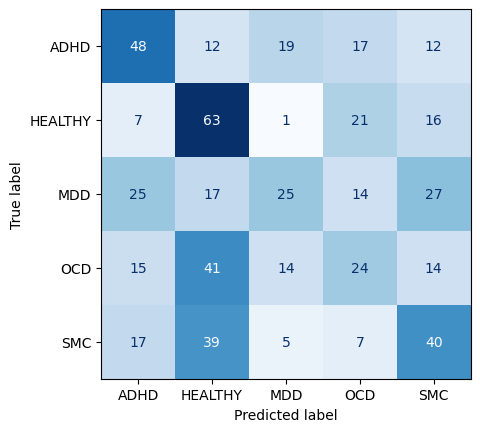

In [20]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
# Load the model directly from the checkpoint
model = GCN.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.32854071259498596    │
│         val_loss          │    1.4774813652038574     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.48      0.46      0.47        84
     HEALTHY       0.29      0.48      0.36        84
         MDD       0.25      0.18      0.21        84
         OCD       0.20      0.13      0.16        84
         SMC       0.44      0.45      0.44        96

    accuracy                           0.34       432
   macro avg       0.33      0.34      0.33       432
weighted avg       0.33      0.34      0.33       432

F1-score:
 0.3285406887478017


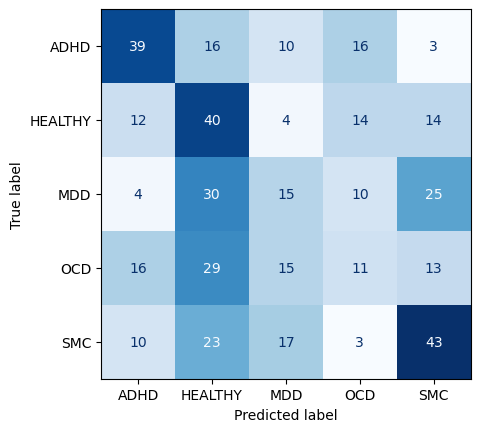

In [21]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [22]:
df_trials = pd.read_pickle('ec_results_stand_GCN_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
25,25,0.330189,2024-06-20 13:47:02.791868,2024-06-20 13:48:35.681510,0 days 00:01:32.889642,170,0.624938,0.011080,RMSprop,/home/tsmolders/lightning_logs/version_25/chec...,COMPLETE
82,82,0.330144,2024-06-20 15:15:08.405351,2024-06-20 15:16:38.880722,0 days 00:01:30.475371,170,0.602435,0.006478,SGD,/home/tsmolders/lightning_logs/version_82/chec...,COMPLETE
88,88,0.324878,2024-06-20 15:17:41.784119,2024-06-20 15:19:13.717208,0 days 00:01:31.933089,170,0.692394,0.015527,Adam,/home/tsmolders/lightning_logs/version_88/chec...,COMPLETE
80,80,0.322359,2024-06-20 15:13:22.677744,2024-06-20 15:14:55.515742,0 days 00:01:32.837998,170,0.659959,0.006794,SGD,/home/tsmolders/lightning_logs/version_80/chec...,COMPLETE
48,48,0.321268,2024-06-20 14:28:39.283552,2024-06-20 14:30:05.754285,0 days 00:01:26.470733,170,0.539348,0.010537,SGD,/home/tsmolders/lightning_logs/version_48/chec...,COMPLETE
36,36,0.320660,2024-06-20 14:06:35.493064,2024-06-20 14:09:18.683099,0 days 00:02:43.190035,510,0.453677,0.002204,RMSprop,/home/tsmolders/lightning_logs/version_36/chec...,COMPLETE
5,5,0.317054,2024-06-20 13:12:44.635130,2024-06-20 13:14:59.627048,0 days 00:02:14.991918,340,0.574220,0.012427,RMSprop,/home/tsmolders/lightning_logs/version_5/check...,COMPLETE
70,70,0.315977,2024-06-20 15:03:47.185984,2024-06-20 15:05:13.288835,0 days 00:01:26.102851,170,0.354760,0.010742,SGD,/home/tsmolders/lightning_logs/version_70/chec...,COMPLETE
95,95,0.312923,2024-06-20 15:32:24.750112,2024-06-20 15:33:53.617886,0 days 00:01:28.867774,170,0.594078,0.004865,RMSprop,/home/tsmolders/lightning_logs/version_95/chec...,COMPLETE
32,32,0.310800,2024-06-20 13:56:10.272174,2024-06-20 13:59:14.979191,0 days 00:03:04.707017,680,0.453143,0.009932,RMSprop,/home/tsmolders/lightning_logs/version_32/chec...,COMPLETE


#### Visualizations

In [23]:
# function to change axes size
def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

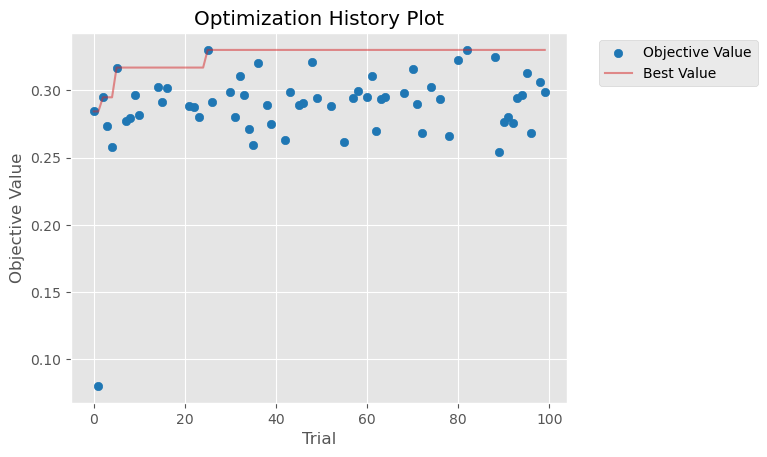

In [24]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-20 15:38:35,104] A new study created in memory with name: no-name-3c406b28-c4ab-414c-8b04-9b07332003c1
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


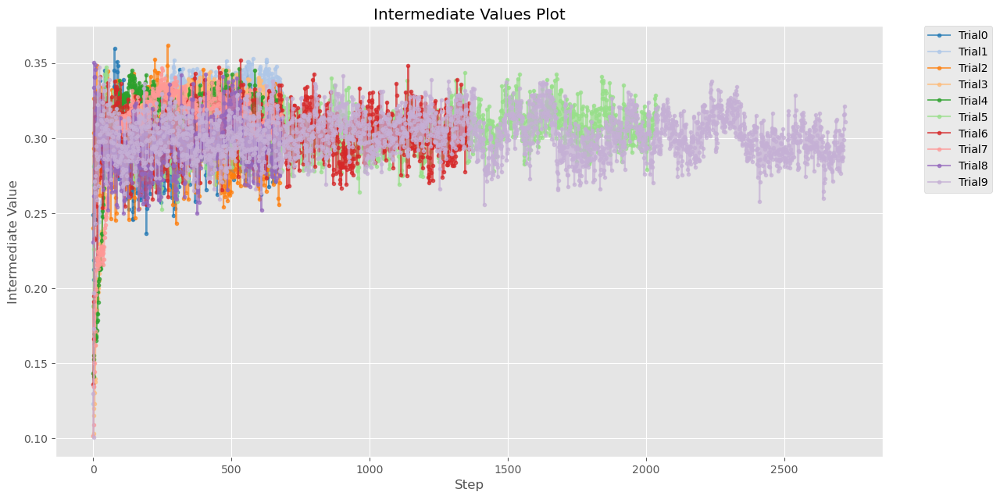

In [25]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


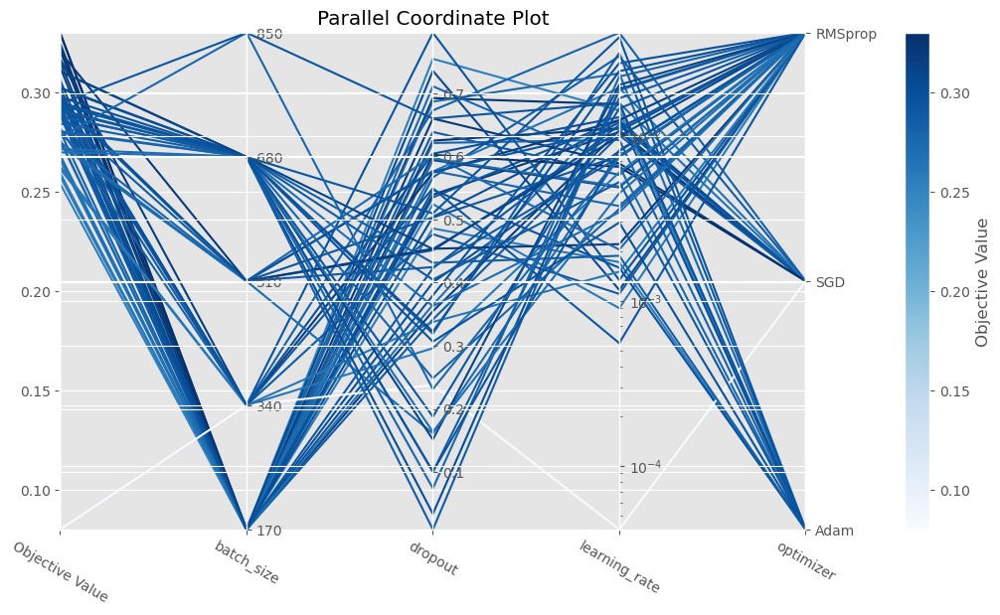

In [26]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-20 15:38:36,166] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


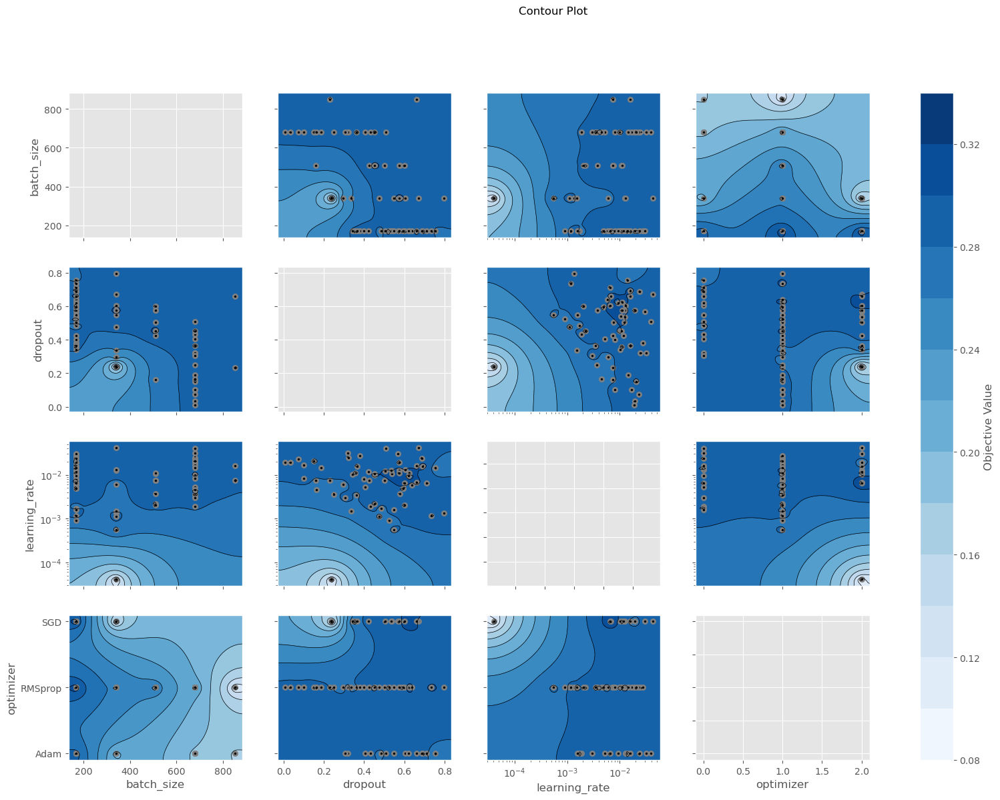

In [27]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='learning_rate'>,
       <Axes: xlabel='optimizer'>], dtype=object)

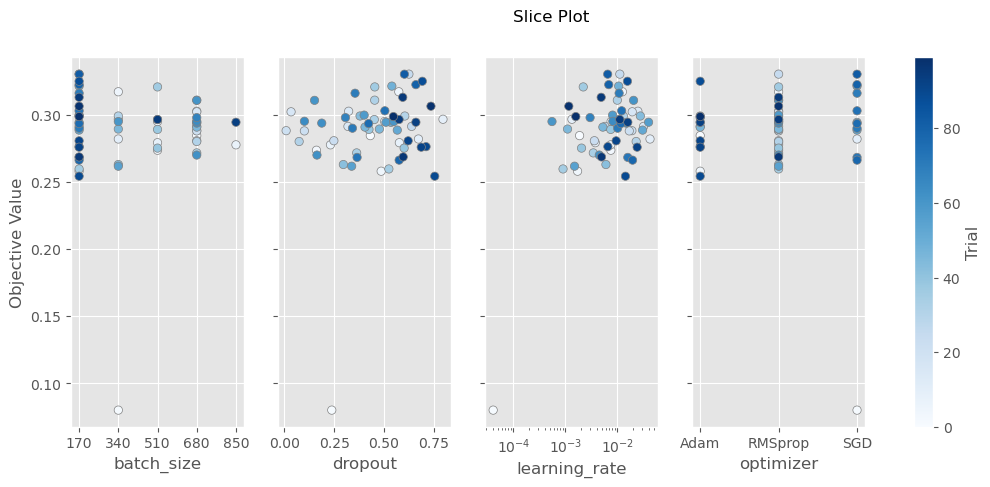

In [28]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

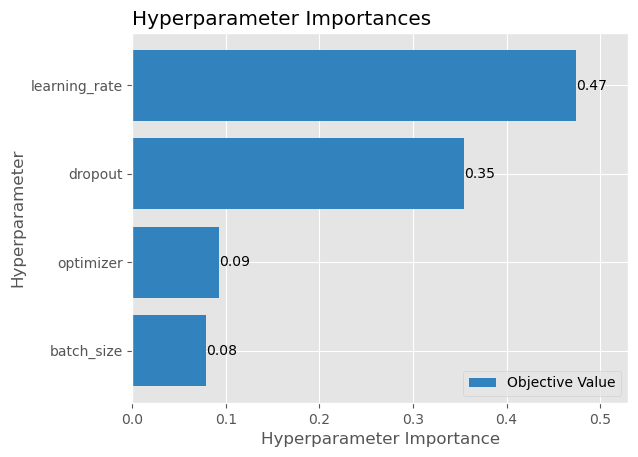

In [29]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

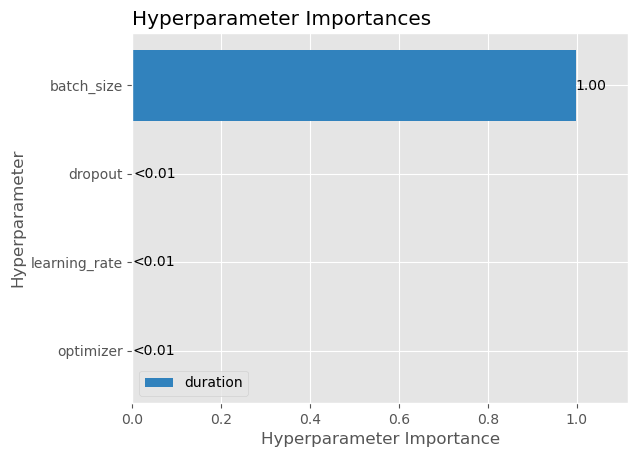

In [30]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

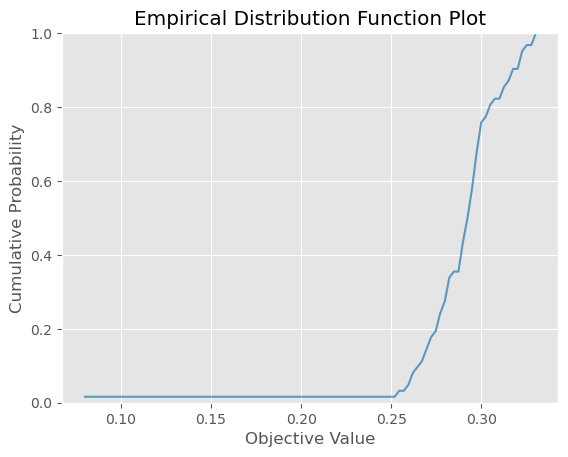

In [31]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-20 15:38:41,539] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


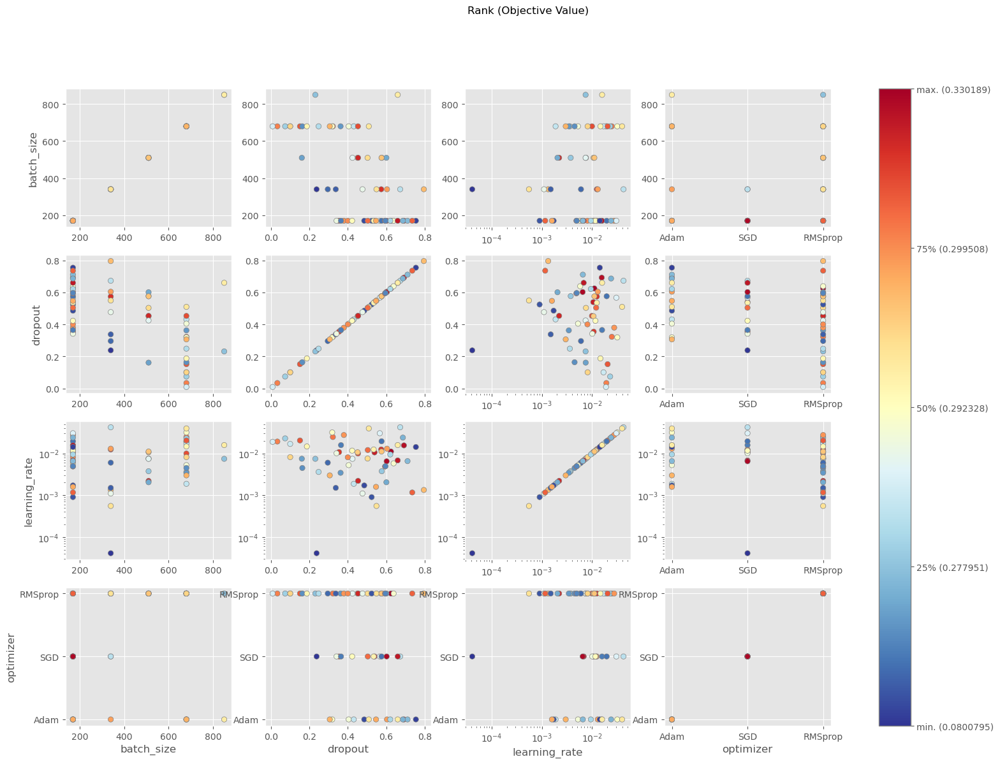

In [32]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


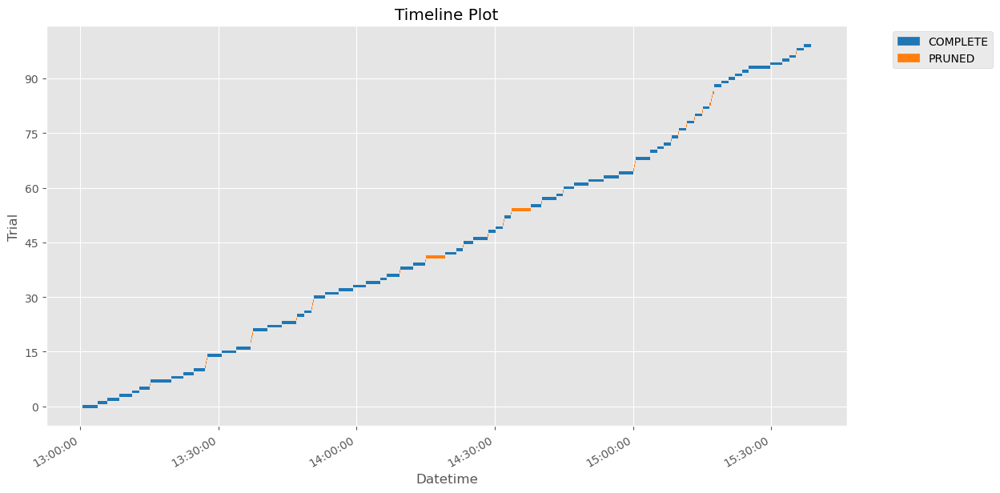

In [33]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda without edge_attr

In [34]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    # fc_layers = 1
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = graphLambda_wo_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)

    
    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ec_results_wo_edge_attrs_trials.pkl')

[I 2024-06-20 15:38:43,945] A new study created in memory with name: no-name-f2447b0e-196c-487f-aef9-8136085b44f9
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.008643901930755277, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.07312893320373447}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 15:42:58,303] Trial 0 finished with value: 0.3129173517227173 and parameters: {'learning_rate': 0.008643901930755277, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.07312893320373447}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010210246216493308, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.7993408532068381}


[I 2024-06-20 15:43:11,930] Trial 1 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.024023565338467907, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.4402981444227}


[I 2024-06-20 15:43:35,042] Trial 2 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0007270013496303015, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.5454574516639732}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 15:50:53,715] Trial 3 finished with value: 0.2657090425491333 and parameters: {'learning_rate': 0.0007270013496303015, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.5454574516639732}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00035635213882305694, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.4094621484890289}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 15:55:59,262] Trial 4 finished with value: 0.265358030796051 and parameters: {'learning_rate': 0.00035635213882305694, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.4094621484890289}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.134753794147902e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.7695017126200114}


[I 2024-06-20 15:57:12,875] Trial 5 pruned. Trial was pruned at epoch 601.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0016290178009570023, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.11852710415103661}


[I 2024-06-20 15:57:25,663] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.00048752415064985785, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.29491632877331025}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 16:01:02,555] Trial 7 finished with value: 0.2847422957420349 and parameters: {'learning_rate': 0.00048752415064985785, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.29491632877331025}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006088609360964036, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.04030916725784}


[I 2024-06-20 16:01:15,476] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010948752405282776, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.6042073992586419}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 16:05:38,415] Trial 9 finished with value: 0.2712617516517639 and parameters: {'learning_rate': 0.00010948752405282776, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.6042073992586419}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09579060202967123, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.15065461669423677}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 16:09:13,805] Trial 10 finished with value: 0.2917753756046295 and parameters: {'learning_rate': 0.09579060202967123, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.15065461669423677}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.06444290313778711, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.2089812162985714}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 16:12:52,545] Trial 11 finished with value: 0.29102814197540283 and parameters: {'learning_rate': 0.06444290313778711, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.2089812162985714}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01145683728074952, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.014380029464186421}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 16:16:27,980] Trial 12 finished with value: 0.27776041626930237 and parameters: {'learning_rate': 0.01145683728074952, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.014380029464186421}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006148057506869547, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.22031891260220637}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:21:37,200] Trial 13 finished with value: 0.30797603726387024 and parameters: {'learning_rate': 0.006148057506869547, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.22031891260220637}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004386873772524657, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.2828806542746196}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:26:51,251] Trial 14 finished with value: 0.2850891351699829 and parameters: {'learning_rate': 0.004386873772524657, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.2828806542746196}. Best is trial 0 with value: 0.3129173517227173.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005416928446013053, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.2908092544016819}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:31:56,087] Trial 15 finished with value: 0.32233041524887085 and parameters: {'learning_rate': 0.005416928446013053, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.2908092544016819}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002500988057566292, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.32303048792116174}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 16:34:30,550] Trial 16 finished with value: 0.29105180501937866 and parameters: {'learning_rate': 0.002500988057566292, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.32303048792116174}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01818983442446001, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.10878458231820413}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:39:38,667] Trial 17 finished with value: 0.2738339900970459 and parameters: {'learning_rate': 0.01818983442446001, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.10878458231820413}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.026146400803881413, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.4992711844372931}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:44:37,302] Trial 18 finished with value: 0.2768329977989197 and parameters: {'learning_rate': 0.026146400803881413, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.4992711844372931}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006660967088343764, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.3505434630194427}


[I 2024-06-20 16:44:50,143] Trial 19 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022712668954020772, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.20089058157912637}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 16:47:23,634] Trial 20 finished with value: 0.27685171365737915 and parameters: {'learning_rate': 0.0022712668954020772, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.20089058157912637}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008284908211402488, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.24137790786412894}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:52:24,165] Trial 21 finished with value: 0.24551904201507568 and parameters: {'learning_rate': 0.008284908211402488, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.24137790786412894}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00437664450645736, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09511317627898692}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 16:57:26,818] Trial 22 finished with value: 0.2734124958515167 and parameters: {'learning_rate': 0.00437664450645736, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09511317627898692}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014083579980351096, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.16337243361312823}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:02:37,153] Trial 23 finished with value: 0.26960936188697815 and parameters: {'learning_rate': 0.014083579980351096, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.16337243361312823}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04693584179948554, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.050165583287422266}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:07:36,437] Trial 24 finished with value: 0.3010762929916382 and parameters: {'learning_rate': 0.04693584179948554, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.050165583287422266}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015397982066560777, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.2525496538553649}


[I 2024-06-20 17:07:49,343] Trial 25 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004687181755280358, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.36387735986529723}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 17:12:13,980] Trial 26 finished with value: 0.2776309549808502 and parameters: {'learning_rate': 0.004687181755280358, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.36387735986529723}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.030711805873216882, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.2034247839895017}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:17:28,778] Trial 27 finished with value: 0.2700011730194092 and parameters: {'learning_rate': 0.030711805873216882, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.2034247839895017}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003339447134232427, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.06396496612316144}


[I 2024-06-20 17:17:41,891] Trial 28 pruned. Trial was pruned at epoch 104.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002541945477216562, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1588123134207967}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 17:22:08,123] Trial 29 finished with value: 0.2958798408508301 and parameters: {'learning_rate': 0.0002541945477216562, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1588123134207967}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001081320435544649, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.471965242948039}


[I 2024-06-20 17:22:21,671] Trial 30 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04872335975451031, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.01704209169472036}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:27:19,634] Trial 31 finished with value: 0.24496382474899292 and parameters: {'learning_rate': 0.04872335975451031, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.01704209169472036}. Best is trial 15 with value: 0.32233041524887085.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03621830143158203, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.06912449328672131}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:32:21,692] Trial 32 finished with value: 0.32971838116645813 and parameters: {'learning_rate': 0.03621830143158203, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.06912449328672131}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0091450105889123, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.09644419213788569}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 17:37:26,169] Trial 33 finished with value: 0.23147618770599365 and parameters: {'learning_rate': 0.0091450105889123, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.09644419213788569}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.017383893054012715, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.26337337694827856}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 17:40:06,774] Trial 34 finished with value: 0.2721046209335327 and parameters: {'learning_rate': 0.017383893054012715, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.26337337694827856}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03660594722411987, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.41305552291651204}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 17:47:11,211] Trial 35 finished with value: 0.26748520135879517 and parameters: {'learning_rate': 0.03660594722411987, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.41305552291651204}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0067904710858035025, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.13302484825690977}


[I 2024-06-20 17:47:22,364] Trial 36 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.020558751171708165, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.6107316208910972}


[I 2024-06-20 17:47:33,643] Trial 37 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.2859561515165946e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.07622944640121705}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 17:54:41,218] Trial 38 finished with value: 0.15833121538162231 and parameters: {'learning_rate': 3.2859561515165946e-05, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.07622944640121705}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012519189715541913, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.31871396110054834}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 17:59:10,214] Trial 39 finished with value: 0.3158125877380371 and parameters: {'learning_rate': 0.0012519189715541913, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.31871396110054834}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012474633491271812, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.3783394889046448}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:03:41,668] Trial 40 finished with value: 0.2982543408870697 and parameters: {'learning_rate': 0.0012474633491271812, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.3783394889046448}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00020153524172370475, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.30992451168980606}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:08:08,439] Trial 41 finished with value: 0.29708194732666016 and parameters: {'learning_rate': 0.00020153524172370475, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.30992451168980606}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002102755820049056, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.21333409566471864}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:12:36,994] Trial 42 finished with value: 0.3134723901748657 and parameters: {'learning_rate': 0.002102755820049056, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.21333409566471864}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002115363917032241, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.4173042568533907}


[I 2024-06-20 18:12:50,756] Trial 43 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006438303151212215, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.33870398499170334}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:17:23,759] Trial 44 finished with value: 0.2748621106147766 and parameters: {'learning_rate': 0.0006438303151212215, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.33870398499170334}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009312528384751408, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.18106960622630996}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:21:57,039] Trial 45 finished with value: 0.2943974733352661 and parameters: {'learning_rate': 0.0009312528384751408, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.18106960622630996}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.07533812692486695, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.28634316083261346}


[I 2024-06-20 18:22:11,350] Trial 46 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00040800272460298073, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.7784230985654621}


[I 2024-06-20 18:22:31,345] Trial 47 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0035791813013808763, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.005695514761442075}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:27:02,565] Trial 48 finished with value: 0.22691775858402252 and parameters: {'learning_rate': 0.0035791813013808763, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.005695514761442075}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002624367388181756, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.698201980410776}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:31:22,739] Trial 49 finished with value: 0.23369944095611572 and parameters: {'learning_rate': 0.002624367388181756, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.698201980410776}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012524153981254114, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.13393029012858576}


[I 2024-06-20 18:31:45,933] Trial 50 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006582213714661786, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.22945785435237193}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 18:36:48,842] Trial 51 finished with value: 0.27735698223114014 and parameters: {'learning_rate': 0.006582213714661786, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.22945785435237193}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001552465397780637, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2284612704438706}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:41:18,949] Trial 52 finished with value: 0.3150799572467804 and parameters: {'learning_rate': 0.001552465397780637, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2284612704438706}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008168428162237909, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.27401532053397815}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:45:49,791] Trial 53 finished with value: 0.23787440359592438 and parameters: {'learning_rate': 0.0008168428162237909, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.27401532053397815}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0016625482062131308, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.19229193352806218}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:50:20,135] Trial 54 finished with value: 0.3246500492095947 and parameters: {'learning_rate': 0.0016625482062131308, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.19229193352806218}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0018014214382688926, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1790414003336133}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:54:45,004] Trial 55 finished with value: 0.28080689907073975 and parameters: {'learning_rate': 0.0018014214382688926, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1790414003336133}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005274115803439489, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.32444993909160874}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 18:59:10,506] Trial 56 finished with value: 0.32041117548942566 and parameters: {'learning_rate': 0.0005274115803439489, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.32444993909160874}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00031184401357020077, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.32770419736088846}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 19:02:47,451] Trial 57 finished with value: 0.2031908929347992 and parameters: {'learning_rate': 0.00031184401357020077, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.32770419736088846}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00013610999404273426, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.2992601990126218}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:07:13,777] Trial 58 finished with value: 0.19626131653785706 and parameters: {'learning_rate': 0.00013610999404273426, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.2992601990126218}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000488588185247766, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3903861319655342}


[I 2024-06-20 19:09:07,779] Trial 59 pruned. Trial was pruned at epoch 887.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001396097647239566, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.4506493875636345}


[I 2024-06-20 19:09:20,512] Trial 60 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007844958325884468, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2545811649059705}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:13:51,105] Trial 61 finished with value: 0.3049995005130768 and parameters: {'learning_rate': 0.0007844958325884468, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2545811649059705}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003042626478175037, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21832988323855346}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:18:24,359] Trial 62 finished with value: 0.3010294735431671 and parameters: {'learning_rate': 0.003042626478175037, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21832988323855346}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005797802550444219, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3476650135544107}


[I 2024-06-20 19:18:37,293] Trial 63 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0016264190350632624, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.23692953922342708}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:23:08,418] Trial 64 finished with value: 0.21590495109558105 and parameters: {'learning_rate': 0.0016264190350632624, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.23692953922342708}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0010878270412718303, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3166155254925599}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:27:31,987] Trial 65 finished with value: 0.29703253507614136 and parameters: {'learning_rate': 0.0010878270412718303, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3166155254925599}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004261767183097077, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.19448876937225038}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 19:30:08,256] Trial 66 finished with value: 0.27232474088668823 and parameters: {'learning_rate': 0.004261767183097077, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.19448876937225038}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0020923271530934786, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.27902554523236767}


[I 2024-06-20 19:30:24,943] Trial 67 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000401889109599158, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.13837347218801252}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:34:51,928] Trial 68 finished with value: 0.30928534269332886 and parameters: {'learning_rate': 0.000401889109599158, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.13837347218801252}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.177059711734602e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.1685366726081726}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 19:40:01,526] Trial 69 finished with value: 0.2754005789756775 and parameters: {'learning_rate': 4.177059711734602e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.1685366726081726}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00020866935803011554, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.36712538006132545}


[I 2024-06-20 19:40:40,332] Trial 70 pruned. Trial was pruned at epoch 268.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00273935659342799, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.1061255419169653}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:45:07,133] Trial 71 finished with value: 0.290942907333374 and parameters: {'learning_rate': 0.00273935659342799, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.1061255419169653}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005106931434090738, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.05759781257706148}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:49:30,249] Trial 72 finished with value: 0.2938302755355835 and parameters: {'learning_rate': 0.005106931434090738, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.05759781257706148}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009200453391061937, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.034408618209191666}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 19:53:57,961] Trial 73 finished with value: 0.2903263568878174 and parameters: {'learning_rate': 0.009200453391061937, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.034408618209191666}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013874798640551007, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.20873062388681762}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 19:59:11,480] Trial 74 finished with value: 0.3052396774291992 and parameters: {'learning_rate': 0.0013874798640551007, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.20873062388681762}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0037570327547354026, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.08095222525671758}


[I 2024-06-20 19:59:24,508] Trial 75 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005446207367697008, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.2657698509689408}


[I 2024-06-20 19:59:36,899] Trial 76 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.015555231306492818, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.03211416695905153}


[I 2024-06-20 19:59:47,758] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009908247917705165, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2992256150398264}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:04:15,196] Trial 78 finished with value: 0.262076735496521 and parameters: {'learning_rate': 0.0009908247917705165, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2992256150398264}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0018628431323928188, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.15204611746538688}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 20:06:52,700] Trial 79 finished with value: 0.2990526854991913 and parameters: {'learning_rate': 0.0018628431323928188, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.15204611746538688}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008403041458455735, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.24273934667231856}


[I 2024-06-20 20:07:06,306] Trial 80 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003903906544266839, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.12069063054630115}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:11:33,440] Trial 81 finished with value: 0.28758707642555237 and parameters: {'learning_rate': 0.0003903906544266839, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.12069063054630115}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000690879473310889, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.12389944923399437}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:16:01,212] Trial 82 finished with value: 0.32614442706108093 and parameters: {'learning_rate': 0.000690879473310889, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.12389944923399437}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005416855862526521, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1921805115885264}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:20:30,988] Trial 83 finished with value: 0.28199517726898193 and parameters: {'learning_rate': 0.0005416855862526521, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.1921805115885264}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007066140133868218, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.07649540211413688}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:24:59,365] Trial 84 finished with value: 0.27191004157066345 and parameters: {'learning_rate': 0.0007066140133868218, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.07649540211413688}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0268424339429066, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.12479162787849055}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 20:29:58,926] Trial 85 finished with value: 0.29298871755599976 and parameters: {'learning_rate': 0.0268424339429066, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.12479162787849055}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011630359979864526, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.09455117436233423}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:34:28,636] Trial 86 finished with value: 0.2788863778114319 and parameters: {'learning_rate': 0.0011630359979864526, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.09455117436233423}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008638375829093044, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.22599882402659288}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 20:38:04,677] Trial 87 finished with value: 0.270976722240448 and parameters: {'learning_rate': 0.0008638375829093044, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.22599882402659288}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022974313122140952, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.17486151837757663}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:42:29,374] Trial 88 finished with value: 0.29426878690719604 and parameters: {'learning_rate': 0.0022974313122140952, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.17486151837757663}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08162203894238135, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.3279046636820305}


[I 2024-06-20 20:42:40,458] Trial 89 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04341717130878672, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.14334874578987827}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:47:00,300] Trial 90 finished with value: 0.2968384325504303 and parameters: {'learning_rate': 0.04341717130878672, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.14334874578987827}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00028403555089091153, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.15951738689597714}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:51:35,019] Trial 91 finished with value: 0.24189060926437378 and parameters: {'learning_rate': 0.00028403555089091153, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.15951738689597714}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003534884869443731, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.11338038884645461}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 20:56:00,995] Trial 92 finished with value: 0.2697199583053589 and parameters: {'learning_rate': 0.0003534884869443731, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.11338038884645461}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00044112928412889897, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.05059090457946408}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 21:00:41,206] Trial 93 finished with value: 0.3251130282878876 and parameters: {'learning_rate': 0.00044112928412889897, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.05059090457946408}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006458781870047102, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.045068928178881806}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 21:05:13,116] Trial 94 finished with value: 0.3138642907142639 and parameters: {'learning_rate': 0.0006458781870047102, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.045068928178881806}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006010667503088124, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.04684843320308685}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 21:09:39,521] Trial 95 finished with value: 0.31235677003860474 and parameters: {'learning_rate': 0.0006010667503088124, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.04684843320308685}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00046165471847053717, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.020421453659238743}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 21:14:15,660] Trial 96 finished with value: 0.23183885216712952 and parameters: {'learning_rate': 0.00046165471847053717, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.020421453659238743}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012585318735408644, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.257468994883164}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 21:21:14,107] Trial 97 finished with value: 0.3010093867778778 and parameters: {'learning_rate': 0.0012585318735408644, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.257468994883164}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00014887348142903097, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.06885894756281474}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-20 21:25:48,082] Trial 98 finished with value: 0.13591492176055908 and parameters: {'learning_rate': 0.00014887348142903097, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.06885894756281474}. Best is trial 32 with value: 0.32971838116645813.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007279019099642993, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09108182952219486}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 21:30:58,181] Trial 99 finished with value: 0.30048835277557373 and parameters: {'learning_rate': 0.0007279019099642993, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09108182952219486}. Best is trial 32 with value: 0.32971838116645813.


Best trial:
  Value: 0.32971838116645813
  Params: 
    learning_rate: 0.03621830143158203
    optimizer: SGD
    batch_size: 680
    fc_layers: 6
    dropout: 0.06912449328672131


In [35]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_132/checkpoints/epoch=2329-train_loss=0.11-train_f1=0.95-val_loss=5.05-val_f1=0.34.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.03621830143158203, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.06912449328672131}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │     0.335899293422699     │
│         val_loss          │     5.048640727996826     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.41      0.39      0.40       108
     HEALTHY       0.36      0.44      0.39       108
         MDD       0.34      0.31      0.33       108
         OCD       0.26      0.28      0.27       108
         SMC       0.31      0.27      0.29       108

    accuracy                           0.34       540
   macro avg       0.34      0.34      0.34       540
weighted avg       0.34      0.34      0.34       540

F1-score: 0.3358993140021656


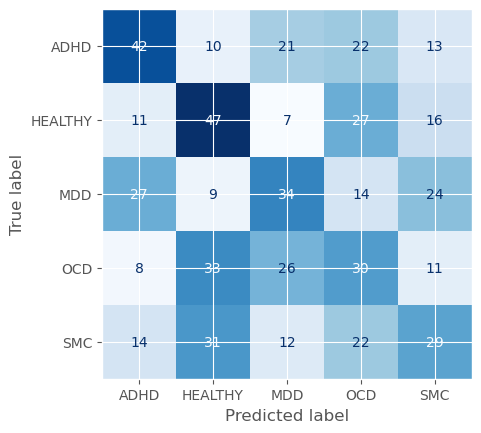

In [36]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_wo_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3096122443675995     │
│         val_loss          │    5.0563483238220215     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.43      0.35      0.38        84
     HEALTHY       0.29      0.30      0.29        84
         MDD       0.20      0.20      0.20        84
         OCD       0.26      0.29      0.27        84
         SMC       0.39      0.41      0.40        96

    accuracy                           0.31       432
   macro avg       0.31      0.31      0.31       432
weighted avg       0.32      0.31      0.31       432

F1-score:
 0.30961226063352243


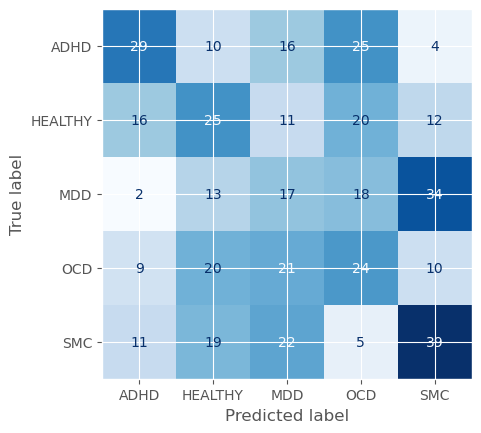

In [37]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [38]:
df_trials = pd.read_pickle('ec_results_wo_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
32,32,0.329718,2024-06-20 17:27:19.635306,2024-06-20 17:32:21.689587,0 days 00:05:02.054281,680,0.069124,6,0.036218,SGD,/home/tsmolders/lightning_logs/version_132/che...,COMPLETE
82,82,0.326144,2024-06-20 20:11:33.441611,2024-06-20 20:16:01.209606,0 days 00:04:27.767995,510,0.123899,5,0.000691,SGD,/home/tsmolders/lightning_logs/version_182/che...,COMPLETE
93,93,0.325113,2024-06-20 20:56:00.996226,2024-06-20 21:00:41.203677,0 days 00:04:40.207451,510,0.050591,5,0.000441,SGD,/home/tsmolders/lightning_logs/version_193/che...,COMPLETE
54,54,0.324650,2024-06-20 18:45:49.791617,2024-06-20 18:50:20.132832,0 days 00:04:30.341215,510,0.192292,5,0.001663,SGD,/home/tsmolders/lightning_logs/version_154/che...,COMPLETE
15,15,0.322330,2024-06-20 16:26:51.252626,2024-06-20 16:31:56.084438,0 days 00:05:04.831812,680,0.290809,5,0.005417,SGD,/home/tsmolders/lightning_logs/version_115/che...,COMPLETE
56,56,0.320411,2024-06-20 18:54:45.005291,2024-06-20 18:59:10.503639,0 days 00:04:25.498348,510,0.324450,5,0.000527,SGD,/home/tsmolders/lightning_logs/version_156/che...,COMPLETE
39,39,0.315813,2024-06-20 17:54:41.218980,2024-06-20 17:59:10.211511,0 days 00:04:28.992531,510,0.318714,8,0.001252,Adam,/home/tsmolders/lightning_logs/version_139/che...,COMPLETE
52,52,0.315080,2024-06-20 18:36:48.843209,2024-06-20 18:41:18.947202,0 days 00:04:30.103993,510,0.228461,5,0.001552,SGD,/home/tsmolders/lightning_logs/version_152/che...,COMPLETE
94,94,0.313864,2024-06-20 21:00:41.207505,2024-06-20 21:05:13.113839,0 days 00:04:31.906334,510,0.045069,5,0.000646,SGD,/home/tsmolders/lightning_logs/version_194/che...,COMPLETE
42,42,0.313472,2024-06-20 18:08:08.439860,2024-06-20 18:12:36.992129,0 days 00:04:28.552269,510,0.213334,7,0.002103,Adam,/home/tsmolders/lightning_logs/version_142/che...,COMPLETE


#### Visualizations

In [39]:
# function to change axes size
def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

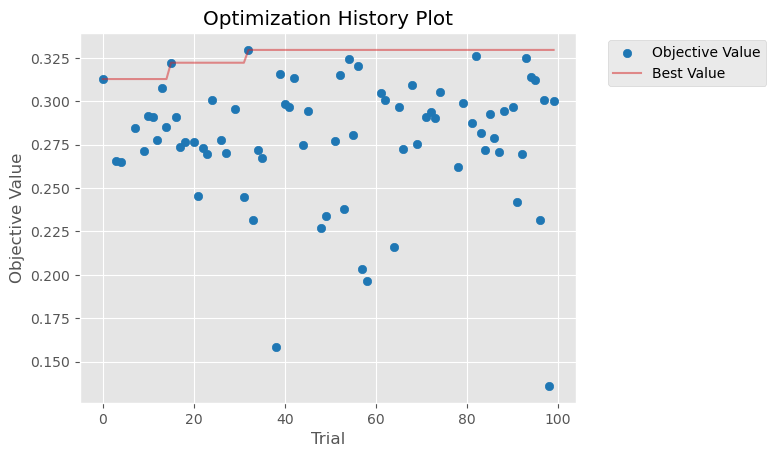

In [40]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-20 21:30:59,194] A new study created in memory with name: no-name-23f5762d-2b90-4b2d-8e52-caa30ed3fa40
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


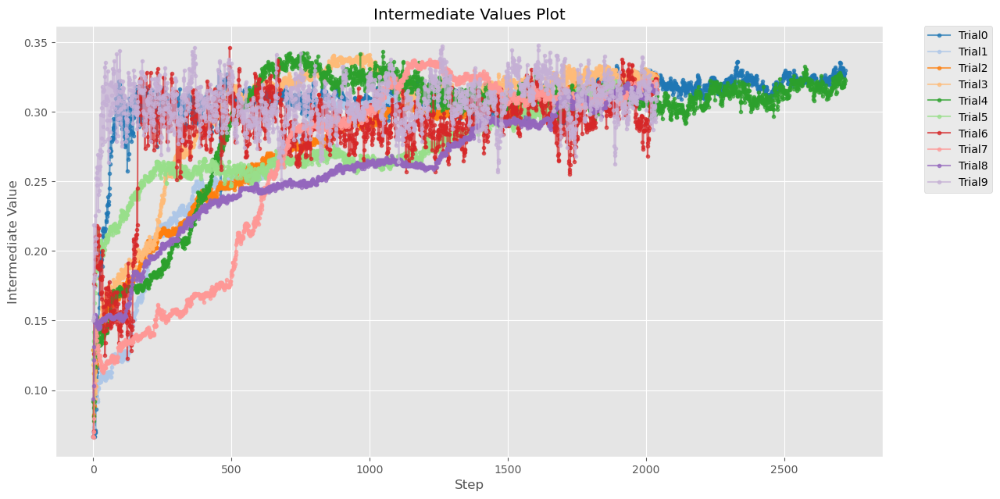

In [41]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


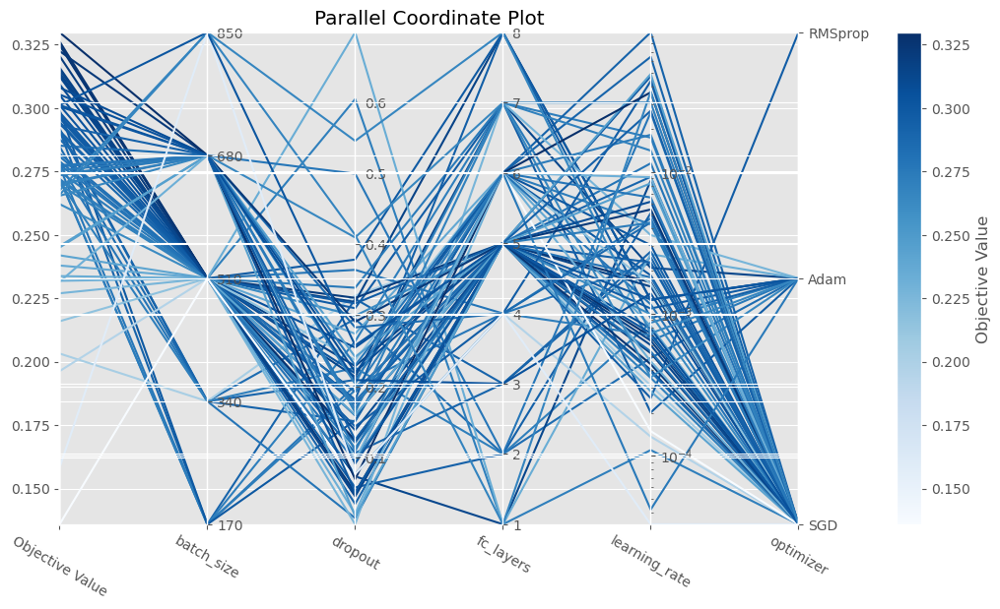

In [42]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-20 21:31:00,385] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


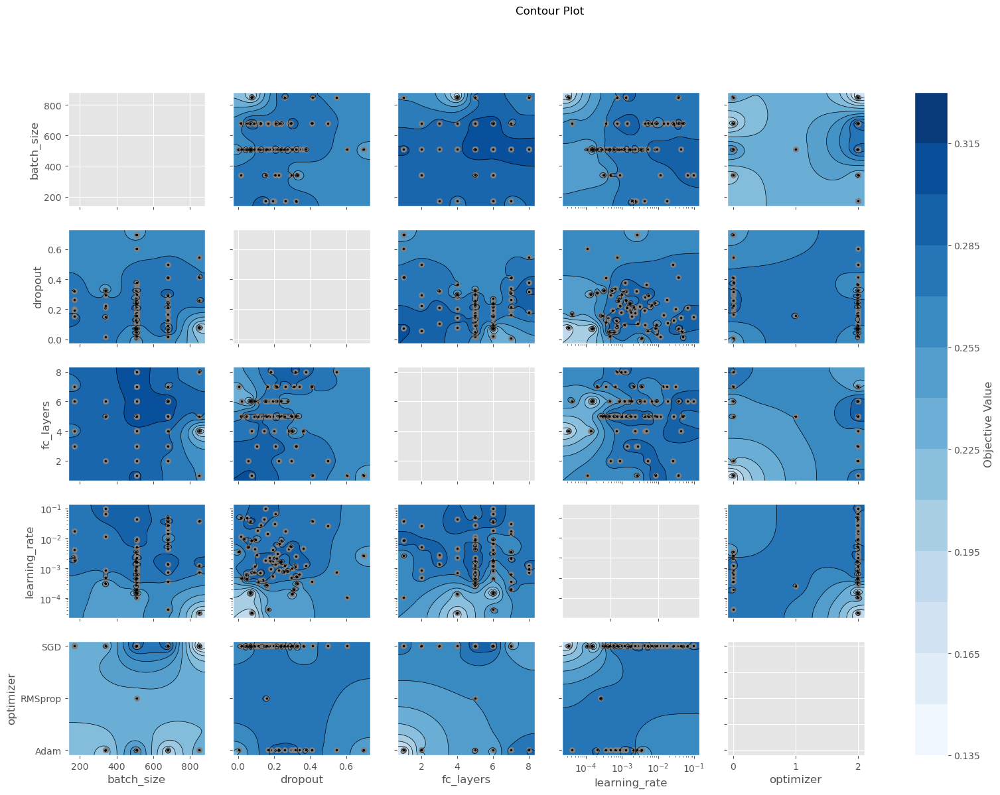

In [43]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

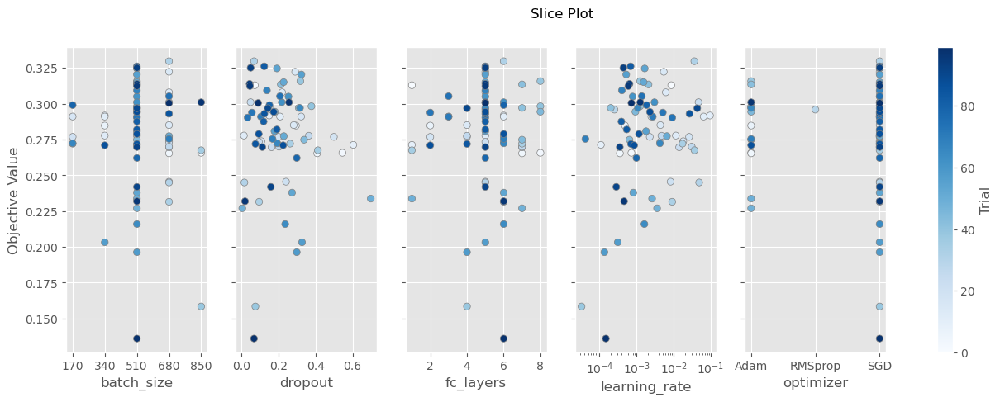

In [44]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

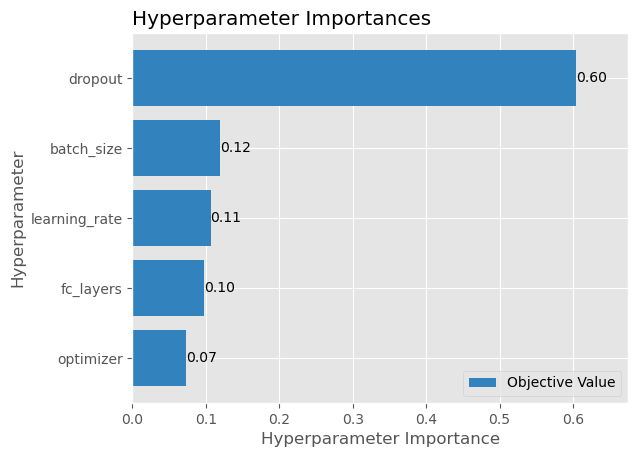

In [45]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

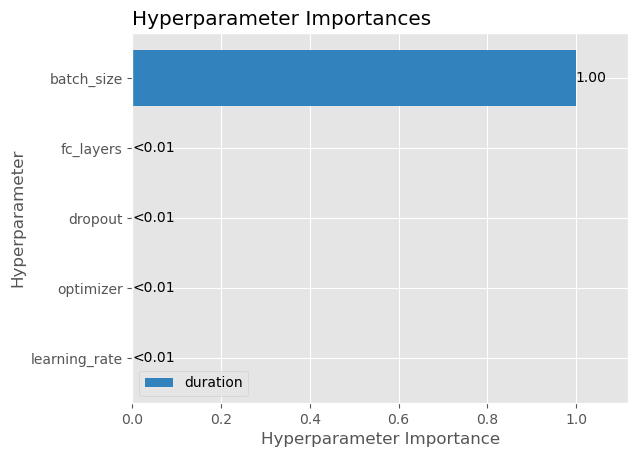

In [46]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

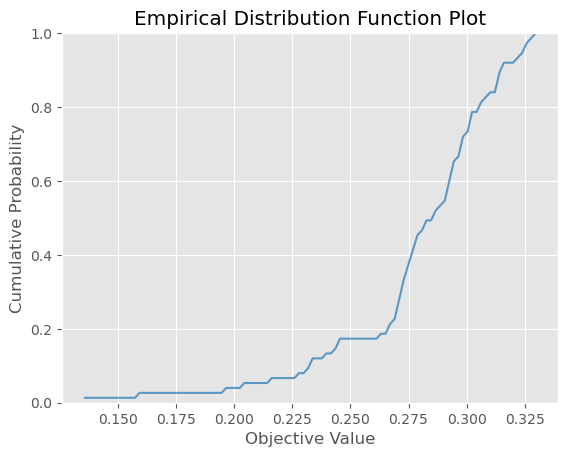

In [47]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-20 21:31:08,322] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


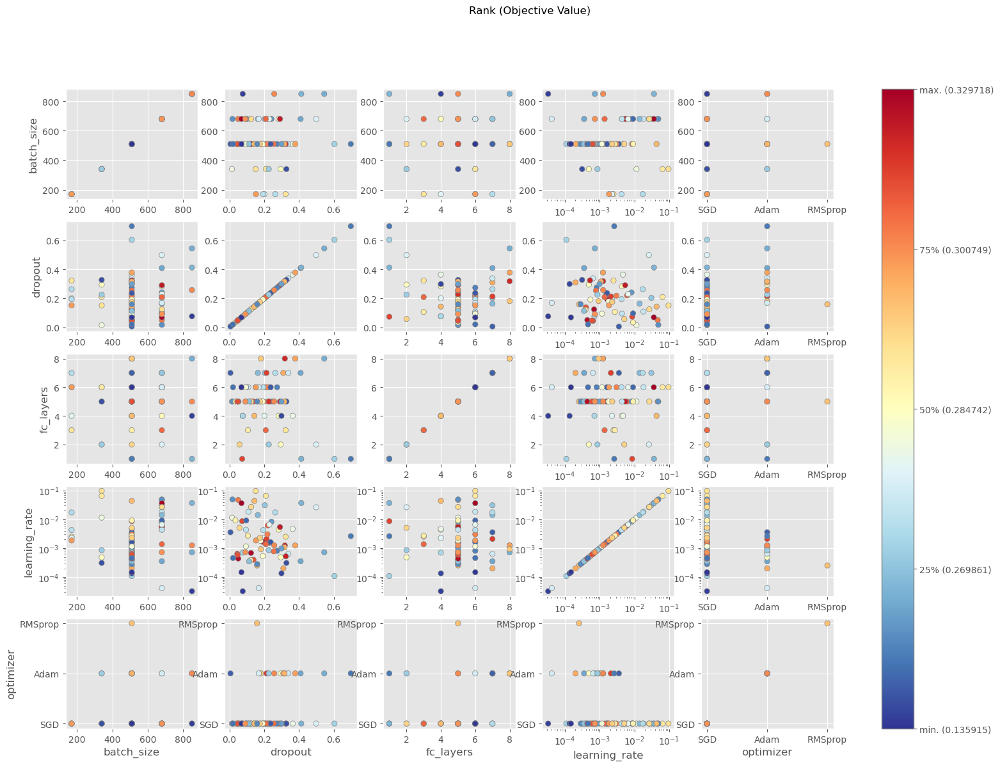

In [48]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


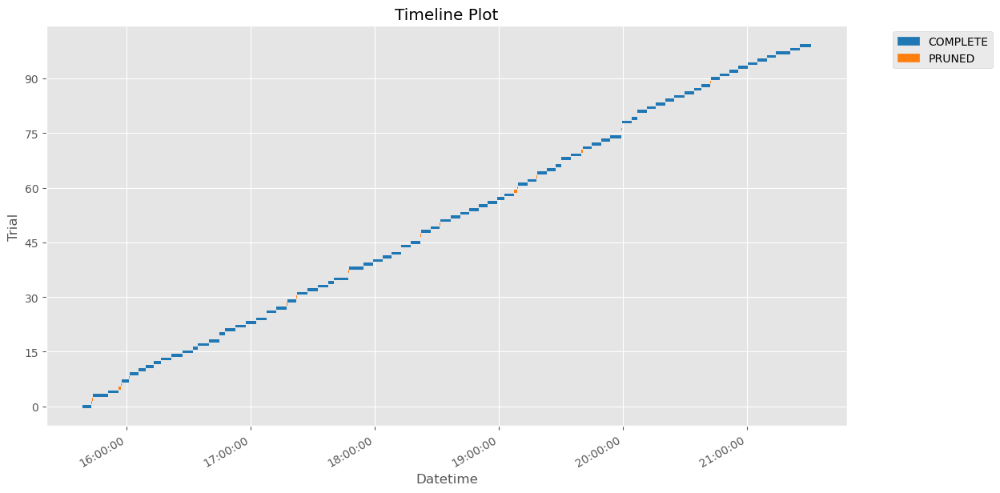

In [49]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda with edge_attr

In [50]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    # fc_layers = 1
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size


    # Create the model
    model = graphLambda_w_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)

    
    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ec_results_w_edge_attrs_trials.pkl')

[I 2024-06-20 21:31:12,438] A new study created in memory with name: no-name-40d41311-1d74-47d0-9cd3-6d8c3b1956f5
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.011100200029634872, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.7902770121716334}


[I 2024-06-20 21:31:29,069] Trial 0 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.00028398715416285363, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.26636887472794085}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 21:40:03,734] Trial 1 finished with value: 0.28198501467704773 and parameters: {'learning_rate': 0.00028398715416285363, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.26636887472794085}. Best is trial 1 with value: 0.28198501467704773.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.022720569826901668, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.10962465002289462}


[I 2024-06-20 21:40:22,980] Trial 2 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.07207217432116515, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.3769299261156305}


[I 2024-06-20 21:40:36,735] Trial 3 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.026083049731547903, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.2071128689010811}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 21:46:47,609] Trial 4 finished with value: 0.2396259754896164 and parameters: {'learning_rate': 0.026083049731547903, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.2071128689010811}. Best is trial 1 with value: 0.28198501467704773.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005926462415723823, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.6500104430285192}


[I 2024-06-20 21:47:03,385] Trial 5 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00031872576489639303, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.768590778510604}


[I 2024-06-20 21:47:19,430] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011705915826357848, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.014999935769007778}


[I 2024-06-20 21:47:38,118] Trial 7 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014412308031477757, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.5642813532149428}


[I 2024-06-20 21:47:53,687] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03425931185328524, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.08323706662933805}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 21:54:05,510] Trial 9 finished with value: 0.29170942306518555 and parameters: {'learning_rate': 0.03425931185328524, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.08323706662933805}. Best is trial 9 with value: 0.29170942306518555.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 1.1223991113007483e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.0029091358983194815}


[I 2024-06-20 21:54:32,276] Trial 10 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.130292964873586e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.2833308333048388}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 22:03:06,726] Trial 11 finished with value: 0.27344560623168945 and parameters: {'learning_rate': 9.130292964873586e-05, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.2833308333048388}. Best is trial 9 with value: 0.29170942306518555.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0025227099076336945, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.20381901262390556}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 22:11:46,695] Trial 12 finished with value: 0.3143903613090515 and parameters: {'learning_rate': 0.0025227099076336945, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.20381901262390556}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0027298581326090695, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.15827896337430689}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 22:17:50,206] Trial 13 finished with value: 0.2883596420288086 and parameters: {'learning_rate': 0.0027298581326090695, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.15827896337430689}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0035581714763986442, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3715513595293056}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 22:20:44,939] Trial 14 finished with value: 0.2970605194568634 and parameters: {'learning_rate': 0.0035581714763986442, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3715513595293056}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003161079221435483, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.43924980494755156}


[I 2024-06-20 22:21:11,273] Trial 15 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003836647714015743, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3920202002308059}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 22:24:01,401] Trial 16 finished with value: 0.29065507650375366 and parameters: {'learning_rate': 0.003836647714015743, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3920202002308059}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.441401291240255e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.5058014413979014}


[I 2024-06-20 22:24:26,009] Trial 17 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006769759862849791, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.3105963192431582}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 22:33:07,346] Trial 18 finished with value: 0.2619272768497467 and parameters: {'learning_rate': 0.006769759862849791, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.3105963192431582}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012230508936340206, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.21668203417858176}


[I 2024-06-20 22:33:37,491] Trial 19 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00013293241287431915, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.4940580508797374}


[I 2024-06-20 22:34:23,572] Trial 20 pruned. Trial was pruned at epoch 269.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.036494181158368805, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.11656078458736596}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 22:40:29,715] Trial 21 finished with value: 0.28704461455345154 and parameters: {'learning_rate': 0.036494181158368805, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.11656078458736596}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005956800468859536, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.06729097740531345}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-20 22:46:39,376] Trial 22 finished with value: 0.23546336591243744 and parameters: {'learning_rate': 0.005956800468859536, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.06729097740531345}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08361375814725734, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.34503097204979777}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-20 22:51:02,174] Trial 23 finished with value: 0.19165876507759094 and parameters: {'learning_rate': 0.08361375814725734, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.34503097204979777}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0017087048698532586, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.16505339317301182}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 22:59:42,235] Trial 24 finished with value: 0.29285484552383423 and parameters: {'learning_rate': 0.0017087048698532586, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.16505339317301182}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0017758762939070075, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.21198652393154838}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:08:33,253] Trial 25 finished with value: 0.2913389801979065 and parameters: {'learning_rate': 0.0017758762939070075, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.21198652393154838}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007681918285762988, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.1602939985402818}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:17:25,178] Trial 26 finished with value: 0.2945942282676697 and parameters: {'learning_rate': 0.0007681918285762988, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.1602939985402818}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005318588955721921, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.26001539752466635}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:26:27,621] Trial 27 finished with value: 0.28716546297073364 and parameters: {'learning_rate': 0.0005318588955721921, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.26001539752466635}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.414343461371165e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.4430136640179622}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-20 23:29:13,748] Trial 28 finished with value: 0.28135085105895996 and parameters: {'learning_rate': 3.414343461371165e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.4430136640179622}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009501074192693363, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.3169398016653801}


[I 2024-06-20 23:29:29,208] Trial 29 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004647318321527559, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.16390319929511177}


[I 2024-06-20 23:29:54,803] Trial 30 pruned. Trial was pruned at epoch 163.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001879171503811829, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.19372859264887357}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:38:34,856] Trial 31 finished with value: 0.28979426622390747 and parameters: {'learning_rate': 0.001879171503811829, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.19372859264887357}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0010203198711390463, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.13858241866345572}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:47:21,266] Trial 32 finished with value: 0.27323102951049805 and parameters: {'learning_rate': 0.0010203198711390463, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.13858241866345572}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005605038272816548, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.05721810103028793}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-20 23:56:10,294] Trial 33 finished with value: 0.2552926540374756 and parameters: {'learning_rate': 0.005605038272816548, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.05721810103028793}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002258269293724243, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.2587299284878033}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 00:04:57,743] Trial 34 finished with value: 0.2528165280818939 and parameters: {'learning_rate': 0.0002258269293724243, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.2587299284878033}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0030867539251738336, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.23537501050005286}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 00:13:40,721] Trial 35 finished with value: 0.30103424191474915 and parameters: {'learning_rate': 0.0030867539251738336, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.23537501050005286}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014288238485231738, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.3383621473488716}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 00:18:00,704] Trial 36 finished with value: 0.28375792503356934 and parameters: {'learning_rate': 0.014288238485231738, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.3383621473488716}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006915598533978245, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2648062116314711}


[I 2024-06-21 00:18:17,040] Trial 37 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003741294366676421, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.36980617678716154}


[I 2024-06-21 00:18:51,965] Trial 38 pruned. Trial was pruned at epoch 142.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002358495681575246, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.2354497402228118}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:24:02,529] Trial 39 finished with value: 0.3039177656173706 and parameters: {'learning_rate': 0.002358495681575246, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.2354497402228118}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022121480545431653, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.6495610618137007}


[I 2024-06-21 00:24:17,866] Trial 40 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007559313573568263, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.23473952192743236}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:29:39,913] Trial 41 finished with value: 0.27349501848220825 and parameters: {'learning_rate': 0.0007559313573568263, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.23473952192743236}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00864866350080579, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.09999324130438589}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:34:50,395] Trial 42 finished with value: 0.3079378306865692 and parameters: {'learning_rate': 0.00864866350080579, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.09999324130438589}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010861207121119184, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.11090922775105813}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:39:58,175] Trial 43 finished with value: 0.29717838764190674 and parameters: {'learning_rate': 0.010861207121119184, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.11090922775105813}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.022292435333674376, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.03880002664277149}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:45:09,272] Trial 44 finished with value: 0.262650728225708 and parameters: {'learning_rate': 0.022292435333674376, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.03880002664277149}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008690224714307321, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.09305809189943472}


[I 2024-06-21 00:45:25,879] Trial 45 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.016707046305362818, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.10579016523116222}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:50:35,757] Trial 46 finished with value: 0.2978215217590332 and parameters: {'learning_rate': 0.016707046305362818, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.10579016523116222}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.017680078792242454, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.023620130903721906}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 00:55:42,556] Trial 47 finished with value: 0.2936326861381531 and parameters: {'learning_rate': 0.017680078792242454, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.023620130903721906}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.047088692117727926, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.1877176944614528}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:00:50,300] Trial 48 finished with value: 0.2261344939470291 and parameters: {'learning_rate': 0.047088692117727926, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.1877176944614528}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006497616538558043, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.10396252771992662}


[I 2024-06-21 01:01:05,729] Trial 49 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004127915674132555, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.1342056356234761}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:06:17,453] Trial 50 finished with value: 0.2609916925430298 and parameters: {'learning_rate': 0.004127915674132555, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.1342056356234761}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01180968305710094, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.06244670578783379}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:11:36,223] Trial 51 finished with value: 0.28827860951423645 and parameters: {'learning_rate': 0.01180968305710094, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.06244670578783379}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02224624410223908, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.11759189878778945}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:16:49,145] Trial 52 finished with value: 0.29550883173942566 and parameters: {'learning_rate': 0.02224624410223908, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.11759189878778945}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05593168259267991, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.23986540442878818}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:22:02,388] Trial 53 finished with value: 0.23096297681331635 and parameters: {'learning_rate': 0.05593168259267991, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.23986540442878818}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00265186911977115, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.29620467518146837}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:27:18,391] Trial 54 finished with value: 0.26916927099227905 and parameters: {'learning_rate': 0.00265186911977115, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.29620467518146837}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008313597581742103, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.0028416280095365926}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 01:31:27,540] Trial 55 finished with value: 0.29512766003608704 and parameters: {'learning_rate': 0.008313597581742103, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.0028416280095365926}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.029468835124869874, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.1861665766712009}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:36:42,689] Trial 56 finished with value: 0.2889608144760132 and parameters: {'learning_rate': 0.029468835124869874, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.1861665766712009}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0056105514742153875, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.08190422436211092}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:41:53,099] Trial 57 finished with value: 0.291584849357605 and parameters: {'learning_rate': 0.0056105514742153875, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.08190422436211092}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012346001682410903, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.13732256094185588}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 01:47:50,736] Trial 58 finished with value: 0.27336540818214417 and parameters: {'learning_rate': 0.0012346001682410903, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.13732256094185588}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.013905684254175227, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.22932159439863975}


[I 2024-06-21 01:48:06,113] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004588589248713529, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.18464492655947792}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 01:53:19,643] Trial 60 finished with value: 0.28035321831703186 and parameters: {'learning_rate': 0.004588589248713529, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.18464492655947792}. Best is trial 12 with value: 0.3143903613090515.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015318450291763631, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.4262120512033448}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 01:56:11,458] Trial 61 finished with value: 0.31765615940093994 and parameters: {'learning_rate': 0.0015318450291763631, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.4262120512033448}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002676038867821738, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.42353951743927676}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 01:59:11,156] Trial 62 finished with value: 0.29555463790893555 and parameters: {'learning_rate': 0.002676038867821738, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.42353951743927676}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010862940924435125, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.5043956022839716}


[I 2024-06-21 01:59:40,657] Trial 63 pruned. Trial was pruned at epoch 102.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013771589865150507, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.5741580456271438}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 02:03:52,805] Trial 64 finished with value: 0.27285629510879517 and parameters: {'learning_rate': 0.0013771589865150507, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.5741580456271438}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00291484533573444, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.4733728397573121}


[I 2024-06-21 02:04:19,678] Trial 65 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003883254841654729, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.28750345686105505}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:10:30,133] Trial 66 finished with value: 0.31208905577659607 and parameters: {'learning_rate': 0.0003883254841654729, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.28750345686105505}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00037883179480366336, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.29032343194160515}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:16:40,530] Trial 67 finished with value: 0.30131927132606506 and parameters: {'learning_rate': 0.00037883179480366336, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.29032343194160515}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003755496362769112, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.2911134524064353}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:22:39,674] Trial 68 finished with value: 0.2589113712310791 and parameters: {'learning_rate': 0.0003755496362769112, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.2911134524064353}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001683877353571305, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3398207929849784}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:28:42,542] Trial 69 finished with value: 0.28087693452835083 and parameters: {'learning_rate': 0.0001683877353571305, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3398207929849784}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00022406429038335804, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.39514767458376904}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:34:46,946] Trial 70 finished with value: 0.3097838759422302 and parameters: {'learning_rate': 0.00022406429038335804, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.39514767458376904}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00024212207797081055, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.39542904197283607}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:40:54,904] Trial 71 finished with value: 0.3080314099788666 and parameters: {'learning_rate': 0.00024212207797081055, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.39542904197283607}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000288212888759628, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.41497917765888737}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:47:04,492] Trial 72 finished with value: 0.26602280139923096 and parameters: {'learning_rate': 0.000288212888759628, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.41497917765888737}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011321671678950008, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.38885339474986125}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:53:09,844] Trial 73 finished with value: 0.2976205348968506 and parameters: {'learning_rate': 0.00011321671678950008, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.38885339474986125}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.898020832757217e-05, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.36767661676291197}


[I 2024-06-21 02:53:24,004] Trial 74 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00021329465561952898, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3255432949735174}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 02:59:20,216] Trial 75 finished with value: 0.27952584624290466 and parameters: {'learning_rate': 0.00021329465561952898, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3255432949735174}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000343358978805986, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.4710343803239664}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 03:05:20,143] Trial 76 finished with value: 0.26547926664352417 and parameters: {'learning_rate': 0.000343358978805986, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.4710343803239664}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00044697818900804473, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.5288446764416552}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 03:11:21,182] Trial 77 finished with value: 0.27509284019470215 and parameters: {'learning_rate': 0.00044697818900804473, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.5288446764416552}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009664980048899133, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3551555633012333}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 03:17:19,244] Trial 78 finished with value: 0.26088806986808777 and parameters: {'learning_rate': 0.0009664980048899133, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.3551555633012333}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.866784949683409e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.2768357465852226}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 03:23:27,296] Trial 79 finished with value: 0.30084824562072754 and parameters: {'learning_rate': 4.866784949683409e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.2768357465852226}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00024267409730550874, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.4073247725156618}


[I 2024-06-21 03:23:40,709] Trial 80 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005849567018820239, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3074962191356925}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 03:32:36,020] Trial 81 finished with value: 0.3109928369522095 and parameters: {'learning_rate': 0.0005849567018820239, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3074962191356925}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005888342894406057, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.4506048541723153}


[I 2024-06-21 03:32:50,874] Trial 82 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001647899505158172, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.30727472530035727}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 03:41:29,811] Trial 83 finished with value: 0.281109094619751 and parameters: {'learning_rate': 0.0001647899505158172, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.30727472530035727}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009234944652493985, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.3925826894565757}


[I 2024-06-21 03:41:44,002] Trial 84 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015445764307193907, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3212206017939204}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 03:50:29,533] Trial 85 finished with value: 0.30608701705932617 and parameters: {'learning_rate': 0.0015445764307193907, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3212206017939204}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014864069058583183, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3257218565457872}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 03:59:09,710] Trial 86 finished with value: 0.2831113934516907 and parameters: {'learning_rate': 0.0014864069058583183, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3257218565457872}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0021665307627602905, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2584644800997188}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 04:07:49,356] Trial 87 finished with value: 0.273580402135849 and parameters: {'learning_rate': 0.0021665307627602905, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2584644800997188}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004900757249156811, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.36183377966833713}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 04:16:32,470] Trial 88 finished with value: 0.2729637026786804 and parameters: {'learning_rate': 0.0004900757249156811, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.36183377966833713}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006897754572376962, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.7986938811903301}


[I 2024-06-21 04:16:48,900] Trial 89 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001632013770896785, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.4231530020667905}


[I 2024-06-21 04:17:13,835] Trial 90 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00016441959503581024, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.20591986765757775}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 04:25:46,965] Trial 91 finished with value: 0.2892459034919739 and parameters: {'learning_rate': 0.00016441959503581024, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.20591986765757775}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003498178587134812, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.27510360522636107}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 04:31:47,618] Trial 92 finished with value: 0.29878878593444824 and parameters: {'learning_rate': 0.0003498178587134812, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.27510360522636107}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004045727583415444, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3022832622836073}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 04:40:34,380] Trial 93 finished with value: 0.27147436141967773 and parameters: {'learning_rate': 0.0004045727583415444, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.3022832622836073}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00025433769029912156, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.767497604235758}


[I 2024-06-21 04:40:53,519] Trial 94 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008132370153368036, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.324703323145261}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 04:46:50,322] Trial 95 finished with value: 0.28389447927474976 and parameters: {'learning_rate': 0.0008132370153368036, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.324703323145261}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0021675596263745346, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.2485223826704896}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 04:49:36,056] Trial 96 finished with value: 0.30573737621307373 and parameters: {'learning_rate': 0.0021675596263745346, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.2485223826704896}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0020747031025014065, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.238010342271216}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 04:52:24,046] Trial 97 finished with value: 0.28015902638435364 and parameters: {'learning_rate': 0.0020747031025014065, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.238010342271216}. Best is trial 61 with value: 0.31765615940093994.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011698666698524624, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.3819597648086124}


[I 2024-06-21 04:52:49,427] Trial 98 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005993803314815186, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.2596013434478436}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 04:55:46,666] Trial 99 finished with value: 0.29692763090133667 and parameters: {'learning_rate': 0.0005993803314815186, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.2596013434478436}. Best is trial 61 with value: 0.31765615940093994.


Best trial:
  Value: 0.31765615940093994
  Params: 
    learning_rate: 0.0015318450291763631
    optimizer: SGD
    batch_size: 170
    fc_layers: 2
    dropout: 0.4262120512033448


In [51]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_261/checkpoints/epoch=552-train_loss=1.13-train_f1=0.50-val_loss=1.88-val_f1=0.32.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.0015318450291763631, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.4262120512033448}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.32069963216781616    │
│         val_loss          │    1.8759750127792358     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.32      0.59      0.41       108
     HEALTHY       0.39      0.41      0.40       108
         MDD       0.40      0.31      0.35       108
         OCD       0.29      0.19      0.22       108
         SMC       0.28      0.19      0.22       108

    accuracy                           0.34       540
   macro avg       0.33      0.34      0.32       540
weighted avg       0.33      0.34      0.32       540

F1-score: 0.32069962688883247


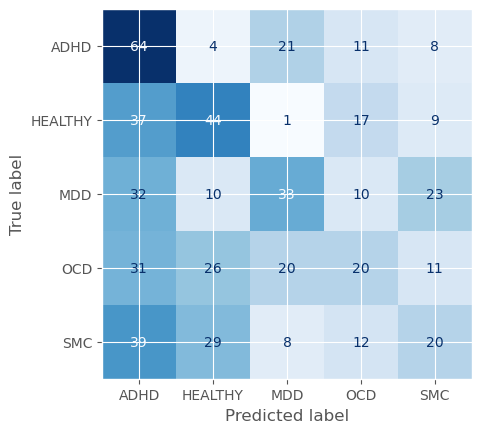

In [52]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_w_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3051793575286865     │
│         val_loss          │    1.9308056831359863     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.29      0.52      0.37        84
     HEALTHY       0.30      0.24      0.27        84
         MDD       0.25      0.20      0.23        84
         OCD       0.30      0.20      0.24        84
         SMC       0.44      0.41      0.42        96

    accuracy                           0.32       432
   macro avg       0.32      0.31      0.31       432
weighted avg       0.32      0.32      0.31       432

F1-score:
 0.30517932397057645


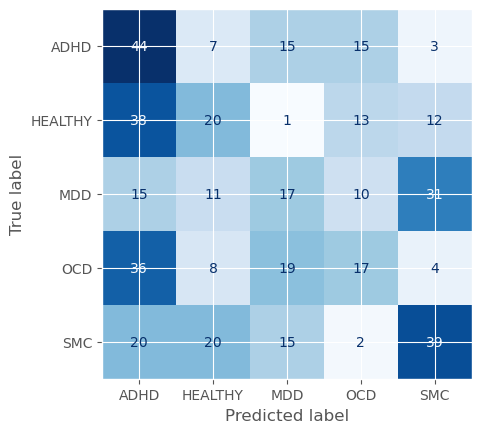

In [53]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [54]:
df_trials = pd.read_pickle('ec_results_w_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
61,61,0.317656,2024-06-21 01:53:19.644371,2024-06-21 01:56:11.457453,0 days 00:02:51.813082,170,0.426212,2,0.001532,SGD,/home/tsmolders/lightning_logs/version_261/che...,COMPLETE
12,12,0.314390,2024-06-20 22:03:06.727789,2024-06-20 22:11:46.691962,0 days 00:08:39.964173,850,0.203819,1,0.002523,SGD,/home/tsmolders/lightning_logs/version_212/che...,COMPLETE
66,66,0.312089,2024-06-21 02:04:19.678974,2024-06-21 02:10:30.131522,0 days 00:06:10.452548,680,0.287503,2,0.000388,SGD,/home/tsmolders/lightning_logs/version_266/che...,COMPLETE
81,81,0.310993,2024-06-21 03:23:40.710702,2024-06-21 03:32:36.017922,0 days 00:08:55.307220,850,0.307496,2,0.000585,SGD,/home/tsmolders/lightning_logs/version_281/che...,COMPLETE
70,70,0.309784,2024-06-21 02:28:42.543604,2024-06-21 02:34:46.944777,0 days 00:06:04.401173,680,0.395148,1,0.000224,SGD,/home/tsmolders/lightning_logs/version_270/che...,COMPLETE
71,71,0.308031,2024-06-21 02:34:46.947543,2024-06-21 02:40:54.902044,0 days 00:06:07.954501,680,0.395429,1,0.000242,SGD,/home/tsmolders/lightning_logs/version_271/che...,COMPLETE
42,42,0.307938,2024-06-21 00:29:39.914443,2024-06-21 00:34:50.392341,0 days 00:05:10.477898,510,0.099993,2,0.008649,SGD,/home/tsmolders/lightning_logs/version_242/che...,COMPLETE
85,85,0.306087,2024-06-21 03:41:44.004411,2024-06-21 03:50:29.531282,0 days 00:08:45.526871,850,0.321221,2,0.001545,SGD,/home/tsmolders/lightning_logs/version_285/che...,COMPLETE
96,96,0.305737,2024-06-21 04:46:50.322784,2024-06-21 04:49:36.055463,0 days 00:02:45.732679,170,0.248522,2,0.002168,SGD,/home/tsmolders/lightning_logs/version_296/che...,COMPLETE
39,39,0.303918,2024-06-21 00:18:51.966102,2024-06-21 00:24:02.526559,0 days 00:05:10.560457,510,0.235450,2,0.002358,SGD,/home/tsmolders/lightning_logs/version_239/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

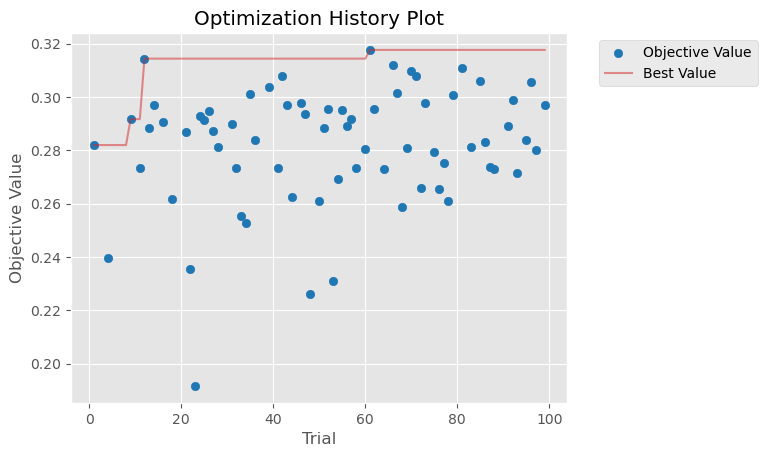

In [55]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-21 04:55:47,675] A new study created in memory with name: no-name-83c9935b-8afe-4f11-a716-79455f8d74f4
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


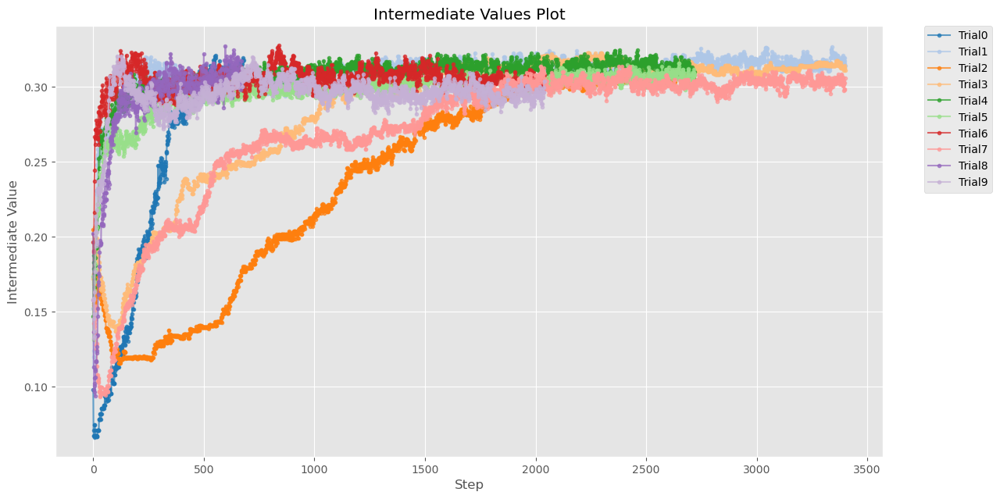

In [56]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


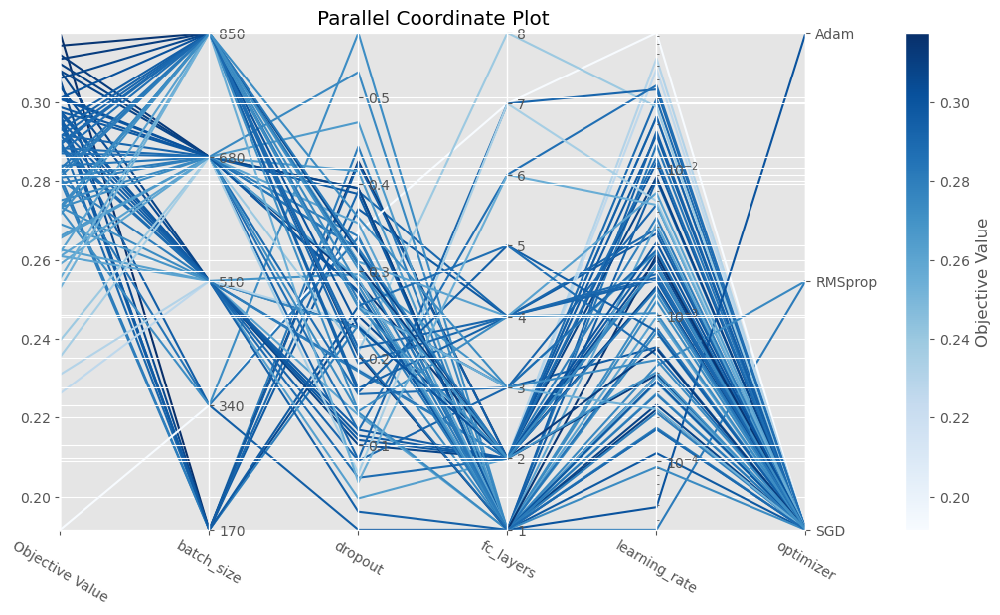

In [57]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-21 04:55:48,823] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


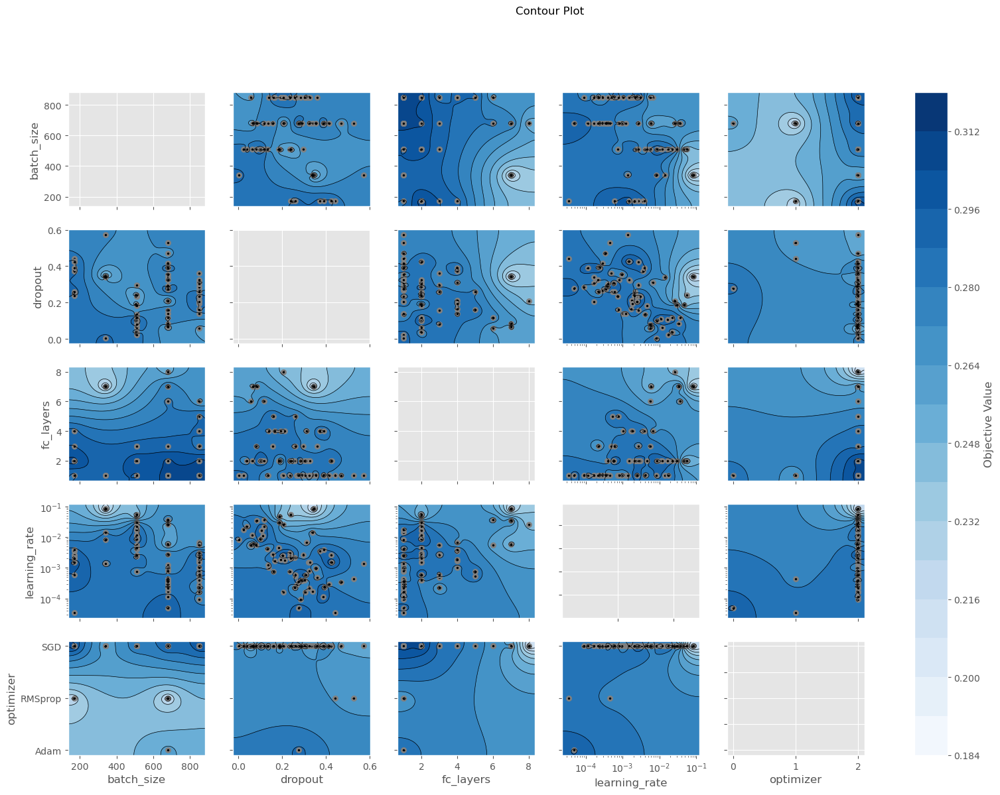

In [58]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

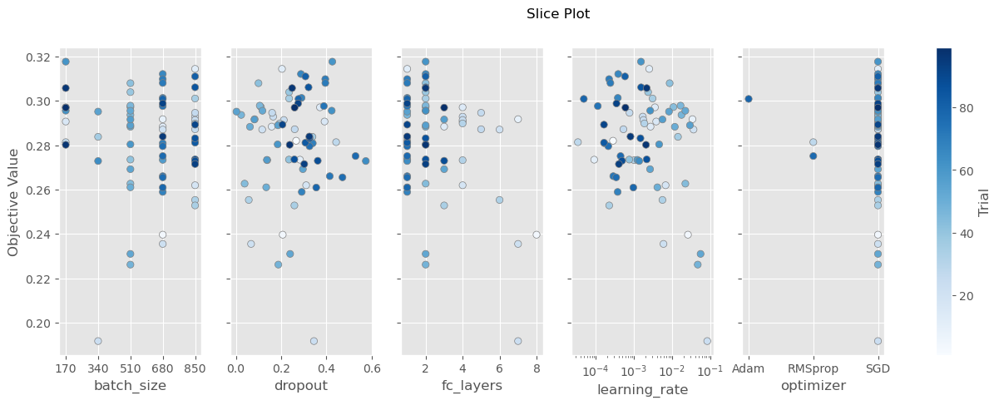

In [59]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

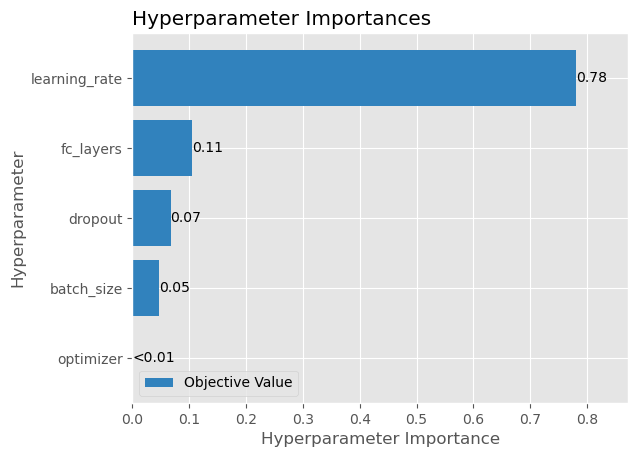

In [60]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

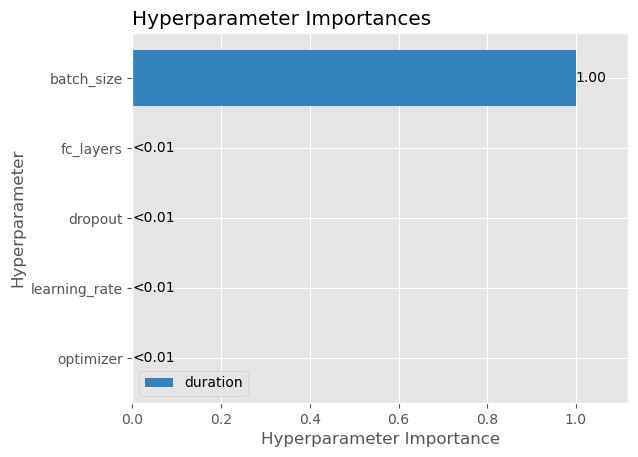

In [61]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

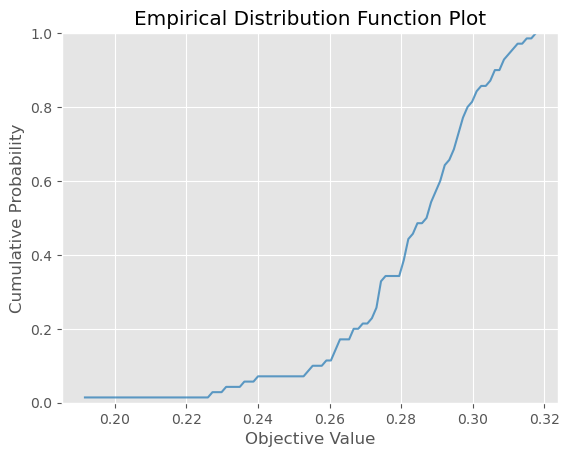

In [62]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-21 04:55:56,427] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


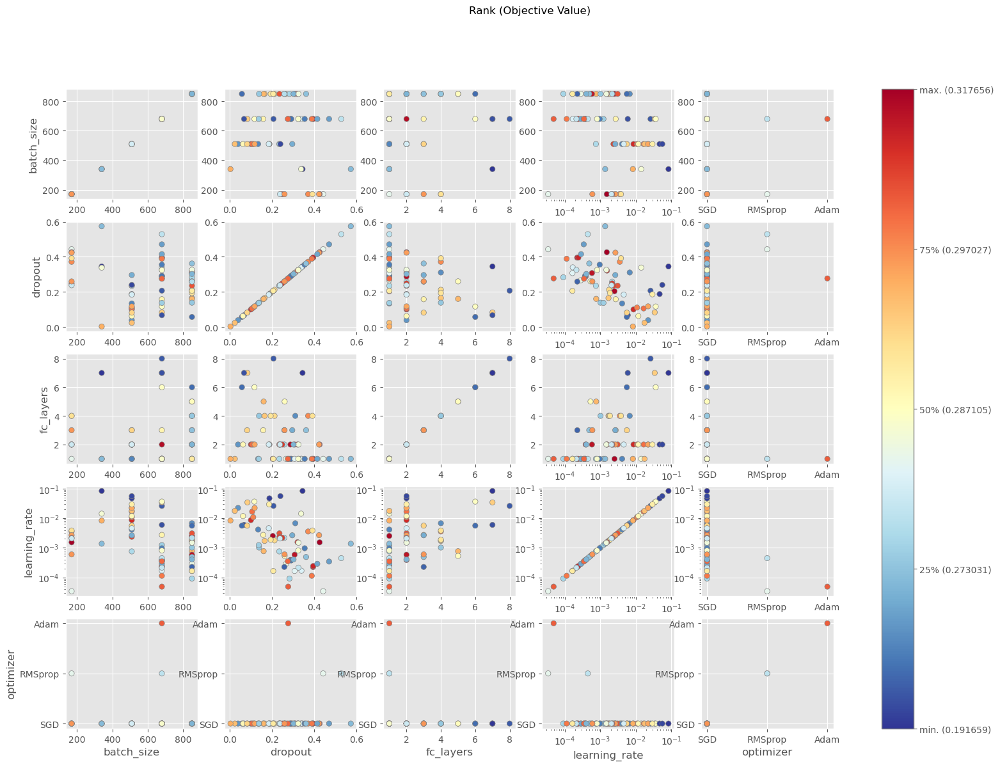

In [63]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


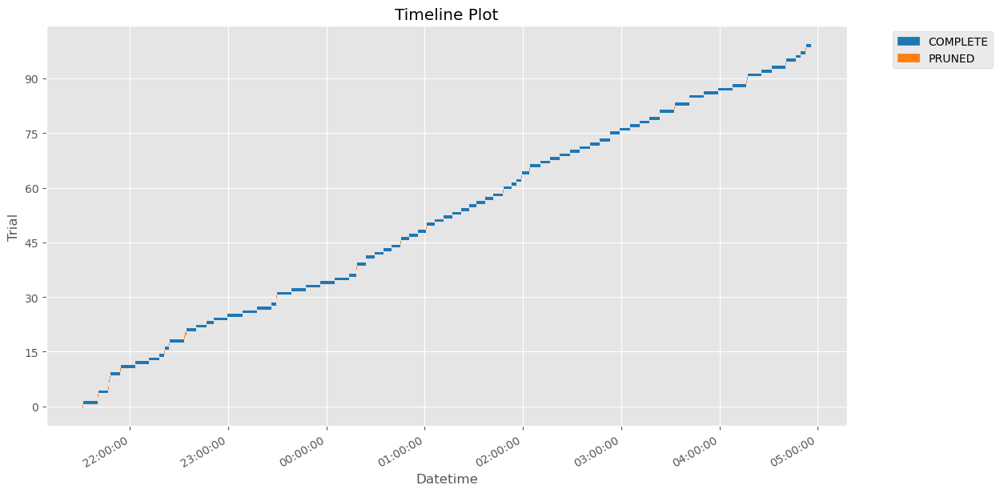

In [64]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

# 2. EO feature set

In [65]:
from sklearn.model_selection import StratifiedGroupKFold

baseline_rest_idxs = data_split_indices['EO'][0]
baseline_val_idxs = data_split_indices['EO'][1]

# first splitting validation data using the first split from the baseline RF model
groups = [elem for elem in subjects_eo_ids for i in range(12)] # times 12 for each epoch

print(f'{len(eo_graph_dataset) = }')
print(f'{len(baseline_rest_idxs) = }, {len(baseline_val_idxs) = }, total: {len(baseline_rest_idxs)+len(baseline_val_idxs)}')

X_traintest = [eo_graph_dataset[i] for i in baseline_rest_idxs] 
X_val = [eo_graph_dataset[i] for i in baseline_val_idxs]
Y_traintest =[eo_y_list[i] for i in baseline_rest_idxs]
Y_val = [eo_y_list[i] for i in baseline_val_idxs]
groups_traintest = [groups[i] for i in baseline_rest_idxs]
groups_val = [groups[i] for i in baseline_val_idxs]

# now splitting the test and training data with seperate StratifiedGroupKFold
desired_test_ratio = 0.20
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)  # should shuffle be true?

train_idxs, test_idxs = sgkf.split(X_traintest, Y_traintest, groups_traintest).__next__() # just take the first split
print(f'{len(X_traintest) = }, {len(X_val) = }')
print(f'{len(train_idxs) = }, {len(test_idxs) = }, total: {len(train_idxs)+len(test_idxs)}')

X_train = [X_traintest[i] for i in train_idxs] # X also includes y values, because they are stored in the Data object
X_test = [X_traintest[i] for i in test_idxs]
Y_train =[Y_traintest[i] for i in train_idxs]
Y_test = [Y_traintest[i] for i in test_idxs]

len(eo_graph_dataset) = 2700
len(baseline_rest_idxs) = 2160, len(baseline_val_idxs) = 540, total: 2700
len(X_traintest) = 2160, len(X_val) = 540
len(train_idxs) = 1716, len(test_idxs) = 444, total: 2160


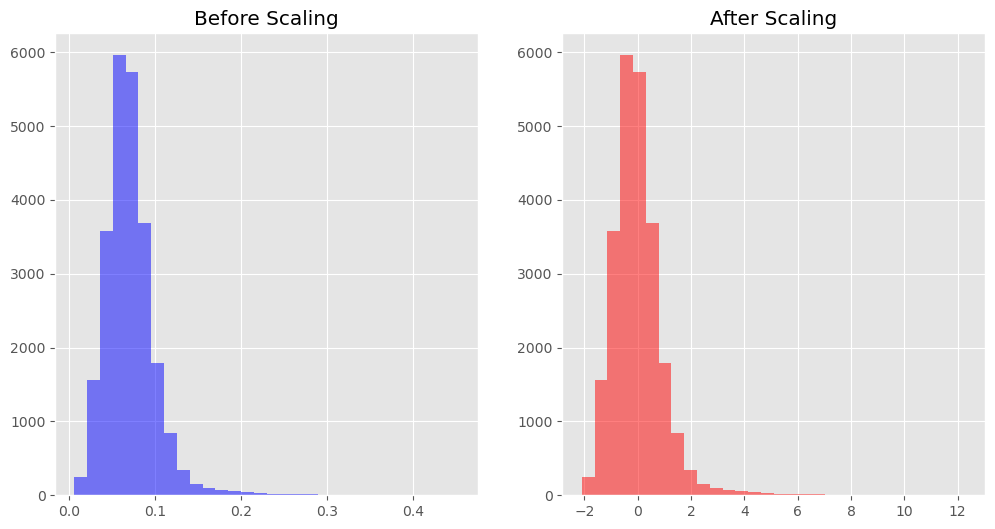

In [66]:
# standardize statistical node features
from sklearn.preprocessing import StandardScaler

# Concatenate all x values before scaling for the first feature, as a sanity check for standardization
x_before = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

scaler = StandardScaler()
scaler.fit(np.vstack([data.x.numpy() for data in X_train + X_val])) # fit on training and validation data


# Transform the x values of the data in X_train
for data in X_train:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_val
for data in X_val:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_test
for data in X_test:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Concatenate all x values after scaling for the first feature, as a sanity check for standardization
x_after = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

# Plot the distribution of the first x feature before and after scaling as a sanity check
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(x_before, bins=30, color='b', alpha=0.5)
plt.title('Before Scaling')

plt.subplot(1, 2, 2)
plt.hist(x_after, bins=30, color='r', alpha=0.5)
plt.title('After Scaling')

plt.show()

### Model: standard GCN

In [67]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = GCN(learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.MedianPruner(n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('eo_results_stand_GCN_trials.pkl')

[I 2024-06-21 04:56:00,883] A new study created in memory with name: no-name-437a47fd-ba37-4a90-b0bb-e61ffb49b5c1
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.004877496960630564, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.07196067168117262}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 04:58:10,445] Trial 0 finished with value: 0.32524192333221436 and parameters: {'learning_rate': 0.004877496960630564, 'optimizer': 'SGD', 'batch_size': 340, 'dropout': 0.07196067168117262}. Best is trial 0 with value: 0.32524192333221436.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.00796908158727735, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.42408659947417093}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 05:00:53,115] Trial 1 finished with value: 0.27299317717552185 and parameters: {'learning_rate': 0.00796908158727735, 'optimizer': 'SGD', 'batch_size': 510, 'dropout': 0.42408659947417093}. Best is trial 0 with value: 0.32524192333221436.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.013058799615828537, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.486301844076991}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 05:03:58,259] Trial 2 finished with value: 0.293146550655365 and parameters: {'learning_rate': 0.013058799615828537, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.486301844076991}. Best is trial 0 with value: 0.32524192333221436.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015720446948097185, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.1135205311030406}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 05:08:21,640] Trial 3 finished with value: 0.3100223243236542 and parameters: {'learning_rate': 0.0015720446948097185, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.1135205311030406}. Best is trial 0 with value: 0.32524192333221436.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.5192024809595169e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.06268519797080767}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:10:38,182] Trial 4 finished with value: 0.289750337600708 and parameters: {'learning_rate': 1.5192024809595169e-05, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.06268519797080767}. Best is trial 0 with value: 0.32524192333221436.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00026642274513224897, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.7716121143655617}


[I 2024-06-21 05:10:48,521] Trial 5 pruned. Trial was pruned at epoch 143.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.513284892341498e-05, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.5428618320816443}


[I 2024-06-21 05:10:58,054] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.012509161811826881, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3164330616139607}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 05:12:26,037] Trial 7 finished with value: 0.3295348882675171 and parameters: {'learning_rate': 0.012509161811826881, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.3164330616139607}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001089296282448625, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.41066201599346003}


[I 2024-06-21 05:12:39,112] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0129313781867091e-05, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.4636192957362226}


[I 2024-06-21 05:12:47,486] Trial 9 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.06849604154401275, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.25540467286031177}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 05:14:24,583] Trial 10 finished with value: 0.2656068205833435 and parameters: {'learning_rate': 0.06849604154401275, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.25540467286031177}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0077248771286644235, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.2248259002627378}


[I 2024-06-21 05:14:34,592] Trial 11 pruned. Trial was pruned at epoch 103.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08464591101769829, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.23911501180188727}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 05:16:00,329] Trial 12 finished with value: 0.2912885248661041 and parameters: {'learning_rate': 0.08464591101769829, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.23911501180188727}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.022013385467925424, 'optimizer_name': 'Adam', 'batch_size': 850, 'dropout': 0.012712481764225618}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 05:20:35,269] Trial 13 finished with value: 0.28249529004096985 and parameters: {'learning_rate': 0.022013385467925424, 'optimizer': 'Adam', 'batch_size': 850, 'dropout': 0.012712481764225618}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00021275381504588545, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.6101042221273483}


[I 2024-06-21 05:20:43,463] Trial 14 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0026287688798852377, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.1549471074401706}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:22:57,789] Trial 15 finished with value: 0.30844828486442566 and parameters: {'learning_rate': 0.0026287688798852377, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.1549471074401706}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00033267389511623186, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.34445559880117427}


[I 2024-06-21 05:23:11,222] Trial 16 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003490523046346163, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.2984363985469628}


[I 2024-06-21 05:23:21,106] Trial 17 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0394187208288753, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.14878995511976648}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 05:24:51,800] Trial 18 finished with value: 0.28284668922424316 and parameters: {'learning_rate': 0.0394187208288753, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.14878995511976648}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005205891802710941, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.6474957435652648}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 05:27:38,125] Trial 19 finished with value: 0.3032935559749603 and parameters: {'learning_rate': 0.005205891802710941, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.6474957435652648}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005597010713139288, 'optimizer_name': 'SGD', 'batch_size': 850, 'dropout': 0.33770599458462686}


[I 2024-06-21 05:27:45,730] Trial 20 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015241265286275877, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.11898705527140091}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 05:32:14,449] Trial 21 finished with value: 0.2762591242790222 and parameters: {'learning_rate': 0.0015241265286275877, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.11898705527140091}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010632318286792364, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.021569606258469654}


[I 2024-06-21 05:32:22,611] Trial 22 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02262667628687689, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.13123151525885704}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 05:36:48,629] Trial 23 finished with value: 0.30869412422180176 and parameters: {'learning_rate': 0.02262667628687689, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.13123151525885704}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0023395908762084217, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.08442101551419019}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:39:01,148] Trial 24 finished with value: 0.32159873843193054 and parameters: {'learning_rate': 0.0023395908762084217, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.08442101551419019}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0031594174179358056, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.19956471730343753}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:41:13,194] Trial 25 finished with value: 0.28343525528907776 and parameters: {'learning_rate': 0.0031594174179358056, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.19956471730343753}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.013987844415373605, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.06658228151702605}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:43:29,102] Trial 26 finished with value: 0.27825289964675903 and parameters: {'learning_rate': 0.013987844415373605, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.06658228151702605}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007521642255062772, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.3044167461329195}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 05:45:40,648] Trial 27 finished with value: 0.29546764492988586 and parameters: {'learning_rate': 0.0007521642255062772, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.3044167461329195}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03758794189996242, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.06472494078221229}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 05:47:08,786] Trial 28 finished with value: 0.2739943861961365 and parameters: {'learning_rate': 0.03758794189996242, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.06472494078221229}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007462481616250143, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.18606654080238266}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 05:49:56,407] Trial 29 finished with value: 0.2858344614505768 and parameters: {'learning_rate': 0.007462481616250143, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.18606654080238266}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0049358396734265845, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.00845441427219601}


[I 2024-06-21 05:50:07,748] Trial 30 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001691886013479441, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.10135957744852728}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 05:54:32,873] Trial 31 finished with value: 0.29982346296310425 and parameters: {'learning_rate': 0.001691886013479441, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.10135957744852728}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001911429740600832, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.09011927951811345}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 05:57:43,500] Trial 32 finished with value: 0.3085639476776123 and parameters: {'learning_rate': 0.001911429740600832, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.09011927951811345}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014761811650115106, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.17238966332442324}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:00:04,158] Trial 33 finished with value: 0.27958357334136963 and parameters: {'learning_rate': 0.014761811650115106, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.17238966332442324}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009894117918874597, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.27337668102966245}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:01:34,399] Trial 34 finished with value: 0.26781851053237915 and parameters: {'learning_rate': 0.009894117918874597, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.27337668102966245}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005002875647549031, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.05004715776885048}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:03:47,532] Trial 35 finished with value: 0.3082801103591919 and parameters: {'learning_rate': 0.005002875647549031, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.05004715776885048}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009942088488856446, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.3500305060788812}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 06:07:00,049] Trial 36 finished with value: 0.30054929852485657 and parameters: {'learning_rate': 0.0009942088488856446, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.3500305060788812}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.187505717870998e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'dropout': 0.4524771198136693}


[I 2024-06-21 06:07:08,748] Trial 37 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004240636535089948, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.5385880462625527}


[I 2024-06-21 06:07:18,908] Trial 38 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0024060020323889765, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.3987287003817747}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:08:45,995] Trial 39 finished with value: 0.31789886951446533 and parameters: {'learning_rate': 0.0024060020323889765, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.3987287003817747}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00253590567647161, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5148230198762942}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:10:14,897] Trial 40 finished with value: 0.2918609380722046 and parameters: {'learning_rate': 0.00253590567647161, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.5148230198762942}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011791111362544208, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.3689794321812232}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:11:41,685] Trial 41 finished with value: 0.29759877920150757 and parameters: {'learning_rate': 0.0011791111362544208, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.3689794321812232}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004413369713411259, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.43665325787336723}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:13:18,176] Trial 42 finished with value: 0.2835835814476013 and parameters: {'learning_rate': 0.004413369713411259, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.43665325787336723}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009898499030833246, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.40453834303798514}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 06:14:44,763] Trial 43 finished with value: 0.29977643489837646 and parameters: {'learning_rate': 0.009898499030833246, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.40453834303798514}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007983558108144739, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.23366101935325775}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 06:17:58,085] Trial 44 finished with value: 0.26924723386764526 and parameters: {'learning_rate': 0.0007983558108144739, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.23366101935325775}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00625821401575124, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.6419375614592712}


[I 2024-06-21 06:18:06,881] Trial 45 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02185476889340372, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.749751486280032}


[I 2024-06-21 06:18:19,869] Trial 46 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002072553919636383, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.21077969915044736}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:20:38,922] Trial 47 finished with value: 0.2897026538848877 and parameters: {'learning_rate': 0.002072553919636383, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.21077969915044736}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005825383000645338, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.48762122571326233}


[I 2024-06-21 06:20:51,888] Trial 48 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019004542486347406, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.039158161379157896}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 06:25:19,563] Trial 49 finished with value: 0.31203654408454895 and parameters: {'learning_rate': 0.00019004542486347406, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.039158161379157896}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.449206597180657e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.04250392699816511}


[I 2024-06-21 06:25:27,786] Trial 50 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.288650354543025e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.1077698779166153}


[I 2024-06-21 06:25:35,834] Trial 51 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003033829979020821, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.08447638599938855}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 06:30:12,110] Trial 52 finished with value: 0.28318238258361816 and parameters: {'learning_rate': 0.003033829979020821, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.08447638599938855}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013967318780274515, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.14682641770215976}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 06:34:38,101] Trial 53 finished with value: 0.31267350912094116 and parameters: {'learning_rate': 0.0013967318780274515, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.14682641770215976}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019784039678201378, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.14702929104484233}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 06:39:01,382] Trial 54 finished with value: 0.28249043226242065 and parameters: {'learning_rate': 0.00019784039678201378, 'optimizer': 'RMSprop', 'batch_size': 850, 'dropout': 0.14702929104484233}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013024455938699928, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.031466167404816135}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:41:15,296] Trial 55 finished with value: 0.3133745491504669 and parameters: {'learning_rate': 0.0013024455938699928, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.031466167404816135}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001243958377003425, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.3766763409035657}


[I 2024-06-21 06:41:25,092] Trial 56 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003998270930902409, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.308238080340927}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:43:44,211] Trial 57 finished with value: 0.3183788061141968 and parameters: {'learning_rate': 0.003998270930902409, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.308238080340927}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022065800737923877, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3070308339737458}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:45:59,756] Trial 58 finished with value: 0.3042137920856476 and parameters: {'learning_rate': 0.0022065800737923877, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3070308339737458}. Best is trial 7 with value: 0.3295348882675171.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010331301415222347, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3273406244264681}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:48:17,748] Trial 59 finished with value: 0.331920862197876 and parameters: {'learning_rate': 0.010331301415222347, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3273406244264681}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010310748709353133, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.2684813073972183}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:50:32,010] Trial 60 finished with value: 0.28959226608276367 and parameters: {'learning_rate': 0.010310748709353133, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.2684813073972183}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00751216857314762, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3299012996599165}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:52:49,655] Trial 61 finished with value: 0.2896556258201599 and parameters: {'learning_rate': 0.00751216857314762, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3299012996599165}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01840530977140853, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.42608216508038776}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:55:07,246] Trial 62 finished with value: 0.2961615025997162 and parameters: {'learning_rate': 0.01840530977140853, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.42608216508038776}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003994182953264249, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.2830548191659853}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:57:31,399] Trial 63 finished with value: 0.2845938205718994 and parameters: {'learning_rate': 0.003994182953264249, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.2830548191659853}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.038034515835713836, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.37597223258870044}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 06:59:45,801] Trial 64 finished with value: 0.2617821991443634 and parameters: {'learning_rate': 0.038034515835713836, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.37597223258870044}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003345889019440566, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.32339758324230433}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:02:00,229] Trial 65 finished with value: 0.28083667159080505 and parameters: {'learning_rate': 0.003345889019440566, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.32339758324230433}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006631037215410861, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.2448358083107361}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:04:15,199] Trial 66 finished with value: 0.28649330139160156 and parameters: {'learning_rate': 0.006631037215410861, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.2448358083107361}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011373171086891872, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.006018947817392255}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:06:33,688] Trial 67 finished with value: 0.2886267602443695 and parameters: {'learning_rate': 0.011373171086891872, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.006018947817392255}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0259753457306862, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.17710144889967844}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 07:09:18,901] Trial 68 finished with value: 0.29033419489860535 and parameters: {'learning_rate': 0.0259753457306862, 'optimizer': 'SGD', 'batch_size': 510, 'dropout': 0.17710144889967844}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014916942938208345, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3925165650333414}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:11:35,778] Trial 69 finished with value: 0.31982433795928955 and parameters: {'learning_rate': 0.014916942938208345, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3925165650333414}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014594695599477504, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.4819760766446385}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:13:12,342] Trial 70 finished with value: 0.26670196652412415 and parameters: {'learning_rate': 0.014594695599477504, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.4819760766446385}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.058141189890479776, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3529166949977988}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:15:36,437] Trial 71 finished with value: 0.3140602111816406 and parameters: {'learning_rate': 0.058141189890479776, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3529166949977988}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.07716216422886671, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3647725207270089}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:17:54,612] Trial 72 finished with value: 0.3068990707397461 and parameters: {'learning_rate': 0.07716216422886671, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3647725207270089}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05638876901686298, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3996337318629413}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:20:15,403] Trial 73 finished with value: 0.2616955041885376 and parameters: {'learning_rate': 0.05638876901686298, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3996337318629413}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.030517047264663047, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.3959454114609226}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:22:31,254] Trial 74 finished with value: 0.30699169635772705 and parameters: {'learning_rate': 0.030517047264663047, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.3959454114609226}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006163648553565069, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.30681969109405505}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:24:47,589] Trial 75 finished with value: 0.29227587580680847 and parameters: {'learning_rate': 0.006163648553565069, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.30681969109405505}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.058176624717695136, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.45212456936032447}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 07:27:55,573] Trial 76 finished with value: 0.2914266884326935 and parameters: {'learning_rate': 0.058176624717695136, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.45212456936032447}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09282467274541066, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.35632038260011095}


[I 2024-06-21 07:28:08,968] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01862206966406483, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.33204019296106296}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:30:29,057] Trial 78 finished with value: 0.2887299358844757 and parameters: {'learning_rate': 0.01862206966406483, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.33204019296106296}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008415373817259717, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.419008751500247}


[I 2024-06-21 07:30:39,765] Trial 79 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00403176887442524, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.2905912056453336}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:32:11,733] Trial 80 finished with value: 0.27570903301239014 and parameters: {'learning_rate': 0.00403176887442524, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.2905912056453336}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022585096433703, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.0826642337751261}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:34:31,762] Trial 81 finished with value: 0.2931653559207916 and parameters: {'learning_rate': 0.0022585096433703, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.0826642337751261}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0016853583582873278, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.024440412058742117}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:36:45,896] Trial 82 finished with value: 0.3006966710090637 and parameters: {'learning_rate': 0.0016853583582873278, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.024440412058742117}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005405479627418577, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.2660114811868496}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:39:05,403] Trial 83 finished with value: 0.3113226890563965 and parameters: {'learning_rate': 0.005405479627418577, 'optimizer': 'RMSprop', 'batch_size': 340, 'dropout': 0.2660114811868496}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0027832848726251297, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.2126824618953102}


[I 2024-06-21 07:39:16,764] Trial 84 pruned. Trial was pruned at epoch 104.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05018584028187279, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.12086805877304668}


[I 2024-06-21 07:39:24,925] Trial 85 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008274400216211267, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.38464483005480765}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:41:46,330] Trial 86 finished with value: 0.2918166220188141 and parameters: {'learning_rate': 0.008274400216211267, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.38464483005480765}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009219636911232598, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.34789074167515927}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:43:18,112] Trial 87 finished with value: 0.28591597080230713 and parameters: {'learning_rate': 0.0009219636911232598, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.34789074167515927}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0033833701936920877, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.5582269775393456}


[I 2024-06-21 07:43:30,200] Trial 88 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01380497963968765, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.319679539618456}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 07:45:46,806] Trial 89 finished with value: 0.29045841097831726 and parameters: {'learning_rate': 0.01380497963968765, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.319679539618456}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01787372645424218, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.06535709829422656}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 07:48:59,537] Trial 90 finished with value: 0.2751864194869995 and parameters: {'learning_rate': 0.01787372645424218, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.06535709829422656}. Best is trial 59 with value: 0.331920862197876.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0017890504804672991, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.13512904206810725}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:50:29,749] Trial 91 finished with value: 0.3354463577270508 and parameters: {'learning_rate': 0.0017890504804672991, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.13512904206810725}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0018635309249545753, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.03881357415419048}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:52:02,213] Trial 92 finished with value: 0.3091915249824524 and parameters: {'learning_rate': 0.0018635309249545753, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.03881357415419048}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014502050258169174, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.09960950827983533}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:53:32,595] Trial 93 finished with value: 0.3118108808994293 and parameters: {'learning_rate': 0.0014502050258169174, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.09960950827983533}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006251654771912672, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.12603630282817058}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:55:07,402] Trial 94 finished with value: 0.31373167037963867 and parameters: {'learning_rate': 0.0006251654771912672, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.12603630282817058}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00027322369240703157, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.16794139943188569}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:56:39,898] Trial 95 finished with value: 0.2717767655849457 and parameters: {'learning_rate': 0.00027322369240703157, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.16794139943188569}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00045819722575451174, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.4399599959786813}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:58:07,555] Trial 96 finished with value: 0.31249403953552246 and parameters: {'learning_rate': 0.00045819722575451174, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.4399599959786813}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007223862873868941, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.12197830018336238}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 07:59:38,292] Trial 97 finished with value: 0.2838207483291626 and parameters: {'learning_rate': 0.0007223862873868941, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.12197830018336238}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004738423128637491, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.1334521751963959}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 08:01:09,385] Trial 98 finished with value: 0.2773107588291168 and parameters: {'learning_rate': 0.004738423128637491, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.1334521751963959}. Best is trial 91 with value: 0.3354463577270508.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0024478602465000964, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.19129972001360906}


[I 2024-06-21 08:01:22,752] Trial 99 pruned. Trial was pruned at epoch 100.


Best trial:
  Value: 0.3354463577270508
  Params: 
    learning_rate: 0.0017890504804672991
    optimizer: RMSprop
    batch_size: 170
    dropout: 0.13512904206810725


In [68]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_391/checkpoints/epoch=4-train_loss=1.27-train_f1=0.44-val_loss=1.58-val_f1=0.36.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.0017890504804672991, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.13512904206810725}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.36054033041000366    │
│         val_loss          │    1.5824941396713257     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.60      0.51      0.55       108
     HEALTHY       0.40      0.36      0.38       108
         MDD       0.28      0.26      0.27       108
         OCD       0.34      0.38      0.36       108
         SMC       0.22      0.27      0.24       108

    accuracy                           0.36       540
   macro avg       0.37      0.36      0.36       540
weighted avg       0.37      0.36      0.36       540

F1-score: 0.36054032226526533


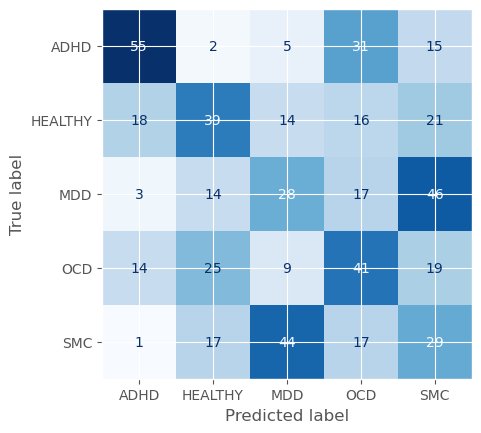

In [69]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
# Load the model directly from the checkpoint
model = GCN.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.39960846304893494    │
│         val_loss          │     1.443223237991333     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.53      0.36      0.43        96
     HEALTHY       0.34      0.35      0.34        84
         MDD       0.37      0.27      0.31        96
         OCD       0.38      0.49      0.43        84
         SMC       0.42      0.57      0.48        84

    accuracy                           0.40       444
   macro avg       0.41      0.41      0.40       444
weighted avg       0.41      0.40      0.40       444

F1-score:
 0.39960848747746436


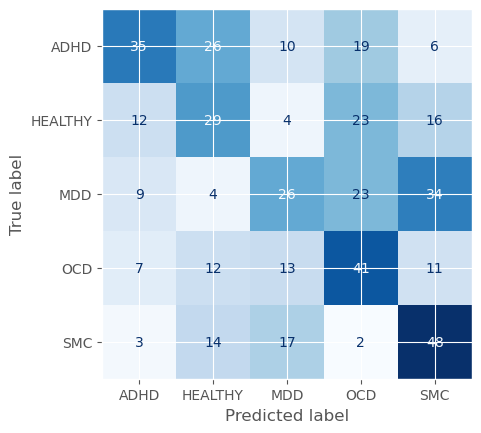

In [70]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [71]:
df_trials = pd.read_pickle('eo_results_stand_GCN_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
91,91,0.335446,2024-06-21 07:48:59.539110,2024-06-21 07:50:29.748301,0 days 00:01:30.209191,170,0.135129,0.001789,RMSprop,/home/tsmolders/lightning_logs/version_391/che...,COMPLETE
59,59,0.331921,2024-06-21 06:45:59.756978,2024-06-21 06:48:17.746824,0 days 00:02:17.989846,340,0.327341,0.010331,Adam,/home/tsmolders/lightning_logs/version_359/che...,COMPLETE
7,7,0.329535,2024-06-21 05:10:58.056040,2024-06-21 05:12:26.036812,0 days 00:01:27.980772,170,0.316433,0.012509,Adam,/home/tsmolders/lightning_logs/version_307/che...,COMPLETE
0,0,0.325242,2024-06-21 04:56:00.885905,2024-06-21 04:58:10.443900,0 days 00:02:09.557995,340,0.071961,0.004877,SGD,/home/tsmolders/lightning_logs/version_300/che...,COMPLETE
24,24,0.321599,2024-06-21 05:36:48.630527,2024-06-21 05:39:01.147090,0 days 00:02:12.516563,340,0.084421,0.002340,RMSprop,/home/tsmolders/lightning_logs/version_324/che...,COMPLETE
69,69,0.319824,2024-06-21 07:09:18.902273,2024-06-21 07:11:35.777078,0 days 00:02:16.874805,340,0.392517,0.014917,Adam,/home/tsmolders/lightning_logs/version_369/che...,COMPLETE
57,57,0.318379,2024-06-21 06:41:25.092854,2024-06-21 06:43:44.209631,0 days 00:02:19.116777,340,0.308238,0.003998,Adam,/home/tsmolders/lightning_logs/version_357/che...,COMPLETE
39,39,0.317899,2024-06-21 06:07:18.908766,2024-06-21 06:08:45.994989,0 days 00:01:27.086223,170,0.398729,0.002406,RMSprop,/home/tsmolders/lightning_logs/version_339/che...,COMPLETE
71,71,0.314060,2024-06-21 07:13:12.343345,2024-06-21 07:15:36.436167,0 days 00:02:24.092822,340,0.352917,0.058141,Adam,/home/tsmolders/lightning_logs/version_371/che...,COMPLETE
94,94,0.313732,2024-06-21 07:53:32.596765,2024-06-21 07:55:07.401597,0 days 00:01:34.804832,170,0.126036,0.000625,RMSprop,/home/tsmolders/lightning_logs/version_394/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

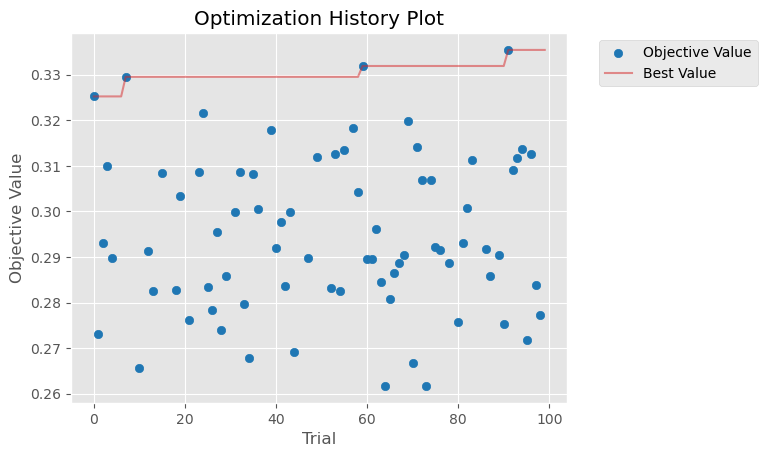

In [72]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-21 08:01:23,568] A new study created in memory with name: no-name-0ee75f26-bc9c-4ca6-bb6e-ddaeecff50cb
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


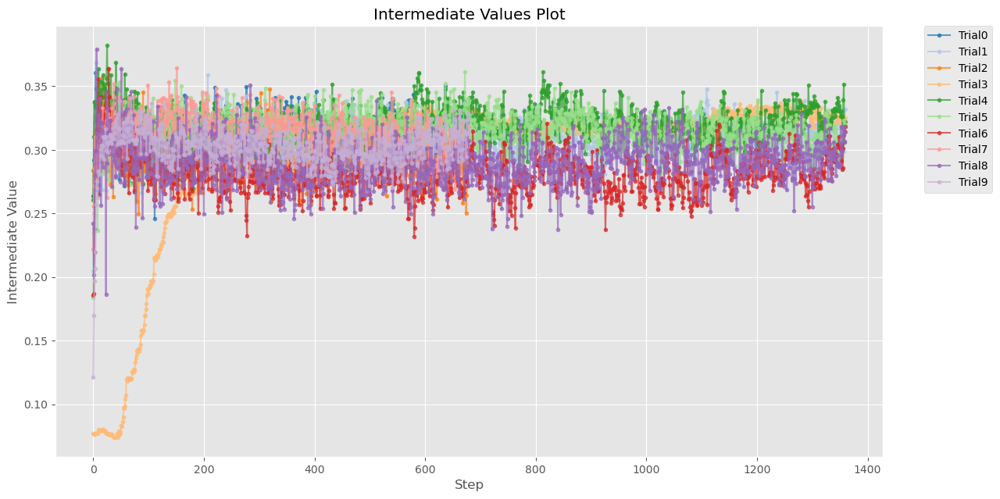

In [73]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


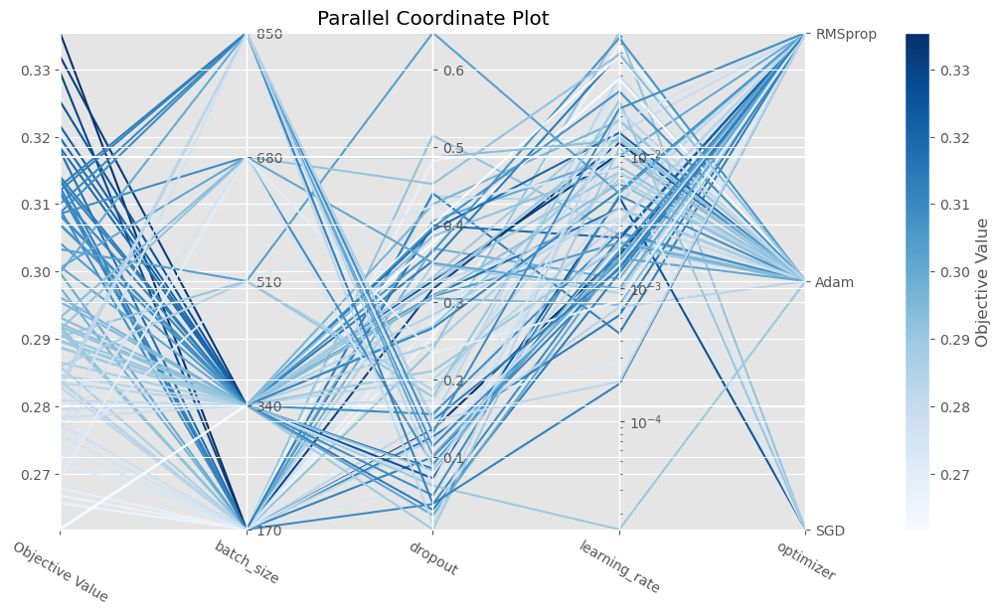

In [74]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-21 08:01:24,675] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


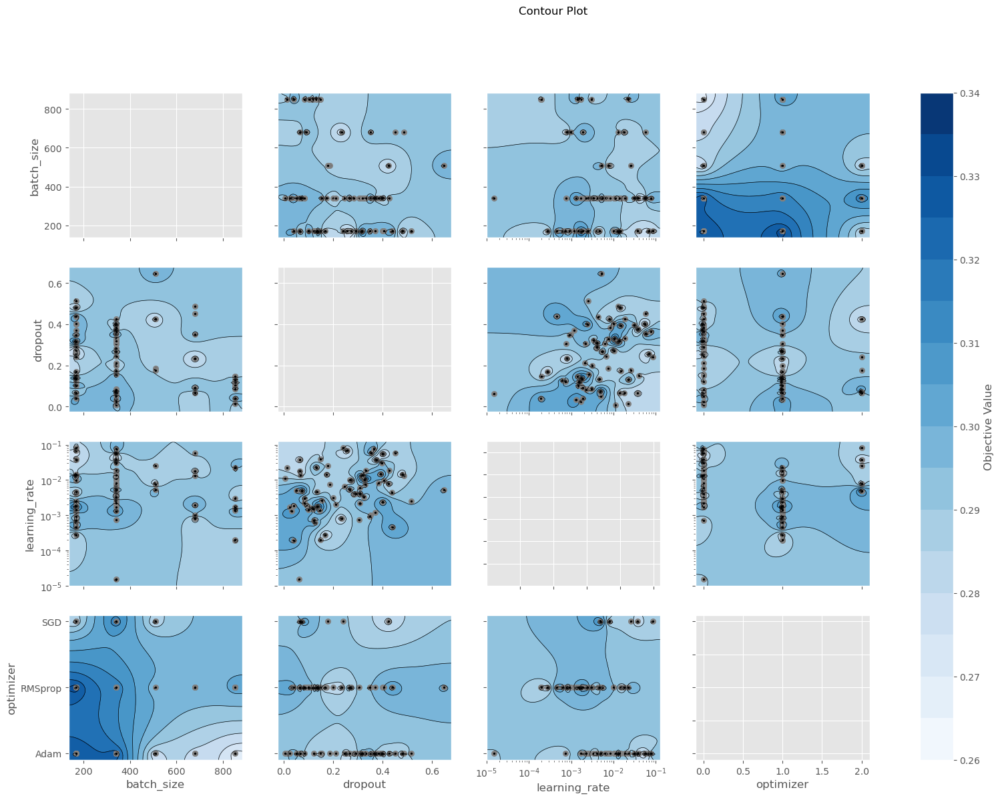

In [75]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='learning_rate'>,
       <Axes: xlabel='optimizer'>], dtype=object)

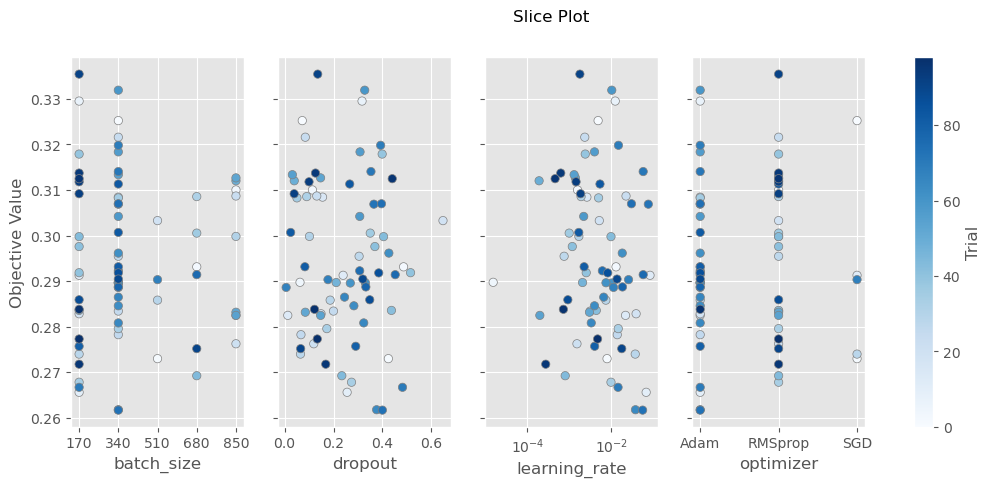

In [76]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

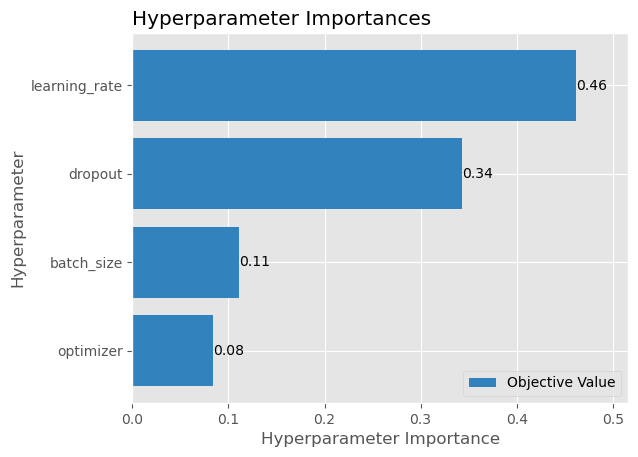

In [77]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

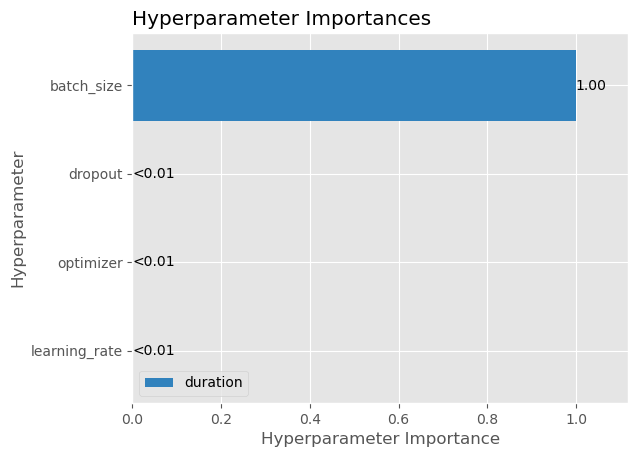

In [78]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

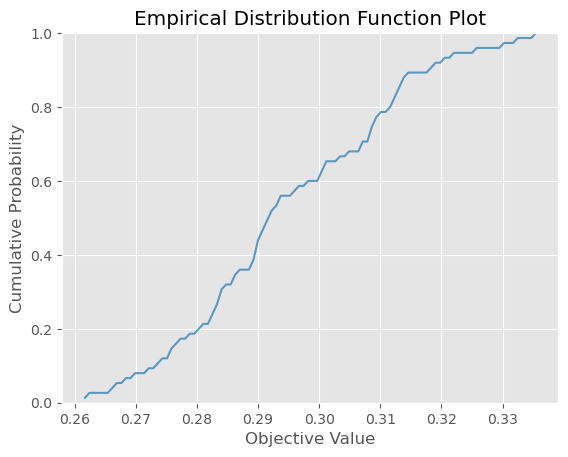

In [79]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-21 08:01:30,666] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


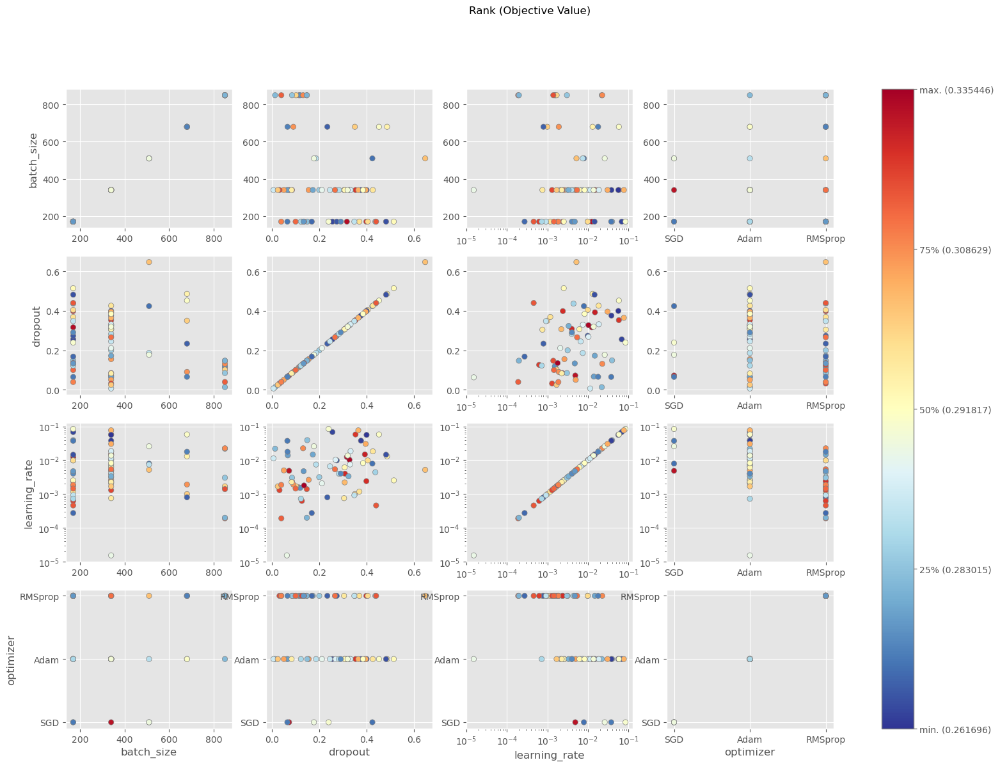

In [80]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


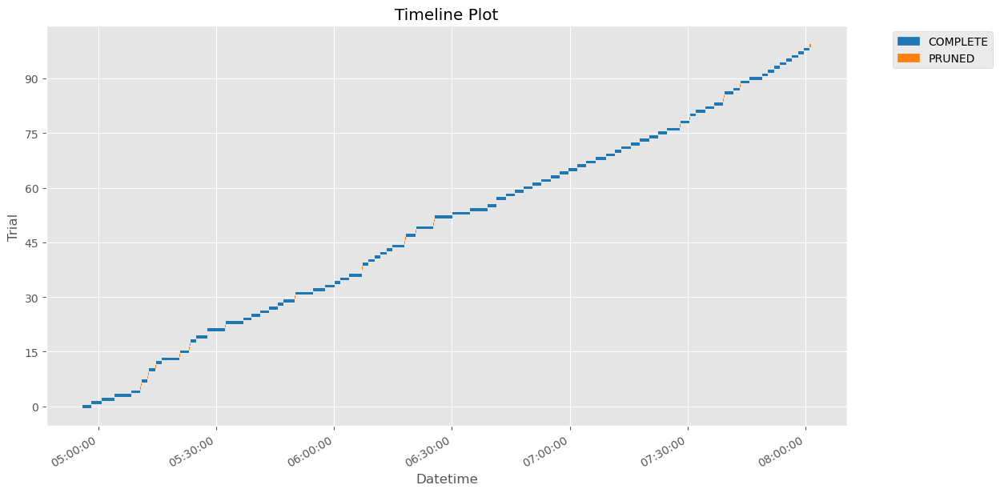

In [81]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda without edge_attr

In [82]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = graphLambda_wo_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)

    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('eo_results_wo_edge_attrs_trials.pkl')

[I 2024-06-21 08:01:33,357] A new study created in memory with name: no-name-393d5aa3-cec5-4b77-a86d-62cbd505ec4b
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.001842314614562907, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.5679182273730332}


[I 2024-06-21 08:01:46,447] Trial 0 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0010557966756126371, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.48534346417356594}


[I 2024-06-21 08:02:12,175] Trial 1 pruned. Trial was pruned at epoch 196.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.650914321668132e-05, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.5099346734042937}


[I 2024-06-21 08:03:42,391] Trial 2 pruned. Trial was pruned at epoch 678.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00041548700505699863, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.6256216694554788}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 08:10:46,920] Trial 3 finished with value: 0.30201780796051025 and parameters: {'learning_rate': 0.00041548700505699863, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.6256216694554788}. Best is trial 3 with value: 0.30201780796051025.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.6220878911511044e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2810392922924511}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 08:17:57,200] Trial 4 finished with value: 0.30286458134651184 and parameters: {'learning_rate': 3.6220878911511044e-05, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2810392922924511}. Best is trial 4 with value: 0.30286458134651184.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00138849641351412, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.2584686118301378}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 08:25:01,840] Trial 5 finished with value: 0.3126237392425537 and parameters: {'learning_rate': 0.00138849641351412, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.2584686118301378}. Best is trial 5 with value: 0.3126237392425537.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006250511275225578, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.6546117032245183}


[I 2024-06-21 08:25:15,094] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002317014434831292, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.6715056266093966}


[I 2024-06-21 08:25:28,256] Trial 7 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0013160944432359756, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.7357248876454584}


[I 2024-06-21 08:25:44,198] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010993675189465647, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.4008042820552616}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 08:29:28,887] Trial 9 finished with value: 0.30870622396469116 and parameters: {'learning_rate': 0.00010993675189465647, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.4008042820552616}. Best is trial 5 with value: 0.3126237392425537.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09610043657028339, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.0010118162941067377}


[I 2024-06-21 08:30:35,140] Trial 10 pruned. Trial was pruned at epoch 579.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0001568602931997629, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.29334593706664974}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 08:33:16,615] Trial 11 finished with value: 0.17544007301330566 and parameters: {'learning_rate': 0.0001568602931997629, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.29334593706664974}. Best is trial 5 with value: 0.3126237392425537.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001502372255998708, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 4, 'dropout': 0.16649683150932842}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 08:37:02,290] Trial 12 finished with value: 0.26086485385894775 and parameters: {'learning_rate': 0.0001502372255998708, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 4, 'dropout': 0.16649683150932842}. Best is trial 5 with value: 0.3126237392425537.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.017785924585954304, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.3364151698720039}


[I 2024-06-21 08:37:18,761] Trial 13 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001855070821380419, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.1561437996847671}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 08:42:38,367] Trial 14 finished with value: 0.32546818256378174 and parameters: {'learning_rate': 0.0001855070821380419, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.1561437996847671}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004734662223949802, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.12760028537845772}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 08:47:39,930] Trial 15 finished with value: 0.29140573740005493 and parameters: {'learning_rate': 0.0004734662223949802, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.12760028537845772}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00762426667382134, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.1604366379058607}


[I 2024-06-21 08:47:51,044] Trial 16 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.283792286323242e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.038929253689284876}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 08:50:25,255] Trial 17 finished with value: 0.3117995858192444 and parameters: {'learning_rate': 1.283792286323242e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.038929253689284876}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003584457357912062, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.20454655952142942}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 08:55:31,968] Trial 18 finished with value: 0.2741227447986603 and parameters: {'learning_rate': 0.0003584457357912062, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.20454655952142942}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005221317060216484, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.09063397593838673}


[I 2024-06-21 08:55:44,429] Trial 19 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04787859569976603, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.22163401014075917}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 09:00:54,693] Trial 20 finished with value: 0.29422080516815186 and parameters: {'learning_rate': 0.04787859569976603, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.22163401014075917}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3299997861668157e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.0037163407829770567}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:03:39,087] Trial 21 finished with value: 0.3240935206413269 and parameters: {'learning_rate': 1.3299997861668157e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.0037163407829770567}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.1799801073064767e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.062478938278212603}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:06:16,688] Trial 22 finished with value: 0.3000151515007019 and parameters: {'learning_rate': 1.1799801073064767e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.062478938278212603}. Best is trial 14 with value: 0.32546818256378174.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.090283730638519e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2468823223938831}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:08:56,361] Trial 23 finished with value: 0.32688838243484497 and parameters: {'learning_rate': 4.090283730638519e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2468823223938831}. Best is trial 23 with value: 0.32688838243484497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.688727252559628e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.3699183421821163}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:11:31,893] Trial 24 finished with value: 0.30062761902809143 and parameters: {'learning_rate': 4.688727252559628e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.3699183421821163}. Best is trial 23 with value: 0.32688838243484497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.430707770640501e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.11033088938735915}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:14:09,860] Trial 25 finished with value: 0.29921555519104004 and parameters: {'learning_rate': 7.430707770640501e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.11033088938735915}. Best is trial 23 with value: 0.32688838243484497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.31752206499715e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.01780610242809294}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:16:41,860] Trial 26 finished with value: 0.3041270971298218 and parameters: {'learning_rate': 2.31752206499715e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.01780610242809294}. Best is trial 23 with value: 0.32688838243484497.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.9704754623230243e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.18961491922344326}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:19:15,301] Trial 27 finished with value: 0.33498188853263855 and parameters: {'learning_rate': 1.9704754623230243e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.18961491922344326}. Best is trial 27 with value: 0.33498188853263855.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00030690174621627263, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.4416732401622298}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:21:53,249] Trial 28 finished with value: 0.2926522195339203 and parameters: {'learning_rate': 0.00030690174621627263, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.4416732401622298}. Best is trial 27 with value: 0.33498188853263855.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.167102118156113e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.22979000916316797}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 09:26:52,994] Trial 29 finished with value: 0.2838591933250427 and parameters: {'learning_rate': 7.167102118156113e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.22979000916316797}. Best is trial 27 with value: 0.33498188853263855.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.267164735795134e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.33147505054807247}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:29:32,620] Trial 30 finished with value: 0.3304000198841095 and parameters: {'learning_rate': 2.267164735795134e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.33147505054807247}. Best is trial 27 with value: 0.33498188853263855.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.4225783576842605e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.31876343401573703}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:32:08,235] Trial 31 finished with value: 0.2764441967010498 and parameters: {'learning_rate': 2.4225783576842605e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.31876343401573703}. Best is trial 27 with value: 0.33498188853263855.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.1569666045805592e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.17887850861871554}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:34:46,398] Trial 32 finished with value: 0.33736705780029297 and parameters: {'learning_rate': 2.1569666045805592e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.17887850861871554}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.379325703971799e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.3577413037836786}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:37:24,908] Trial 33 finished with value: 0.3028836250305176 and parameters: {'learning_rate': 2.379325703971799e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.3577413037836786}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.6168767738113876e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.5367015519272625}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:40:01,521] Trial 34 finished with value: 0.2952985465526581 and parameters: {'learning_rate': 4.6168767738113876e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.5367015519272625}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.9402575901042893e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.45536368713447994}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:42:39,812] Trial 35 finished with value: 0.30254799127578735 and parameters: {'learning_rate': 1.9402575901042893e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.45536368713447994}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.335063424138806e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.2557723504621374}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:45:14,079] Trial 36 finished with value: 0.280123770236969 and parameters: {'learning_rate': 5.335063424138806e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.2557723504621374}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.2569204623706135e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.1795288751049232}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:47:49,105] Trial 37 finished with value: 0.2989562749862671 and parameters: {'learning_rate': 3.2569204623706135e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.1795288751049232}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.932559577699968e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.28497266286306094}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 09:52:13,003] Trial 38 finished with value: 0.2984350025653839 and parameters: {'learning_rate': 7.932559577699968e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.28497266286306094}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007116264563480537, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.40015763180070435}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 09:54:49,631] Trial 39 finished with value: 0.2989146113395691 and parameters: {'learning_rate': 0.0007116264563480537, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.40015763180070435}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.789674253259299e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.25208361416387354}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:02:02,858] Trial 40 finished with value: 0.2164383977651596 and parameters: {'learning_rate': 1.789674253259299e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.25208361416387354}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011047889604352587, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.08785097529531631}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 10:06:29,586] Trial 41 finished with value: 0.2926711440086365 and parameters: {'learning_rate': 0.00011047889604352587, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.08785097529531631}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.12985191646852e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.14450420972359357}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 10:09:04,693] Trial 42 finished with value: 0.32336366176605225 and parameters: {'learning_rate': 3.12985191646852e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.14450420972359357}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00023908463422025908, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.19440600284685633}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 10:14:06,470] Trial 43 finished with value: 0.29729682207107544 and parameters: {'learning_rate': 0.00023908463422025908, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.19440600284685633}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00013584428432384524, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.2883526732436673}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 10:16:46,207] Trial 44 finished with value: 0.31563735008239746 and parameters: {'learning_rate': 0.00013584428432384524, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.2883526732436673}. Best is trial 32 with value: 0.33736705780029297.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.000031773403545e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2305388744250653}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:23:57,137] Trial 45 finished with value: 0.34309348464012146 and parameters: {'learning_rate': 1.000031773403545e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.2305388744250653}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.2117545477932757e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.3150410430685233}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:31:04,114] Trial 46 finished with value: 0.3233503997325897 and parameters: {'learning_rate': 1.2117545477932757e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.3150410430685233}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0538926842422485e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.22675551759195436}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:38:23,889] Trial 47 finished with value: 0.33014076948165894 and parameters: {'learning_rate': 1.0538926842422485e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.22675551759195436}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0411175866538396e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.7797917567813529}


[I 2024-06-21 10:38:37,224] Trial 48 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.6815810378990886e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.199718482683502}


[I 2024-06-21 10:38:50,072] Trial 49 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0178601265630099e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.34739837741431073}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:46:04,678] Trial 50 finished with value: 0.2947319746017456 and parameters: {'learning_rate': 1.0178601265630099e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.34739837741431073}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.822179160764961e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.24129365812560424}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 10:53:12,491] Trial 51 finished with value: 0.3166857957839966 and parameters: {'learning_rate': 2.822179160764961e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.24129365812560424}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.6186288319600444e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.2730122767655882}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 10:56:50,159] Trial 52 finished with value: 0.3189038634300232 and parameters: {'learning_rate': 1.6186288319600444e-05, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.2730122767655882}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.0339781676824574e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.12772595649679916}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:04:00,293] Trial 53 finished with value: 0.3352784514427185 and parameters: {'learning_rate': 4.0339781676824574e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.12772595649679916}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.53341420110796e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.13629383031601058}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:11:09,284] Trial 54 finished with value: 0.29080092906951904 and parameters: {'learning_rate': 6.53341420110796e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.13629383031601058}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.43472196716879e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.10944064089223564}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:18:12,728] Trial 55 finished with value: 0.2889709174633026 and parameters: {'learning_rate': 3.43472196716879e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.10944064089223564}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.6758976470516097e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.17392458070791803}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:25:33,331] Trial 56 finished with value: 0.29174336791038513 and parameters: {'learning_rate': 1.6758976470516097e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.17392458070791803}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.2755808571197002e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.21727662549464333}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:32:36,167] Trial 57 finished with value: 0.1710914820432663 and parameters: {'learning_rate': 2.2755808571197002e-05, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.21727662549464333}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.4682125048646318e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.05148291566547439}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:39:39,569] Trial 58 finished with value: 0.30289125442504883 and parameters: {'learning_rate': 1.4682125048646318e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.05148291566547439}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.768938647368784e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.15863098032457607}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 11:44:02,784] Trial 59 finished with value: 0.29548221826553345 and parameters: {'learning_rate': 9.768938647368784e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.15863098032457607}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.4090237343390695e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.3098168846174871}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 11:47:37,892] Trial 60 finished with value: 0.2900792062282562 and parameters: {'learning_rate': 5.4090237343390695e-05, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.3098168846174871}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.75794667584821e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.21963056422681732}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 11:50:08,582] Trial 61 finished with value: 0.2863262891769409 and parameters: {'learning_rate': 3.75794667584821e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.21963056422681732}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.146356184466775e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.25904259778460426}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 11:57:14,119] Trial 62 finished with value: 0.28493157029151917 and parameters: {'learning_rate': 4.146356184466775e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.25904259778460426}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0025052842396588106, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.3750769303274295}


[I 2024-06-21 11:57:40,990] Trial 63 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.6502981122101302e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.1929300965716283}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:00:19,467] Trial 64 finished with value: 0.32368752360343933 and parameters: {'learning_rate': 2.6502981122101302e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.1929300965716283}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.9703249907333255e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.07546111641259062}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 12:07:29,106] Trial 65 finished with value: 0.303433358669281 and parameters: {'learning_rate': 1.9703249907333255e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.07546111641259062}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3314533717909879e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.11604642917804153}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:10:05,279] Trial 66 finished with value: 0.3180249333381653 and parameters: {'learning_rate': 1.3314533717909879e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.11604642917804153}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0696974286486202e-05, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.23890422916060697}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 12:13:40,472] Trial 67 finished with value: 0.2471669614315033 and parameters: {'learning_rate': 1.0696974286486202e-05, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.23890422916060697}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.727147736520589e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.6177932525685272}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:16:17,269] Trial 68 finished with value: 0.3148859441280365 and parameters: {'learning_rate': 5.727147736520589e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.6177932525685272}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.288639208918014e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.32286062756350264}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 12:23:20,067] Trial 69 finished with value: 0.31156301498413086 and parameters: {'learning_rate': 4.288639208918014e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.32286062756350264}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.1367353906120278e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.42993818042772725}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:25:58,224] Trial 70 finished with value: 0.28948715329170227 and parameters: {'learning_rate': 2.1367353906120278e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.42993818042772725}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019193987912867214, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.15193036893836784}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 12:31:04,941] Trial 71 finished with value: 0.30219367146492004 and parameters: {'learning_rate': 0.00019193987912867214, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.15193036893836784}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.631128627524358e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.17755673001221584}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 12:36:15,924] Trial 72 finished with value: 0.2839386463165283 and parameters: {'learning_rate': 9.631128627524358e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.17755673001221584}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.7800914890320256e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.13046852841507794}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 12:41:16,695] Trial 73 finished with value: 0.3055705428123474 and parameters: {'learning_rate': 2.7800914890320256e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.13046852841507794}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005786333165195012, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.21905473102867334}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 12:46:20,166] Trial 74 finished with value: 0.33589035272598267 and parameters: {'learning_rate': 0.0005786333165195012, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.21905473102867334}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01786221778700059, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.26866969921180256}


[I 2024-06-21 12:46:33,671] Trial 75 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.4910639859497751e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.20426446880448826}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:49:06,256] Trial 76 finished with value: 0.30924192070961 and parameters: {'learning_rate': 1.4910639859497751e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.20426446880448826}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00046105114834898677, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.29449282130620286}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 12:54:13,320] Trial 77 finished with value: 0.29858213663101196 and parameters: {'learning_rate': 0.00046105114834898677, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.29449282130620286}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006527113105998498, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.22399340648301239}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 12:56:42,525] Trial 78 finished with value: 0.26578301191329956 and parameters: {'learning_rate': 0.0006527113105998498, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.22399340648301239}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.239512624818037e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.1826641843876311}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:03:50,992] Trial 79 finished with value: 0.3296146094799042 and parameters: {'learning_rate': 3.239512624818037e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.1826641843876311}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.302389651405071e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.18221067886590075}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:10:51,835] Trial 80 finished with value: 0.31362998485565186 and parameters: {'learning_rate': 3.302389651405071e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.18221067886590075}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.1350806945878476e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.23275117927790162}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:17:57,981] Trial 81 finished with value: 0.3087841272354126 and parameters: {'learning_rate': 2.1350806945878476e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.23275117927790162}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3446376935002452e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.10680865892133981}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:25:04,521] Trial 82 finished with value: 0.3101094961166382 and parameters: {'learning_rate': 1.3446376935002452e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.10680865892133981}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002220562272537088, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.15707250476108786}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:32:09,581] Trial 83 finished with value: 0.28571006655693054 and parameters: {'learning_rate': 0.002220562272537088, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 2, 'dropout': 0.15707250476108786}. Best is trial 45 with value: 0.34309348464012146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012573498016332661, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.21140181993519666}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 13:34:45,077] Trial 84 finished with value: 0.34963685274124146 and parameters: {'learning_rate': 0.0012573498016332661, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.21140181993519666}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001137841648084596, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.2093662739759011}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 13:41:53,493] Trial 85 finished with value: 0.29985472559928894 and parameters: {'learning_rate': 0.001137841648084596, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 1, 'dropout': 0.2093662739759011}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.003172170602368656, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.13109652364979094}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 13:44:27,285] Trial 86 finished with value: 0.3154837489128113 and parameters: {'learning_rate': 0.003172170602368656, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.13109652364979094}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015374871892343495, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.09547227491289914}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 13:49:29,459] Trial 87 finished with value: 0.29607877135276794 and parameters: {'learning_rate': 0.0015374871892343495, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.09547227491289914}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007795714736303155, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.5000564224360357}


[I 2024-06-21 13:49:42,453] Trial 88 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00394833035167077, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.16996655233387756}


[I 2024-06-21 13:50:05,296] Trial 89 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009447767986451751, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.02767055775864788}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 13:54:30,995] Trial 90 finished with value: 0.3152022063732147 and parameters: {'learning_rate': 0.0009447767986451751, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.02767055775864788}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.7962064721186925e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.24742932179908217}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 13:57:11,073] Trial 91 finished with value: 0.309724360704422 and parameters: {'learning_rate': 1.7962064721186925e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.24742932179908217}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010584377453763871, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.19015885943988925}


[I 2024-06-21 13:57:33,651] Trial 92 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.7110639051066516e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2711949240647583}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 14:00:11,363] Trial 93 finished with value: 0.30654269456863403 and parameters: {'learning_rate': 2.7110639051066516e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2711949240647583}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.006889109017894e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.20936337532373128}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 14:02:51,129] Trial 94 finished with value: 0.2928274869918823 and parameters: {'learning_rate': 1.006889109017894e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.20936337532373128}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.99845772085829e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.2979408656270563}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:06:39,488] Trial 95 finished with value: 0.3303379416465759 and parameters: {'learning_rate': 3.99845772085829e-05, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.2979408656270563}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.89680092034359e-05, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.37503536301815793}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:10:26,381] Trial 96 finished with value: 0.3219476640224457 and parameters: {'learning_rate': 4.89680092034359e-05, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.37503536301815793}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001614190999413309, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.3008510017383081}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:14:11,490] Trial 97 finished with value: 0.20967146754264832 and parameters: {'learning_rate': 0.001614190999413309, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.3008510017383081}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003015510343894524, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.2803996460764879}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:17:54,163] Trial 98 finished with value: 0.29469960927963257 and parameters: {'learning_rate': 0.0003015510343894524, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.2803996460764879}. Best is trial 84 with value: 0.34963685274124146.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.70268786009083e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.34906092598522975}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:21:42,069] Trial 99 finished with value: 0.30737417936325073 and parameters: {'learning_rate': 6.70268786009083e-05, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.34906092598522975}. Best is trial 84 with value: 0.34963685274124146.


Best trial:
  Value: 0.34963685274124146
  Params: 
    learning_rate: 0.0012573498016332661
    optimizer: Adam
    batch_size: 170
    fc_layers: 1
    dropout: 0.21140181993519666


In [83]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_484/checkpoints/epoch=668-train_loss=0.39-train_f1=0.83-val_loss=5.73-val_f1=0.35.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.0012573498016332661, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.21140181993519666}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3515244722366333     │
│         val_loss          │     5.731381893157959     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.34      0.50      0.40       108
     HEALTHY       0.48      0.36      0.41       108
         MDD       0.31      0.28      0.29       108
         OCD       0.35      0.34      0.35       108
         SMC       0.32      0.29      0.30       108

    accuracy                           0.35       540
   macro avg       0.36      0.35      0.35       540
weighted avg       0.36      0.35      0.35       540

F1-score: 0.35152444854746273


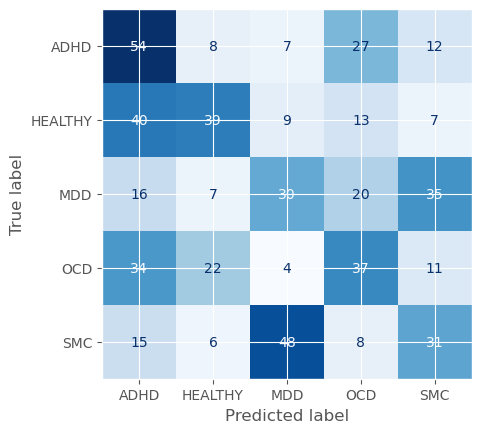

In [84]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_wo_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.33856943249702454    │
│         val_loss          │     7.443387508392334     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.38      0.50      0.43        96
     HEALTHY       0.30      0.24      0.27        84
         MDD       0.35      0.31      0.33        96
         OCD       0.23      0.24      0.23        84
         SMC       0.45      0.42      0.43        84

    accuracy                           0.34       444
   macro avg       0.34      0.34      0.34       444
weighted avg       0.34      0.34      0.34       444

F1-score:
 0.33856943279333335


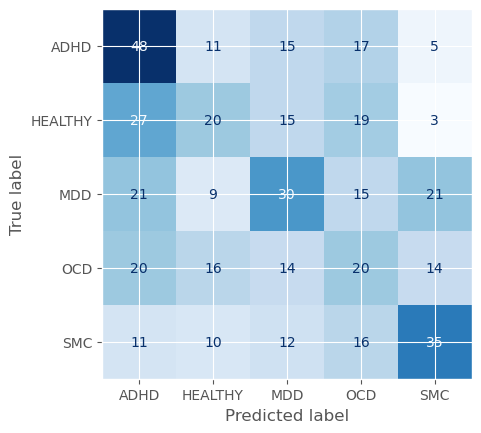

In [85]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [86]:
df_trials = pd.read_pickle('eo_results_wo_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
84,84,0.349637,2024-06-21 13:32:09.582422,2024-06-21 13:34:45.077073,0 days 00:02:35.494651,170,0.211402,1,0.001257,Adam,/home/tsmolders/lightning_logs/version_484/che...,COMPLETE
45,45,0.343093,2024-06-21 10:16:46.208188,2024-06-21 10:23:57.133363,0 days 00:07:10.925175,850,0.230539,2,0.000010,Adam,/home/tsmolders/lightning_logs/version_445/che...,COMPLETE
32,32,0.337367,2024-06-21 09:32:08.236559,2024-06-21 09:34:46.397166,0 days 00:02:38.160607,170,0.178879,1,0.000022,Adam,/home/tsmolders/lightning_logs/version_432/che...,COMPLETE
74,74,0.335890,2024-06-21 12:41:16.696343,2024-06-21 12:46:20.162740,0 days 00:05:03.466397,680,0.219055,1,0.000579,Adam,/home/tsmolders/lightning_logs/version_474/che...,COMPLETE
53,53,0.335278,2024-06-21 10:56:50.160719,2024-06-21 11:04:00.289375,0 days 00:07:10.128656,850,0.127726,1,0.000040,Adam,/home/tsmolders/lightning_logs/version_453/che...,COMPLETE
27,27,0.334982,2024-06-21 09:16:41.861723,2024-06-21 09:19:15.300187,0 days 00:02:33.438464,170,0.189615,1,0.000020,Adam,/home/tsmolders/lightning_logs/version_427/che...,COMPLETE
30,30,0.330400,2024-06-21 09:26:52.995468,2024-06-21 09:29:32.619063,0 days 00:02:39.623595,170,0.331475,2,0.000023,Adam,/home/tsmolders/lightning_logs/version_430/che...,COMPLETE
95,95,0.330338,2024-06-21 14:02:51.129955,2024-06-21 14:06:39.486672,0 days 00:03:48.356717,340,0.297941,7,0.000040,Adam,/home/tsmolders/lightning_logs/version_495/che...,COMPLETE
47,47,0.330141,2024-06-21 10:31:04.114990,2024-06-21 10:38:23.885139,0 days 00:07:19.770149,850,0.226756,2,0.000011,Adam,/home/tsmolders/lightning_logs/version_447/che...,COMPLETE
79,79,0.329615,2024-06-21 12:56:42.526631,2024-06-21 13:03:50.989024,0 days 00:07:08.462393,850,0.182664,2,0.000032,Adam,/home/tsmolders/lightning_logs/version_479/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

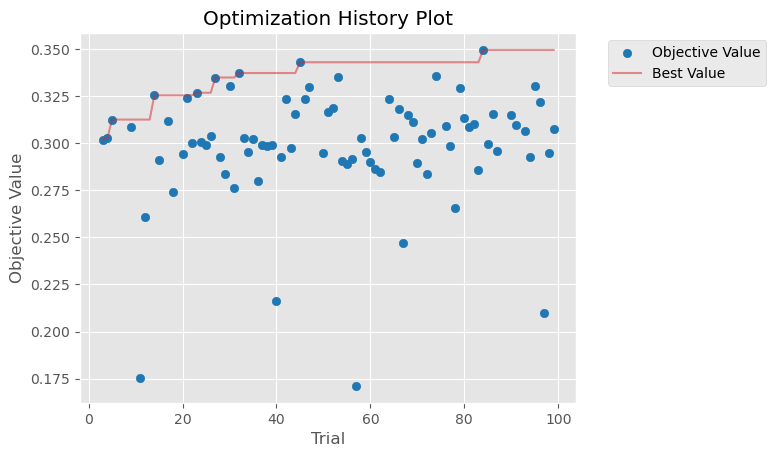

In [87]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-21 14:21:43,037] A new study created in memory with name: no-name-b856f361-4034-4be0-bf9c-1a8bc626f333
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


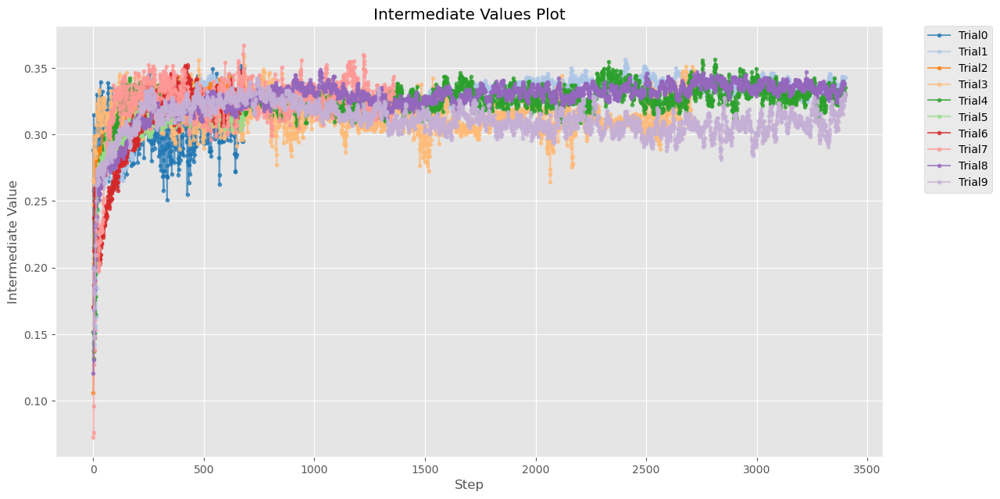

In [88]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


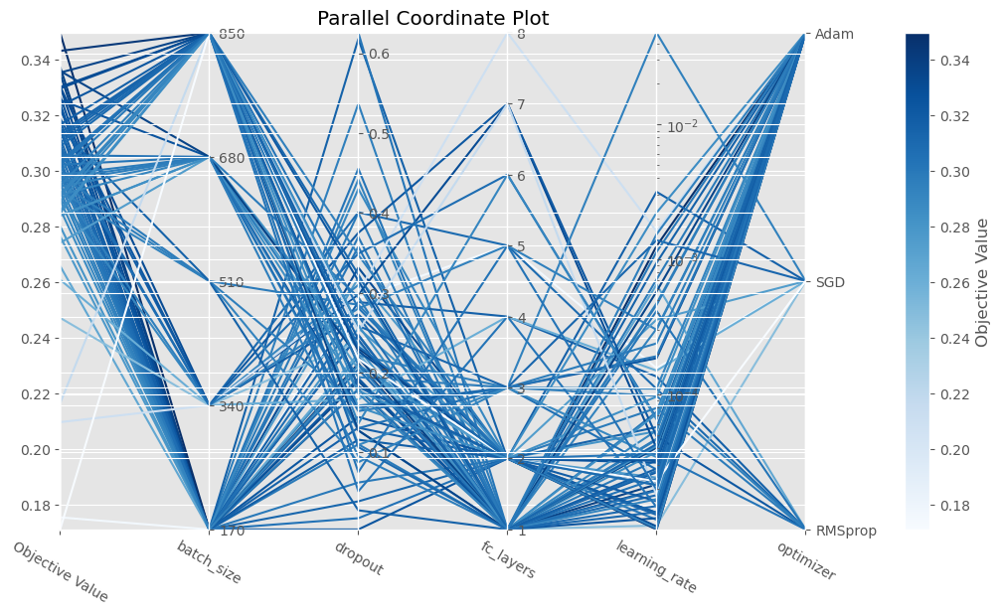

In [89]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-21 14:21:44,265] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


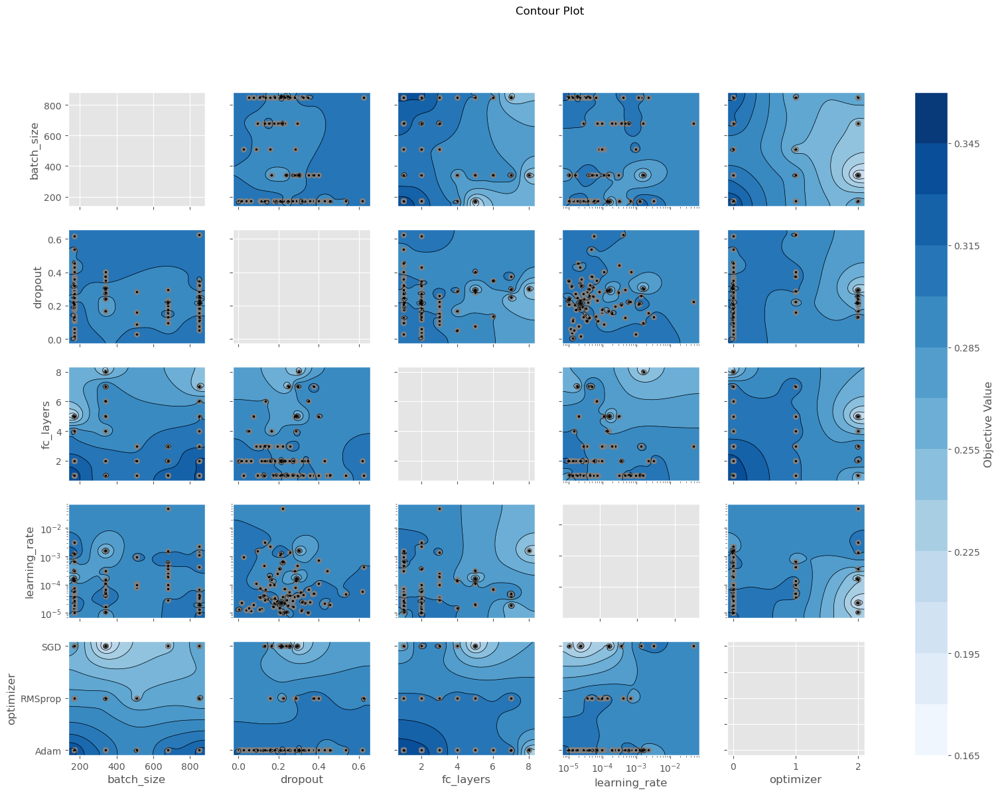

In [90]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

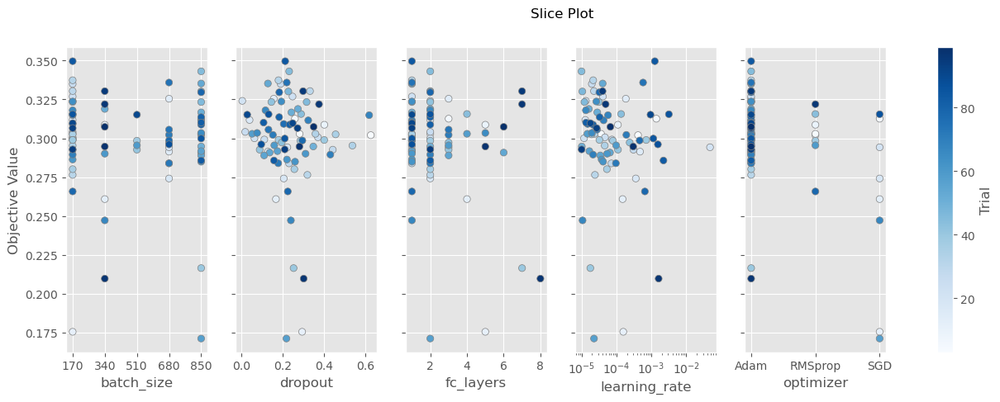

In [91]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

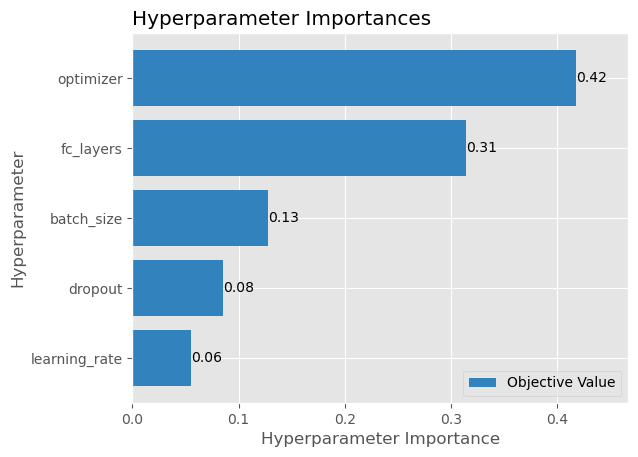

In [92]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

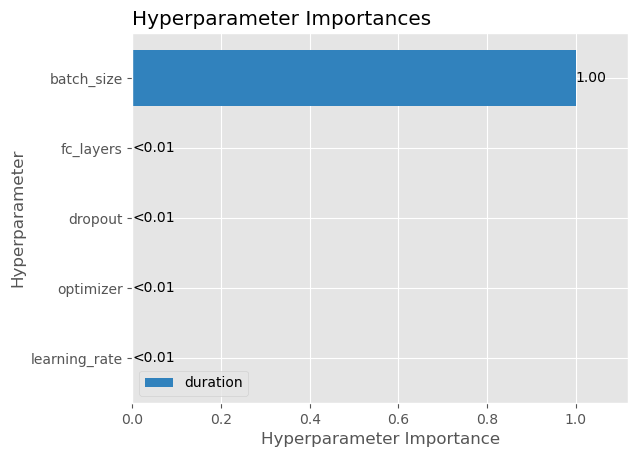

In [93]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

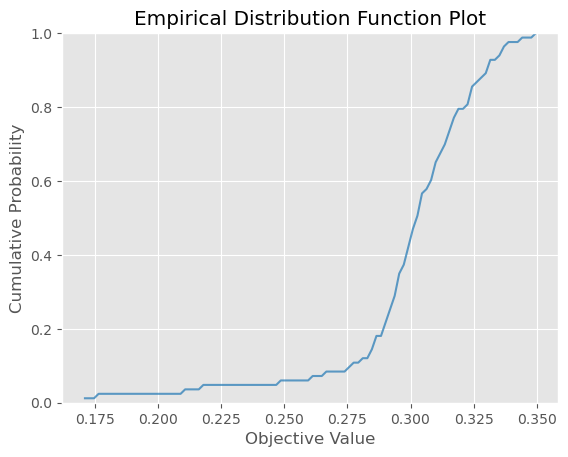

In [94]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-21 14:21:52,423] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


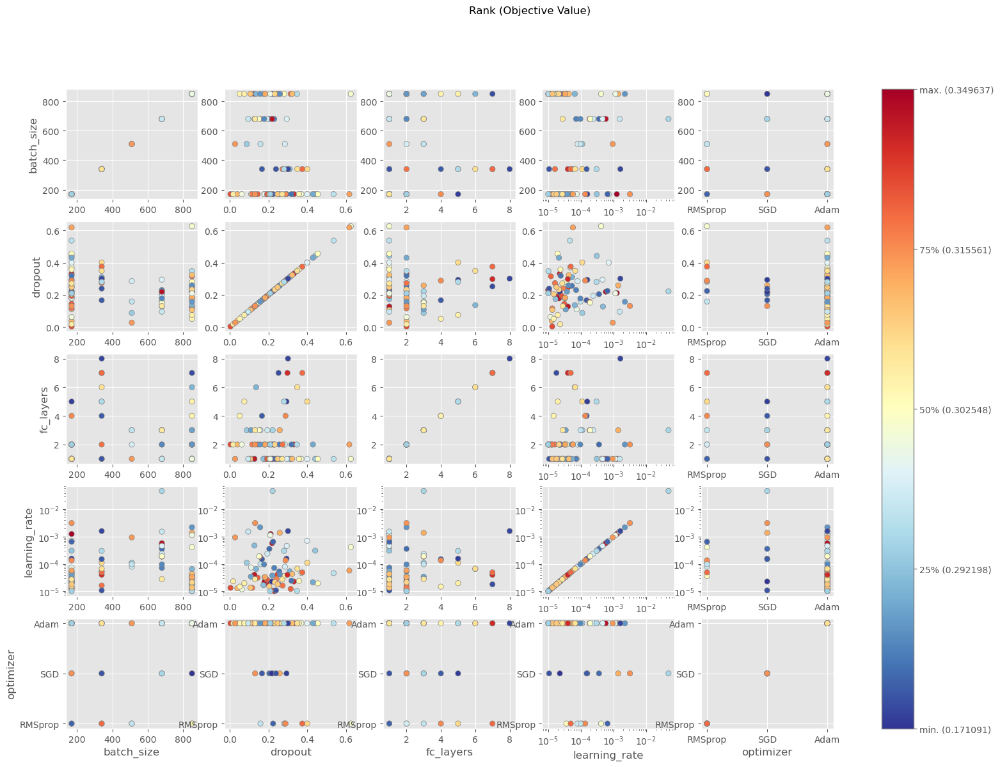

In [95]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


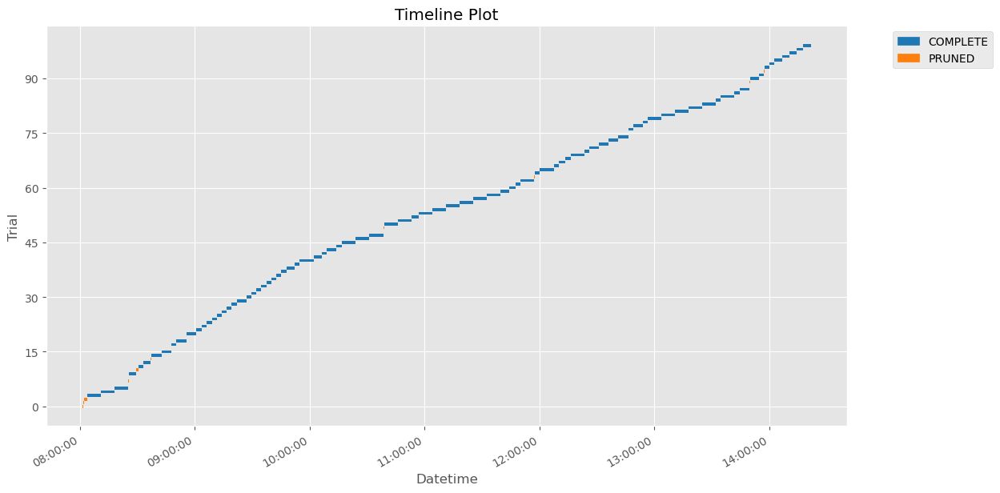

In [96]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda with edge_attr

In [97]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = graphLambda_w_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)


    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('eo_results_w_edge_attrs_trials.pkl')

[I 2024-06-21 14:21:56,584] A new study created in memory with name: no-name-3edfc133-0716-48cd-93db-f80606d29e3f
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.07696344170345755, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.0050708325080693235}


[I 2024-06-21 14:22:16,693] Trial 0 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.05763101062764486, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.118612946609794}


[I 2024-06-21 14:22:32,847] Trial 1 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.0027347350066309855, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.5895681680360368}


[I 2024-06-21 14:22:46,746] Trial 2 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008926054005311089, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.7070183960189991}


[I 2024-06-21 14:23:02,051] Trial 3 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00037848644308946506, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.5296336477361273}


[I 2024-06-21 14:23:21,317] Trial 4 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011572127782084367, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.05864809574646888}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 14:32:08,550] Trial 5 finished with value: 0.3017735779285431 and parameters: {'learning_rate': 0.00011572127782084367, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.05864809574646888}. Best is trial 5 with value: 0.3017735779285431.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005448281375200933, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.33861825614654084}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 14:36:29,165] Trial 6 finished with value: 0.2532323896884918 and parameters: {'learning_rate': 0.005448281375200933, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 5, 'dropout': 0.33861825614654084}. Best is trial 5 with value: 0.3017735779285431.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005475685638465162, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.14114113254223426}


[I 2024-06-21 14:36:45,126] Trial 7 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022405773006677577, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 3, 'dropout': 0.6226164251030079}


[I 2024-06-21 14:37:01,443] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.6786968677530096e-05, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.7634995315585456}


[I 2024-06-21 14:37:48,973] Trial 9 pruned. Trial was pruned at epoch 246.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.7622201019504243e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.37083376387625944}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 14:46:45,726] Trial 10 finished with value: 0.3152139186859131 and parameters: {'learning_rate': 1.7622201019504243e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.37083376387625944}. Best is trial 10 with value: 0.3152139186859131.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.1754209246035729e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.36428920711724}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 14:55:46,631] Trial 11 finished with value: 0.3136407732963562 and parameters: {'learning_rate': 1.1754209246035729e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.36428920711724}. Best is trial 10 with value: 0.3152139186859131.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.164546275895048e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.34474820753760854}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 15:04:43,831] Trial 12 finished with value: 0.2237185686826706 and parameters: {'learning_rate': 1.164546275895048e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.34474820753760854}. Best is trial 10 with value: 0.3152139186859131.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.7447934451954076e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.44086750071568204}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 15:13:37,148] Trial 13 finished with value: 0.3198778033256531 and parameters: {'learning_rate': 5.7447934451954076e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.44086750071568204}. Best is trial 13 with value: 0.3198778033256531.


Tested parameters: {'learning_rate': 7.78589256961693e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.4838166442043807}


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
[I 2024-06-21 15:14:28,890] Trial 14 pruned. Trial was pruned at epoch 190.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001162399474774826, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.23329621886986363}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 15:23:14,199] Trial 15 finished with value: 0.30987709760665894 and parameters: {'learning_rate': 0.0001162399474774826, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.23329621886986363}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.647190545546051e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.4446677741442455}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 15:32:20,464] Trial 16 finished with value: 0.31469181180000305 and parameters: {'learning_rate': 4.647190545546051e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.4446677741442455}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002922812251100418, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2314861767056835}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 15:35:21,572] Trial 17 finished with value: 0.2906116545200348 and parameters: {'learning_rate': 0.0002922812251100418, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 1, 'dropout': 0.2314861767056835}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.223800849317207e-05, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.23904206814338172}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 15:41:33,413] Trial 18 finished with value: 0.30131351947784424 and parameters: {'learning_rate': 4.223800849317207e-05, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.23904206814338172}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00029354926192347406, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.43124197835710876}


[I 2024-06-21 15:43:06,066] Trial 19 pruned. Trial was pruned at epoch 591.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.2025132831436385e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.5834343404998472}


[I 2024-06-21 15:43:21,790] Trial 20 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.179158826107007e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.46061651473547305}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 15:52:20,051] Trial 21 finished with value: 0.29661840200424194 and parameters: {'learning_rate': 6.179158826107007e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.46061651473547305}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.4618418392450026e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.29298567223166216}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 16:01:15,852] Trial 22 finished with value: 0.21118934452533722 and parameters: {'learning_rate': 2.4618418392450026e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.29298567223166216}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002037916630773417, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.4125440541072127}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 16:10:03,758] Trial 23 finished with value: 0.31794387102127075 and parameters: {'learning_rate': 0.0002037916630773417, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.4125440541072127}. Best is trial 13 with value: 0.3198778033256531.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00016370927810985405, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5156462018646495}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 16:18:57,863] Trial 24 finished with value: 0.3320806622505188 and parameters: {'learning_rate': 0.00016370927810985405, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5156462018646495}. Best is trial 24 with value: 0.3320806622505188.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005990197454534276, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5123075337625173}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 16:27:49,439] Trial 25 finished with value: 0.2753453850746155 and parameters: {'learning_rate': 0.0005990197454534276, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5123075337625173}. Best is trial 24 with value: 0.3320806622505188.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015045052799361392, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.645701960113116}


[I 2024-06-21 16:28:15,055] Trial 26 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019242630454057794, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.42763043472706164}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 16:34:27,151] Trial 27 finished with value: 0.3160134553909302 and parameters: {'learning_rate': 0.00019242630454057794, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.42763043472706164}. Best is trial 24 with value: 0.3320806622505188.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011754142975295998, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.5540997394997517}


[I 2024-06-21 16:34:42,567] Trial 28 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02710302629790786, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.3045602421770854}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 16:43:31,910] Trial 29 finished with value: 0.22550120949745178 and parameters: {'learning_rate': 0.02710302629790786, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.3045602421770854}. Best is trial 24 with value: 0.3320806622505188.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004162285192656339, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.6798858676986583}


[I 2024-06-21 16:43:48,687] Trial 30 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015848108055769116, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.41088115711341533}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 16:49:59,222] Trial 31 finished with value: 0.33426278829574585 and parameters: {'learning_rate': 0.00015848108055769116, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.41088115711341533}. Best is trial 31 with value: 0.33426278829574585.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.484074777684754e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.4930874428757482}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 16:56:08,573] Trial 32 finished with value: 0.309262216091156 and parameters: {'learning_rate': 8.484074777684754e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.4930874428757482}. Best is trial 31 with value: 0.33426278829574585.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019342163931757858, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3929898449353731}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:02:20,702] Trial 33 finished with value: 0.3280937075614929 and parameters: {'learning_rate': 0.00019342163931757858, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3929898449353731}. Best is trial 31 with value: 0.33426278829574585.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000849083255310078, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.39824986195863443}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:08:26,941] Trial 34 finished with value: 0.3517566919326782 and parameters: {'learning_rate': 0.000849083255310078, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.39824986195863443}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009677112677797953, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.5584955360911363}


[I 2024-06-21 17:08:40,578] Trial 35 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006546098496143412, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.16552276494448812}


[I 2024-06-21 17:08:54,616] Trial 36 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0022544038909779094, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.3868279674086844}


[I 2024-06-21 17:09:15,604] Trial 37 pruned. Trial was pruned at epoch 147.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012895345423977152, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.29458179594799777}


[I 2024-06-21 17:09:34,643] Trial 38 pruned. Trial was pruned at epoch 144.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005105709847888437, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0371935004538696}


[I 2024-06-21 17:09:48,630] Trial 39 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005273293162399585, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.522376985966162}


[I 2024-06-21 17:10:02,060] Trial 40 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00022063780680140548, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3989603936084395}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:16:13,322] Trial 41 finished with value: 0.30952534079551697 and parameters: {'learning_rate': 0.00022063780680140548, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3989603936084395}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.268998321167572e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.455959266837734}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 17:21:39,544] Trial 42 finished with value: 0.3194367289543152 and parameters: {'learning_rate': 4.268998321167572e-05, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.455959266837734}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011640382365802372, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.3130513756284353}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 17:26:01,586] Trial 43 finished with value: 0.31934916973114014 and parameters: {'learning_rate': 0.00011640382365802372, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.3130513756284353}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003662828768832425, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.48120947916320234}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:32:13,324] Trial 44 finished with value: 0.34172141551971436 and parameters: {'learning_rate': 0.0003662828768832425, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.48120947916320234}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00032718251919488205, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4828408933502879}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:38:31,279] Trial 45 finished with value: 0.3479013442993164 and parameters: {'learning_rate': 0.00032718251919488205, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4828408933502879}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0016411309193483565, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.5969168248234809}


[I 2024-06-21 17:38:45,942] Trial 46 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003864405834761354, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.49013580308795174}


[I 2024-06-21 17:39:01,038] Trial 47 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007115125132317217, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.3399927979435572}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 17:43:16,122] Trial 48 finished with value: 0.2940642833709717 and parameters: {'learning_rate': 0.0007115125132317217, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.3399927979435572}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0036089368772805014, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.7862773378669581}


[I 2024-06-21 17:43:33,869] Trial 49 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012049111480100069, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.5369071883641008}


[I 2024-06-21 17:43:49,186] Trial 50 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000271744433115732, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3635108357499414}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:50:00,067] Trial 51 finished with value: 0.3081778883934021 and parameters: {'learning_rate': 0.000271744433115732, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.3635108357499414}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015310306675156925, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.46853431865927375}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 17:56:10,793] Trial 52 finished with value: 0.28754380345344543 and parameters: {'learning_rate': 0.00015310306675156925, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.46853431865927375}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00043744989195202154, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.4023945391686118}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:02:21,216] Trial 53 finished with value: 0.263799786567688 and parameters: {'learning_rate': 0.00043744989195202154, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.4023945391686118}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.37250651988105e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.5105430057805058}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:08:34,258] Trial 54 finished with value: 0.29424023628234863 and parameters: {'learning_rate': 9.37250651988105e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.5105430057805058}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008505039530981413, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.5818335036970057}


[I 2024-06-21 18:09:00,115] Trial 55 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09364099458221052, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.37596681234477103}


[I 2024-06-21 18:09:14,086] Trial 56 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00029562049423561057, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.42362448807285896}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:15:35,474] Trial 57 finished with value: 0.34005385637283325 and parameters: {'learning_rate': 0.00029562049423561057, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.42362448807285896}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002842256530941869, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.2676130435327225}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 18:19:56,009] Trial 58 finished with value: 0.3222618103027344 and parameters: {'learning_rate': 0.0002842256530941869, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.2676130435327225}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001606896345941692, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.43019722682798883}


[I 2024-06-21 18:20:12,095] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00013897415931813238, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.6378463251511617}


[I 2024-06-21 18:20:26,151] Trial 60 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00020928824139710607, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.47384467747772774}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:26:39,739] Trial 61 finished with value: 0.3186826705932617 and parameters: {'learning_rate': 0.00020928824139710607, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.47384467747772774}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00033671933830015734, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.3541201790602392}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:32:48,033] Trial 62 finished with value: 0.32642683386802673 and parameters: {'learning_rate': 0.00033671933830015734, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.3541201790602392}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.333222930616123e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4181486868891422}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:39:07,407] Trial 63 finished with value: 0.30465227365493774 and parameters: {'learning_rate': 6.333222930616123e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4181486868891422}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015182532295265102, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.32515489531344477}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:45:16,788] Trial 64 finished with value: 0.200375035405159 and parameters: {'learning_rate': 0.00015182532295265102, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.32515489531344477}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004887038257739063, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.4503186760423664}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 18:48:19,582] Trial 65 finished with value: 0.26537200808525085 and parameters: {'learning_rate': 0.0004887038257739063, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.4503186760423664}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010950009016855333, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.5389462795103747}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 18:54:37,457] Trial 66 finished with value: 0.32928186655044556 and parameters: {'learning_rate': 0.00010950009016855333, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.5389462795103747}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010955380392597074, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.536977111018262}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:00:52,631] Trial 67 finished with value: 0.3153897523880005 and parameters: {'learning_rate': 0.00010955380392597074, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.536977111018262}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007488228354452375, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.49831204954428254}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:07:01,175] Trial 68 finished with value: 0.3280748426914215 and parameters: {'learning_rate': 0.0007488228354452375, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.49831204954428254}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.186932945616934e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.5759462763598053}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:13:25,317] Trial 69 finished with value: 0.31075984239578247 and parameters: {'learning_rate': 7.186932945616934e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.5759462763598053}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.9645863726004345e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.6002282795113991}


[I 2024-06-21 19:13:44,130] Trial 70 pruned. Trial was pruned at epoch 123.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002560599892616327, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4073574643123407}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:19:53,532] Trial 71 finished with value: 0.3075217306613922 and parameters: {'learning_rate': 0.0002560599892616327, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4073574643123407}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001647388686646547, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.43725380977785483}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:26:03,280] Trial 72 finished with value: 0.3155398964881897 and parameters: {'learning_rate': 0.0001647388686646547, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.43725380977785483}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00035349782795439155, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.47559215322662524}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:32:26,972] Trial 73 finished with value: 0.3348221480846405 and parameters: {'learning_rate': 0.00035349782795439155, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.47559215322662524}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00039380291786751816, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.5564717581077232}


[I 2024-06-21 19:33:04,843] Trial 74 pruned. Trial was pruned at epoch 274.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00059368699090389, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.464684951201582}


[I 2024-06-21 19:34:51,459] Trial 75 pruned. Trial was pruned at epoch 415.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003267890664100923, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.512237032449699}


[I 2024-06-21 19:36:51,141] Trial 76 pruned. Trial was pruned at epoch 891.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0011088273361137908, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.4873004020809983}


[I 2024-06-21 19:37:08,733] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.506746054199292e-05, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5307982013719255}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 19:45:55,550] Trial 78 finished with value: 0.2874864637851715 and parameters: {'learning_rate': 9.506746054199292e-05, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.5307982013719255}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.3776284869770156e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 4, 'dropout': 0.6174725000297641}


[I 2024-06-21 19:46:14,547] Trial 79 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002501494480282652, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.44394224163430296}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:52:26,242] Trial 80 finished with value: 0.29609379172325134 and parameters: {'learning_rate': 0.0002501494480282652, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.44394224163430296}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00020873501755823054, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.38516338407182327}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 19:58:40,303] Trial 81 finished with value: 0.33506837487220764 and parameters: {'learning_rate': 0.00020873501755823054, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.38516338407182327}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011911788908397191, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.38398478880634707}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:04:54,825] Trial 82 finished with value: 0.31956005096435547 and parameters: {'learning_rate': 0.00011911788908397191, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.38398478880634707}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001839544629250867, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4794646073870892}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:11:07,570] Trial 83 finished with value: 0.31359270215034485 and parameters: {'learning_rate': 0.0001839544629250867, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4794646073870892}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005019661015223743, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.42294973853645546}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:17:18,018] Trial 84 finished with value: 0.3393646478652954 and parameters: {'learning_rate': 0.0005019661015223743, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.42294973853645546}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000559584304556632, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.4170732125577067}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:23:28,617] Trial 85 finished with value: 0.3246133327484131 and parameters: {'learning_rate': 0.000559584304556632, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.4170732125577067}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004606920132380431, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.36605719731577213}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 20:32:36,346] Trial 86 finished with value: 0.3360256850719452 and parameters: {'learning_rate': 0.0004606920132380431, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.36605719731577213}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008136197221013668, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.33218940812521636}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:38:45,239] Trial 87 finished with value: 0.3108724057674408 and parameters: {'learning_rate': 0.0008136197221013668, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.33218940812521636}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00048141513489870203, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.36830918436177473}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 20:47:30,680] Trial 88 finished with value: 0.29913100600242615 and parameters: {'learning_rate': 0.00048141513489870203, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.36830918436177473}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014911110455184504, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.2796025389762283}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 20:53:40,933] Trial 89 finished with value: 0.27700167894363403 and parameters: {'learning_rate': 0.0014911110455184504, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.2796025389762283}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00036646001392204774, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.3954037716308676}


[I 2024-06-21 20:53:54,596] Trial 90 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00023216096596869295, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.43184385627227423}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:02:41,456] Trial 91 finished with value: 0.33075013756752014 and parameters: {'learning_rate': 0.00023216096596869295, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.43184385627227423}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003235922442110711, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3502979335542983}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:11:35,542] Trial 92 finished with value: 0.2935059666633606 and parameters: {'learning_rate': 0.0003235922442110711, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3502979335542983}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009224724706780361, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.45498596431310034}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:20:18,238] Trial 93 finished with value: 0.3379504680633545 and parameters: {'learning_rate': 0.0009224724706780361, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.45498596431310034}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0020780489866949223, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.45937698866280974}


[I 2024-06-21 21:20:34,241] Trial 94 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008870321103645077, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.37623837973217666}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 21:26:46,012] Trial 95 finished with value: 0.35082903504371643 and parameters: {'learning_rate': 0.0008870321103645077, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.37623837973217666}. Best is trial 34 with value: 0.3517566919326782.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009112771427375072, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3809237254533561}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:35:31,918] Trial 96 finished with value: 0.3523217439651489 and parameters: {'learning_rate': 0.0009112771427375072, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3809237254533561}. Best is trial 96 with value: 0.3523217439651489.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0010214606911154139, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3183376872727446}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:44:15,233] Trial 97 finished with value: 0.3275528848171234 and parameters: {'learning_rate': 0.0010214606911154139, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3183376872727446}. Best is trial 96 with value: 0.3523217439651489.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007475135767847604, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.3804357397681001}


[I 2024-06-21 21:44:30,587] Trial 98 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002023289108662682, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3498070530324906}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 21:53:22,992] Trial 99 finished with value: 0.3499653935432434 and parameters: {'learning_rate': 0.002023289108662682, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3498070530324906}. Best is trial 96 with value: 0.3523217439651489.


Best trial:
  Value: 0.3523217439651489
  Params: 
    learning_rate: 0.0009112771427375072
    optimizer: Adam
    batch_size: 850
    fc_layers: 5
    dropout: 0.3809237254533561


In [98]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_596/checkpoints/epoch=204-train_loss=0.65-train_f1=0.72-val_loss=4.53-val_f1=0.38.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.0009112771427375072, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3809237254533561}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.37507960200309753    │
│         val_loss          │     4.527434825897217     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.53      0.50      0.51       108
     HEALTHY       0.44      0.43      0.43       108
         MDD       0.25      0.24      0.25       108
         OCD       0.39      0.41      0.40       108
         SMC       0.28      0.30      0.29       108

    accuracy                           0.37       540
   macro avg       0.38      0.37      0.38       540
weighted avg       0.38      0.37      0.38       540

F1-score: 0.37507958934918023


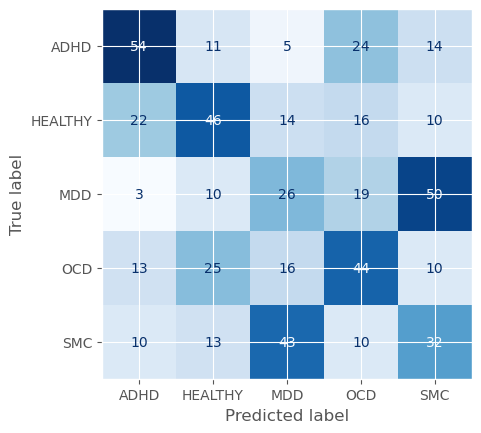

In [99]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_w_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.32891374826431274    │
│         val_loss          │     3.97210693359375      │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.46      0.48      0.47        96
     HEALTHY       0.27      0.21      0.24        84
         MDD       0.32      0.30      0.31        96
         OCD       0.24      0.30      0.27        84
         SMC       0.37      0.36      0.36        84

    accuracy                           0.33       444
   macro avg       0.33      0.33      0.33       444
weighted avg       0.33      0.33      0.33       444

F1-score:
 0.3289137467781319


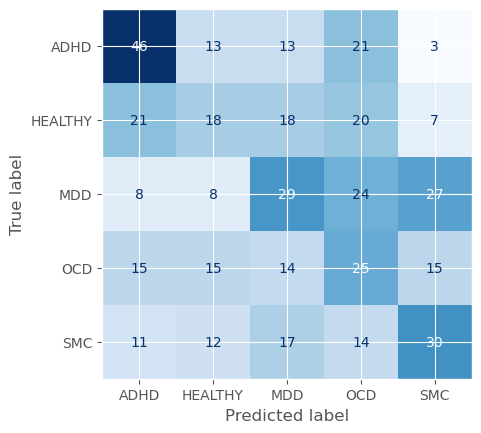

In [100]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [101]:
df_trials = pd.read_pickle('eo_results_w_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
96,96,0.352322,2024-06-21 21:26:46.013236,2024-06-21 21:35:31.914967,0 days 00:08:45.901731,850,0.380924,5,0.000911,Adam,/home/tsmolders/lightning_logs/version_596/che...,COMPLETE
34,34,0.351757,2024-06-21 17:02:20.703467,2024-06-21 17:08:26.938042,0 days 00:06:06.234575,680,0.398250,4,0.000849,Adam,/home/tsmolders/lightning_logs/version_534/che...,COMPLETE
95,95,0.350829,2024-06-21 21:20:34.241777,2024-06-21 21:26:46.009616,0 days 00:06:11.767839,680,0.376238,5,0.000887,Adam,/home/tsmolders/lightning_logs/version_595/che...,COMPLETE
99,99,0.349965,2024-06-21 21:44:30.589091,2024-06-21 21:53:22.989095,0 days 00:08:52.400004,850,0.349807,5,0.002023,Adam,/home/tsmolders/lightning_logs/version_599/che...,COMPLETE
45,45,0.347901,2024-06-21 17:32:13.325434,2024-06-21 17:38:31.276204,0 days 00:06:17.950770,680,0.482841,6,0.000327,Adam,/home/tsmolders/lightning_logs/version_545/che...,COMPLETE
44,44,0.341721,2024-06-21 17:26:01.587374,2024-06-21 17:32:13.321596,0 days 00:06:11.734222,680,0.481209,6,0.000366,Adam,/home/tsmolders/lightning_logs/version_544/che...,COMPLETE
57,57,0.340054,2024-06-21 18:09:14.089862,2024-06-21 18:15:35.471717,0 days 00:06:21.381855,680,0.423624,7,0.000296,RMSprop,/home/tsmolders/lightning_logs/version_557/che...,COMPLETE
84,84,0.339365,2024-06-21 20:11:07.570771,2024-06-21 20:17:18.015025,0 days 00:06:10.444254,680,0.422950,5,0.000502,Adam,/home/tsmolders/lightning_logs/version_584/che...,COMPLETE
93,93,0.337950,2024-06-21 21:11:35.543851,2024-06-21 21:20:18.234914,0 days 00:08:42.691063,850,0.454986,5,0.000922,Adam,/home/tsmolders/lightning_logs/version_593/che...,COMPLETE
86,86,0.336026,2024-06-21 20:23:28.617988,2024-06-21 20:32:36.343439,0 days 00:09:07.725451,850,0.366057,4,0.000461,Adam,/home/tsmolders/lightning_logs/version_586/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

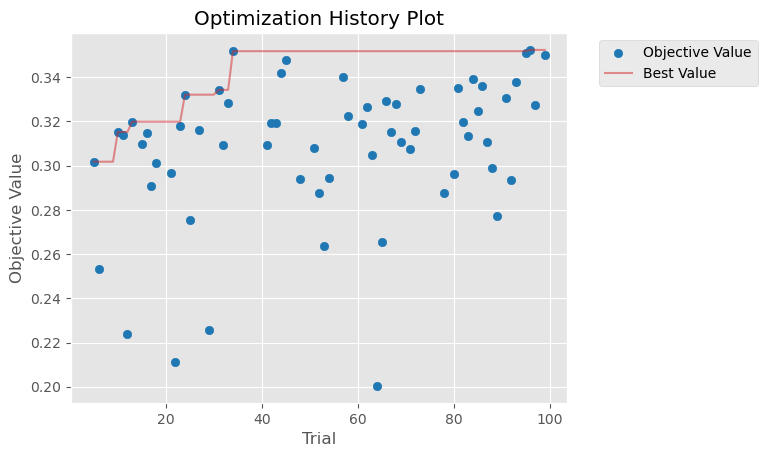

In [102]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-21 21:53:24,458] A new study created in memory with name: no-name-b3825c02-f8bd-4768-91db-c5c1616e981b
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


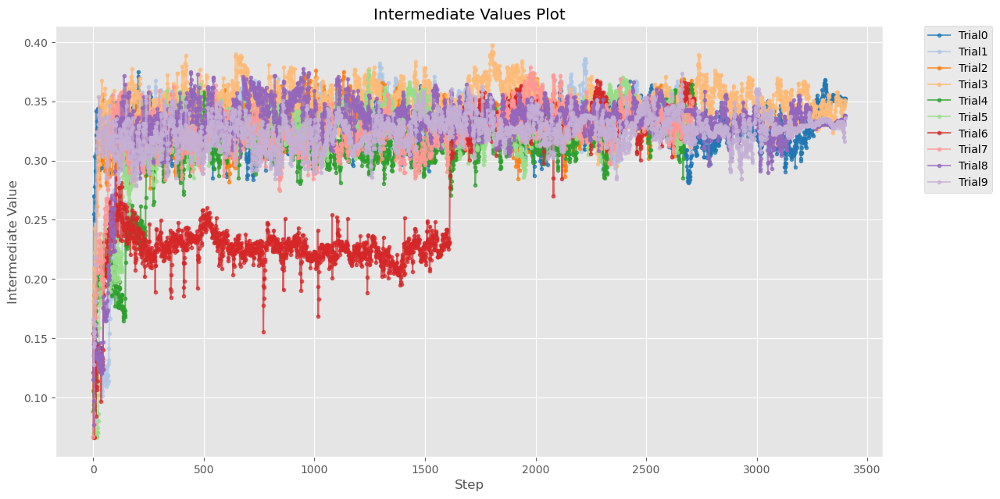

In [103]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


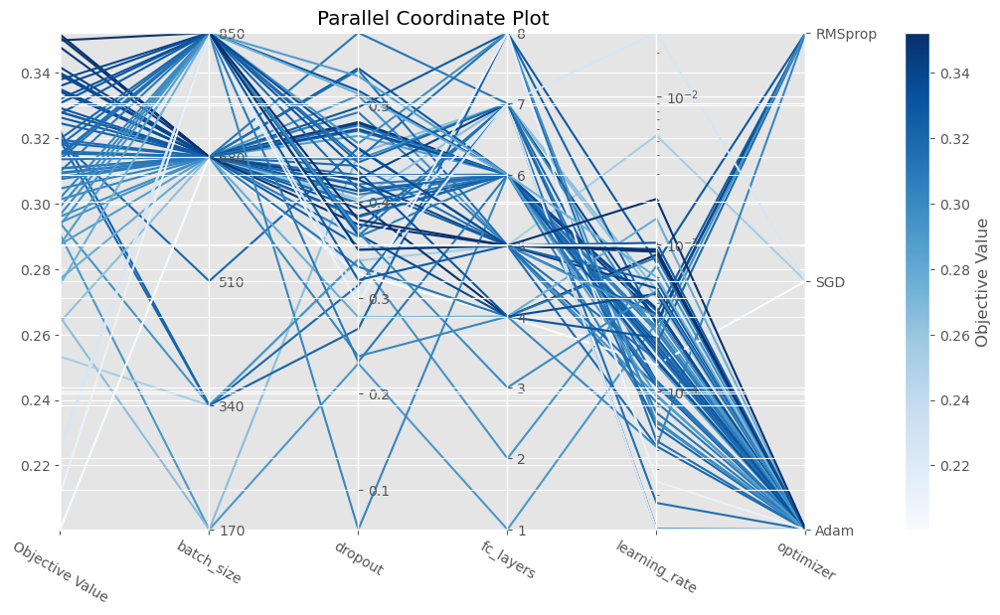

In [104]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-21 21:53:25,677] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


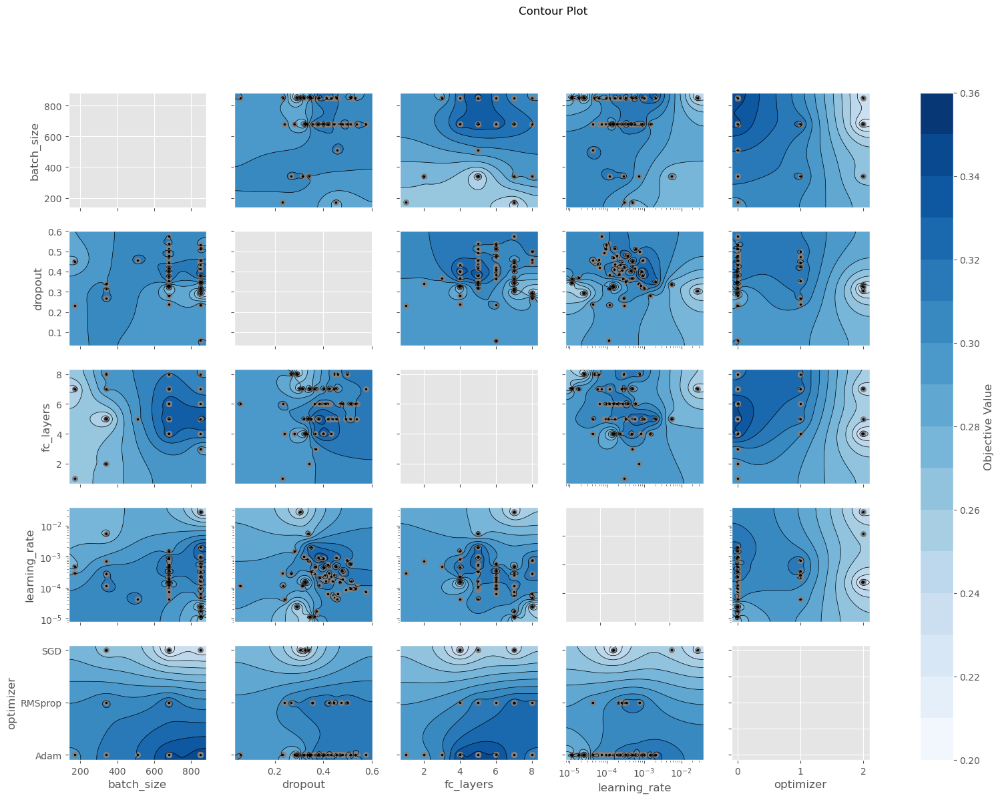

In [105]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

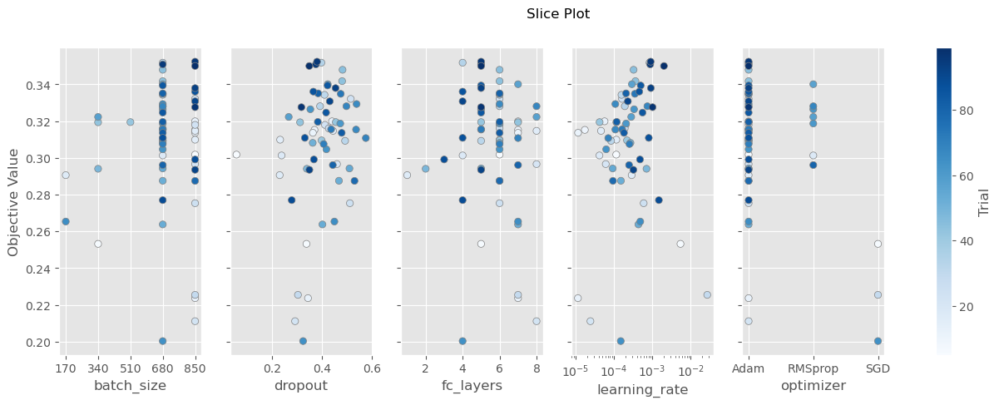

In [106]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

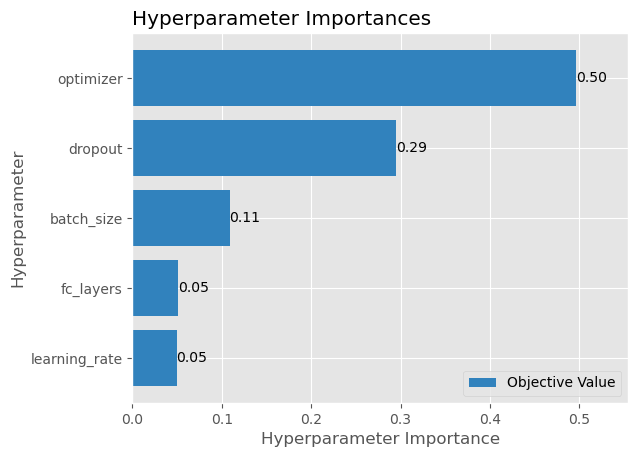

In [107]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

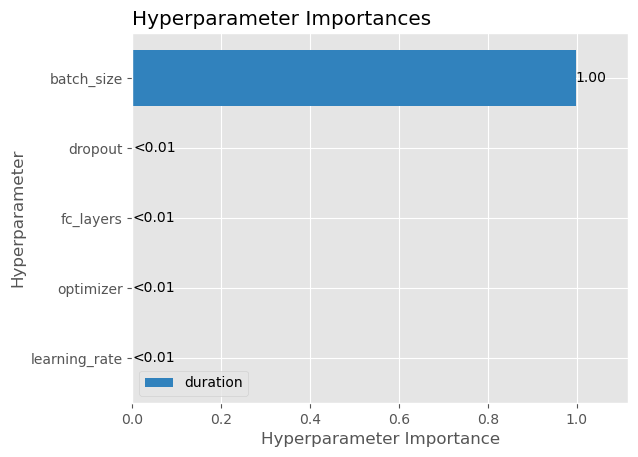

In [108]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

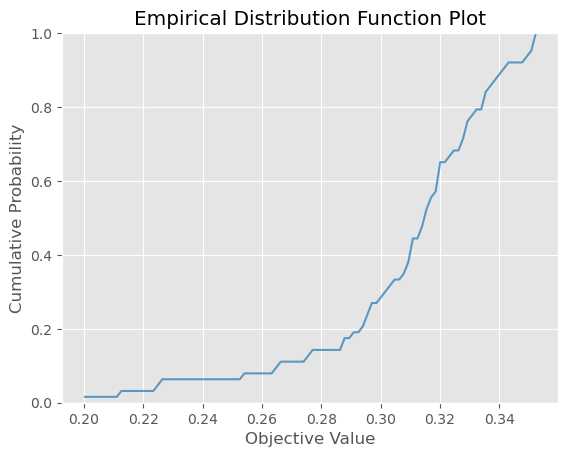

In [109]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-21 21:53:32,655] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


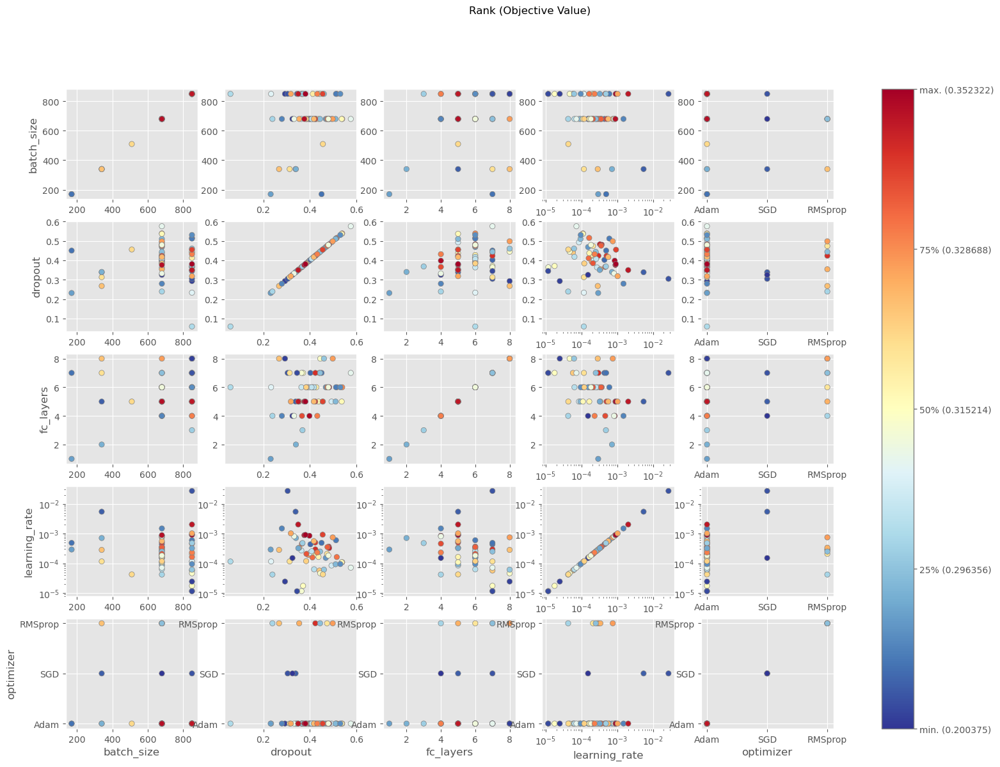

In [110]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


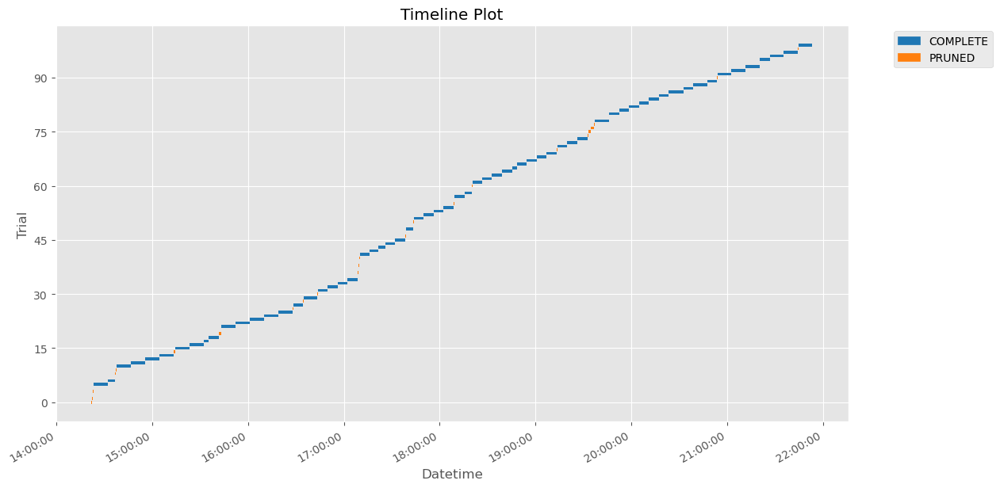

In [111]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

# 3. ratio feature set

In [112]:
from sklearn.model_selection import StratifiedGroupKFold

baseline_rest_idxs = data_split_indices['ratio'][0]
baseline_val_idxs = data_split_indices['ratio'][1]

# first splitting validation data using the first split from the baseline RF model
groups = [elem for elem in subjects_ratio_ids for i in range(12)] # times 12 for each epoch

print(f'{len(ratio_graph_dataset) = }')
print(f'{len(baseline_rest_idxs) = }, {len(baseline_val_idxs) = }, total: {len(baseline_rest_idxs)+len(baseline_val_idxs)}')

X_traintest = [ratio_graph_dataset[i] for i in baseline_rest_idxs] 
X_val = [ratio_graph_dataset[i] for i in baseline_val_idxs]
Y_traintest =[ratio_y_list[i] for i in baseline_rest_idxs]
Y_val = [ratio_y_list[i] for i in baseline_val_idxs]
groups_traintest = [groups[i] for i in baseline_rest_idxs]
groups_val = [groups[i] for i in baseline_val_idxs]

# now splitting the test and training data with seperate StratifiedGroupKFold
desired_test_ratio = 0.20
n_splits = int(1 / desired_test_ratio) # for some reason (?), n_splits also determines the proportion between train & test indices
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=False)  # should shuffle be true?

train_idxs, test_idxs = sgkf.split(X_traintest, Y_traintest, groups_traintest).__next__() # just take the first split
print(f'{len(X_traintest) = }, {len(X_val) = }')
print(f'{len(train_idxs) = }, {len(test_idxs) = }, total: {len(train_idxs)+len(test_idxs)}')

X_train = [X_traintest[i] for i in train_idxs] # X also includes y values, because they are stored in the Data object
X_test = [X_traintest[i] for i in test_idxs]
Y_train =[Y_traintest[i] for i in train_idxs]
Y_test = [Y_traintest[i] for i in test_idxs]

len(ratio_graph_dataset) = 2688
len(baseline_rest_idxs) = 2148, len(baseline_val_idxs) = 540, total: 2688
len(X_traintest) = 2148, len(X_val) = 540
len(train_idxs) = 1716, len(test_idxs) = 432, total: 2148


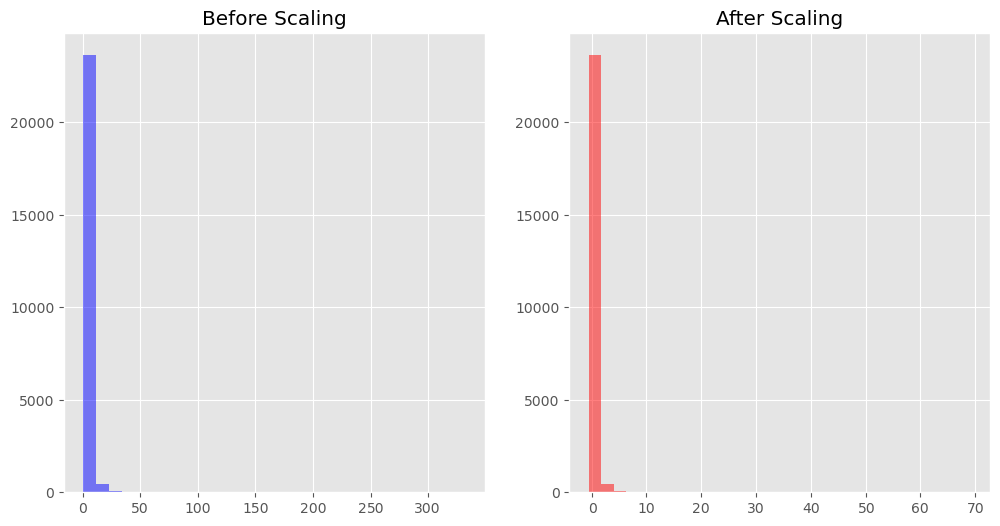

In [113]:
# standardize statistical node features
from sklearn.preprocessing import StandardScaler

# Concatenate all x values before scaling for the first feature, as a sanity check for standardization
x_before = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

scaler = StandardScaler()
scaler.fit(np.vstack([data.x.numpy() for data in X_train + X_val])) # fit on training and validation data


# Transform the x values of the data in X_train
for data in X_train:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_val
for data in X_val:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Transform the x values of the data in X_test
for data in X_test:
    data.x = torch.from_numpy(scaler.transform(data.x.numpy()))

# Concatenate all x values after scaling for the first feature, as a sanity check for standardization
x_after = np.concatenate([data.x.numpy()[:, 0] for data in X_train + X_val + X_test])

# Plot the distribution of the first x feature before and after scaling as a sanity check
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(x_before, bins=30, color='b', alpha=0.5)
plt.title('Before Scaling')

plt.subplot(1, 2, 2)
plt.hist(x_after, bins=30, color='r', alpha=0.5)
plt.title('After Scaling')

plt.show()

### Model: standard GCN

In [114]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = GCN(learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

    
    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.MedianPruner(n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ratio_results_stand_GCN_trials.pkl')

[I 2024-06-21 21:53:37,187] A new study created in memory with name: no-name-b4dc77df-c5b5-4eea-8c3d-6cb76ac9f69b
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.013245787355715593, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.6704278227232379}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 21:56:43,398] Trial 0 finished with value: 0.2403019368648529 and parameters: {'learning_rate': 0.013245787355715593, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.6704278227232379}. Best is trial 0 with value: 0.2403019368648529.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 5.0471903049445056e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.3554306428869972}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 21:59:30,320] Trial 1 finished with value: 0.2695654034614563 and parameters: {'learning_rate': 5.0471903049445056e-05, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.3554306428869972}. Best is trial 1 with value: 0.2695654034614563.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.1478111422242014e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.5469375496425302}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 22:02:43,552] Trial 2 finished with value: 0.26400917768478394 and parameters: {'learning_rate': 1.1478111422242014e-05, 'optimizer': 'Adam', 'batch_size': 680, 'dropout': 0.5469375496425302}. Best is trial 1 with value: 0.2695654034614563.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.042160408188804475, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.04447143720004174}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 22:05:02,403] Trial 3 finished with value: 0.22717809677124023 and parameters: {'learning_rate': 0.042160408188804475, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.04447143720004174}. Best is trial 1 with value: 0.2695654034614563.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007297984508663166, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.1262932320355655}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 22:08:09,588] Trial 4 finished with value: 0.22941793501377106 and parameters: {'learning_rate': 0.0007297984508663166, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.1262932320355655}. Best is trial 1 with value: 0.2695654034614563.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 6.469268202980375e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5542994321051885}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:09:39,231] Trial 5 finished with value: 0.2831759452819824 and parameters: {'learning_rate': 6.469268202980375e-05, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.5542994321051885}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006375076304807484, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.10729158880879189}


[I 2024-06-21 22:09:53,996] Trial 6 pruned. Trial was pruned at epoch 182.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006520145724501214, 'optimizer_name': 'SGD', 'batch_size': 680, 'dropout': 0.49716232925992077}


[I 2024-06-21 22:10:00,982] Trial 7 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.06337647149916449, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'dropout': 0.28697636435596036}


[I 2024-06-21 22:10:08,655] Trial 8 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0444238566015316e-05, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.5763413920750645}


[I 2024-06-21 22:10:18,577] Trial 9 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001381531481915529, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.7898757620097392}


[I 2024-06-21 22:10:31,400] Trial 10 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.004219524137175e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3079787921866835}


[I 2024-06-21 22:10:44,826] Trial 11 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.031168775482752e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.3489651546340733}


[I 2024-06-21 22:10:53,306] Trial 12 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.0372197000659815e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.43606926328695494}


[I 2024-06-21 22:11:01,383] Trial 13 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00023013610576069342, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.2273068262845604}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:12:33,434] Trial 14 finished with value: 0.2245427817106247 and parameters: {'learning_rate': 0.00023013610576069342, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.2273068262845604}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0027599516755812243, 'optimizer_name': 'SGD', 'batch_size': 850, 'dropout': 0.6833315627562625}


[I 2024-06-21 22:12:41,526] Trial 15 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.7061396430766395e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.43373336528187617}


[I 2024-06-21 22:12:54,972] Trial 16 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003454998618976881, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.2088326905927457}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 22:15:39,508] Trial 17 finished with value: 0.27930113673210144 and parameters: {'learning_rate': 0.0003454998618976881, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.2088326905927457}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003120310648245703, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.22553781068302187}


[I 2024-06-21 22:17:43,771] Trial 18 pruned. Trial was pruned at epoch 1522.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0028826373448345836, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.16483334433941005}


[I 2024-06-21 22:17:57,921] Trial 19 pruned. Trial was pruned at epoch 101.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003169511421170239, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.6333035037220298}


[I 2024-06-21 22:18:09,730] Trial 20 pruned. Trial was pruned at epoch 101.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.7395550646529135e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.3805215017722189}


[I 2024-06-21 22:18:18,311] Trial 21 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000142540218627038, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.45986035772056005}


[I 2024-06-21 22:18:27,688] Trial 22 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.5676202385371844e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.27113340701969835}


[I 2024-06-21 22:18:36,861] Trial 23 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014310293837535432, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.008918813695585226}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 22:21:29,482] Trial 24 finished with value: 0.2504565119743347 and parameters: {'learning_rate': 0.0014310293837535432, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.008918813695585226}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004776446126373573, 'optimizer_name': 'Adam', 'batch_size': 850, 'dropout': 0.36173772855750697}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 22:25:55,739] Trial 25 finished with value: 0.23033927381038666 and parameters: {'learning_rate': 0.0004776446126373573, 'optimizer': 'Adam', 'batch_size': 850, 'dropout': 0.36173772855750697}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011107953672127167, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.536584376760092}


[I 2024-06-21 22:26:10,644] Trial 26 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019260027685253655, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.22948497716500602}


[I 2024-06-21 22:26:18,959] Trial 27 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.0570436951424395e-05, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.7537123818381728}


[I 2024-06-21 22:26:26,909] Trial 28 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013541246490882623, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.6349891112061596}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:27:56,580] Trial 29 finished with value: 0.25953367352485657 and parameters: {'learning_rate': 0.0013541246490882623, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.6349891112061596}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.068536537570138e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.15045944391696883}


[I 2024-06-21 22:28:07,274] Trial 30 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0120639362063521e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.5337462719126904}


[I 2024-06-21 22:28:16,696] Trial 31 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.5131955668983395e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.6127269582641851}


[I 2024-06-21 22:28:25,124] Trial 32 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.153801290544166e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.6881724683861414}


[I 2024-06-21 22:28:32,236] Trial 33 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.7572955399272618e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.08196216210098006}


[I 2024-06-21 22:28:40,024] Trial 34 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.395688511072695e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.469508057289471}


[I 2024-06-21 22:28:47,062] Trial 35 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.009994110823582574, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'dropout': 0.5192625784089443}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-21 22:31:58,794] Trial 36 finished with value: 0.24514111876487732 and parameters: {'learning_rate': 0.009994110823582574, 'optimizer': 'RMSprop', 'batch_size': 680, 'dropout': 0.5192625784089443}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000460002639285367, 'optimizer_name': 'Adam', 'batch_size': 850, 'dropout': 0.5832053661483242}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 22:36:26,375] Trial 37 finished with value: 0.23925070464611053 and parameters: {'learning_rate': 0.000460002639285367, 'optimizer': 'Adam', 'batch_size': 850, 'dropout': 0.5832053661483242}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.8407937279984737e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.4101109339148872}


[I 2024-06-21 22:36:34,567] Trial 38 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.965104300214377e-05, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.7311677225474129}


[I 2024-06-21 22:36:44,274] Trial 39 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04088645776853611, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.31054092019307095}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:38:13,278] Trial 40 finished with value: 0.2745895981788635 and parameters: {'learning_rate': 0.04088645776853611, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.31054092019307095}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02876336909619729, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.32207591743982916}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:39:42,593] Trial 41 finished with value: 0.23624174296855927 and parameters: {'learning_rate': 0.02876336909619729, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.32207591743982916}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.036377773378449746, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.2674906019848392}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:41:12,230] Trial 42 finished with value: 0.2640737295150757 and parameters: {'learning_rate': 0.036377773378449746, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.2674906019848392}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08215528452449114, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.19019622531895292}


[I 2024-06-21 22:41:25,377] Trial 43 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02757101381112316, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.2715475738718851}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:43:03,472] Trial 44 finished with value: 0.2618436813354492 and parameters: {'learning_rate': 0.02757101381112316, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.2715475738718851}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.037944654316062906, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3293319882556728}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:44:34,806] Trial 45 finished with value: 0.24893783032894135 and parameters: {'learning_rate': 0.037944654316062906, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.3293319882556728}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.018716785907483543, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.28503427293080263}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:46:04,177] Trial 46 finished with value: 0.22526562213897705 and parameters: {'learning_rate': 0.018716785907483543, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.28503427293080263}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0047112033132211215, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3954056165795557}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:47:37,124] Trial 47 finished with value: 0.2314835637807846 and parameters: {'learning_rate': 0.0047112033132211215, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.3954056165795557}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.061702103268159746, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.10292996303034502}


[I 2024-06-21 22:47:51,761] Trial 48 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.015158463325558955, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.19680136060663578}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:49:23,953] Trial 49 finished with value: 0.2708112895488739 and parameters: {'learning_rate': 0.015158463325558955, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.19680136060663578}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.016307657144311493, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.19724415809309293}


[I 2024-06-21 22:49:32,225] Trial 50 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00953925264317416, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.24762444003308506}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:51:08,461] Trial 51 finished with value: 0.26497507095336914 and parameters: {'learning_rate': 0.00953925264317416, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.24762444003308506}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010263122964761865, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.1468026710065285}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:52:37,544] Trial 52 finished with value: 0.223491370677948 and parameters: {'learning_rate': 0.010263122964761865, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.1468026710065285}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0066382591242865425, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.23690468319465569}


[I 2024-06-21 22:52:51,896] Trial 53 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008666710807239772, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.19517747554313408}


[I 2024-06-21 22:53:05,786] Trial 54 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05398510491393507, 'optimizer_name': 'SGD', 'batch_size': 850, 'dropout': 0.31395252162570036}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-21 22:57:39,524] Trial 55 finished with value: 0.23351317644119263 and parameters: {'learning_rate': 0.05398510491393507, 'optimizer': 'SGD', 'batch_size': 850, 'dropout': 0.31395252162570036}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0026627082156838225, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.35014853055582673}


[I 2024-06-21 22:57:48,600] Trial 56 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.020033550360701674, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.1221827844844005}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 22:59:21,432] Trial 57 finished with value: 0.2295447289943695 and parameters: {'learning_rate': 0.020033550360701674, 'optimizer': 'SGD', 'batch_size': 170, 'dropout': 0.1221827844844005}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004397680956553182, 'optimizer_name': 'SGD', 'batch_size': 510, 'dropout': 0.370783673730805}


[I 2024-06-21 22:59:29,464] Trial 58 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010898910305242027, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.06949428343351566}


[I 2024-06-21 22:59:42,232] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011319387094114916, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.23846250608157946}


[I 2024-06-21 22:59:51,997] Trial 60 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08994707283451409, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.26482105002350737}


[I 2024-06-21 23:00:05,040] Trial 61 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.034738438401743246, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3009773763262087}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:01:36,520] Trial 62 finished with value: 0.25126713514328003 and parameters: {'learning_rate': 0.034738438401743246, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.3009773763262087}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00750659062575666, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.25630318234885313}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:03:05,093] Trial 63 finished with value: 0.2570192217826843 and parameters: {'learning_rate': 0.00750659062575666, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.25630318234885313}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.024256988920538115, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.203561983522531}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:04:39,051] Trial 64 finished with value: 0.25569626688957214 and parameters: {'learning_rate': 0.024256988920538115, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.203561983522531}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.047274483672951215, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.4242545374923492}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 23:07:26,938] Trial 65 finished with value: 0.24758891761302948 and parameters: {'learning_rate': 0.047274483672951215, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.4242545374923492}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.013367082117290909, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.16936483566692628}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:08:55,086] Trial 66 finished with value: 0.2368384152650833 and parameters: {'learning_rate': 0.013367082117290909, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.16936483566692628}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002905587822097617, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'dropout': 0.34476775877940025}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 23:11:47,892] Trial 67 finished with value: 0.2544984221458435 and parameters: {'learning_rate': 0.0002905587822097617, 'optimizer': 'RMSprop', 'batch_size': 510, 'dropout': 0.34476775877940025}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0017123519931890006, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.4778022160249685}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:13:17,600] Trial 68 finished with value: 0.23946668207645416 and parameters: {'learning_rate': 0.0017123519931890006, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.4778022160249685}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.8654782538845752e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'dropout': 0.3005390321405456}


[I 2024-06-21 23:13:27,912] Trial 69 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00016980311298520623, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.3822780541178369}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:15:02,856] Trial 70 finished with value: 0.2542816400527954 and parameters: {'learning_rate': 0.00016980311298520623, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.3822780541178369}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.787246621237584e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.5612310750053434}


[I 2024-06-21 23:15:10,002] Trial 71 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.5898612965977738e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.2155653030112899}


[I 2024-06-21 23:15:17,940] Trial 72 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006197863982096549, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.25124533701151625}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 23:18:06,008] Trial 73 finished with value: 0.213638037443161 and parameters: {'learning_rate': 0.0006197863982096549, 'optimizer': 'Adam', 'batch_size': 510, 'dropout': 0.25124533701151625}. Best is trial 5 with value: 0.2831759452819824.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.330392250084059e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.44644917622403596}


[I 2024-06-21 23:18:13,918] Trial 74 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0733650635858042, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.2874939489257894}


[I 2024-06-21 23:18:24,400] Trial 75 pruned. Trial was pruned at epoch 101.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3689251267410337e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.4923499786573979}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:19:52,778] Trial 76 finished with value: 0.29984885454177856 and parameters: {'learning_rate': 1.3689251267410337e-05, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.4923499786573979}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3261855831943046e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5049869835624564}


[I 2024-06-21 23:20:06,086] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04358477959837137, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.6172267515419649}


[I 2024-06-21 23:20:19,395] Trial 78 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010913326024838675, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'dropout': 0.1633610700627185}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:21:50,597] Trial 79 finished with value: 0.2383705973625183 and parameters: {'learning_rate': 0.00010913326024838675, 'optimizer': 'RMSprop', 'batch_size': 170, 'dropout': 0.1633610700627185}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0338403270548703, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.41864295113180655}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-21 23:23:22,533] Trial 80 finished with value: 0.23622015118598938 and parameters: {'learning_rate': 0.0338403270548703, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.41864295113180655}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.1684856517951484e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.5552216006638632}


[I 2024-06-21 23:23:31,305] Trial 81 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.3472743350914018e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5828907629166273}


[I 2024-06-21 23:23:44,936] Trial 82 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.675246509641548e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'dropout': 0.5341332322932308}


[I 2024-06-21 23:23:52,033] Trial 83 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.5623765379318757e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.5051404128838106}


[I 2024-06-21 23:24:06,340] Trial 84 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004078325214096238, 'optimizer_name': 'SGD', 'batch_size': 850, 'dropout': 0.33536747085793467}


[I 2024-06-21 23:24:15,004] Trial 85 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.934962058899053e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'dropout': 0.5992889804181107}


[I 2024-06-21 23:24:25,417] Trial 86 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.964591810570821e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.6473970365794314}


[I 2024-06-21 23:24:39,371] Trial 87 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002224368518574983, 'optimizer_name': 'SGD', 'batch_size': 170, 'dropout': 0.49007779368626586}


[I 2024-06-21 23:24:52,185] Trial 88 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.037260236669599e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'dropout': 0.17889176216545333}


[I 2024-06-21 23:25:05,589] Trial 89 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.016019810257948748, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.4502200863097568}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:27:21,584] Trial 90 finished with value: 0.27919164299964905 and parameters: {'learning_rate': 0.016019810257948748, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.4502200863097568}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01574809184315685, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.4553046643725425}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:29:41,268] Trial 91 finished with value: 0.2716978192329407 and parameters: {'learning_rate': 0.01574809184315685, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.4553046643725425}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0154747980650432, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.4450498246603936}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:31:54,526] Trial 92 finished with value: 0.24104760587215424 and parameters: {'learning_rate': 0.0154747980650432, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.4450498246603936}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008427859641862559, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.40010692879741183}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:34:10,107] Trial 93 finished with value: 0.23980745673179626 and parameters: {'learning_rate': 0.008427859641862559, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.40010692879741183}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02111870013624952, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.458951340405133}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:36:25,831] Trial 94 finished with value: 0.24184103310108185 and parameters: {'learning_rate': 0.02111870013624952, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.458951340405133}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005531463283947197, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.21888561156144218}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:38:44,272] Trial 95 finished with value: 0.197089284658432 and parameters: {'learning_rate': 0.005531463283947197, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.21888561156144218}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.027063114336934303, 'optimizer_name': 'SGD', 'batch_size': 340, 'dropout': 0.4816222438676379}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:40:56,640] Trial 96 finished with value: 0.23773446679115295 and parameters: {'learning_rate': 0.027063114336934303, 'optimizer': 'SGD', 'batch_size': 340, 'dropout': 0.4816222438676379}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014250628754638988, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.5185104011436569}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:43:13,034] Trial 97 finished with value: 0.2637802064418793 and parameters: {'learning_rate': 0.014250628754638988, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.5185104011436569}. Best is trial 76 with value: 0.29984885454177856.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.022801980254215766, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'dropout': 0.36301290468979086}


[I 2024-06-21 23:43:24,422] Trial 98 pruned. Trial was pruned at epoch 107.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011790679695803498, 'optimizer_name': 'Adam', 'batch_size': 340, 'dropout': 0.28569287866482024}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:45:43,907] Trial 99 finished with value: 0.26317211985588074 and parameters: {'learning_rate': 0.011790679695803498, 'optimizer': 'Adam', 'batch_size': 340, 'dropout': 0.28569287866482024}. Best is trial 76 with value: 0.29984885454177856.


Best trial:
  Value: 0.29984885454177856
  Params: 
    learning_rate: 1.3689251267410337e-05
    optimizer: Adam
    batch_size: 170
    dropout: 0.4923499786573979


In [115]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_676/checkpoints/epoch=645-train_loss=1.53-train_f1=0.28-val_loss=1.57-val_f1=0.30.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 1.3689251267410337e-05, 'optimizer': 'Adam', 'batch_size': 170, 'dropout': 0.4923499786573979}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3035129904747009     │
│         val_loss          │    1.5729490518569946     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.44      0.48      0.46       108
     HEALTHY       0.29      0.22      0.25       108
         MDD       0.22      0.27      0.24       108
         OCD       0.26      0.37      0.31       108
         SMC       0.37      0.19      0.25       108

    accuracy                           0.31       540
   macro avg       0.32      0.31      0.30       540
weighted avg       0.32      0.31      0.30       540

F1-score: 0.3035129827193096


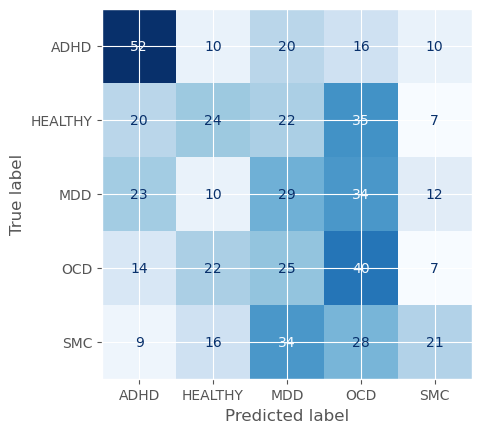

In [116]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
# Load the model directly from the checkpoint
model = GCN.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.21853959560394287    │
│         val_loss          │    1.6254090070724487     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.15      0.19      0.17        84
     HEALTHY       0.28      0.26      0.27        84
         MDD       0.25      0.29      0.27        84
         OCD       0.18      0.21      0.20        84
         SMC       0.29      0.15      0.19        96

    accuracy                           0.22       432
   macro avg       0.23      0.22      0.22       432
weighted avg       0.23      0.22      0.22       432

F1-score:
 0.21853960712062576


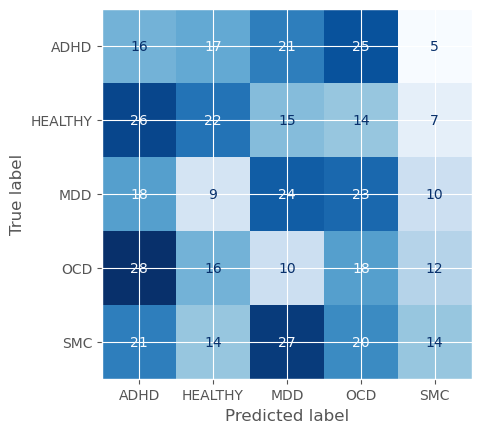

In [117]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [118]:
df_trials = pd.read_pickle('ratio_results_stand_GCN_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
76,76,0.299849,2024-06-21 23:18:24.401659,2024-06-21 23:19:52.777838,0 days 00:01:28.376179,170,0.492350,0.000014,Adam,/home/tsmolders/lightning_logs/version_676/che...,COMPLETE
5,5,0.283176,2024-06-21 22:08:09.589269,2024-06-21 22:09:39.231043,0 days 00:01:29.641774,170,0.554299,0.000065,Adam,/home/tsmolders/lightning_logs/version_605/che...,COMPLETE
17,17,0.279301,2024-06-21 22:12:54.973093,2024-06-21 22:15:39.506556,0 days 00:02:44.533463,510,0.208833,0.000345,Adam,/home/tsmolders/lightning_logs/version_617/che...,COMPLETE
90,90,0.279192,2024-06-21 23:25:05.590440,2024-06-21 23:27:21.583501,0 days 00:02:15.993061,340,0.450220,0.016020,Adam,/home/tsmolders/lightning_logs/version_690/che...,COMPLETE
40,40,0.274590,2024-06-21 22:36:44.275701,2024-06-21 22:38:13.277714,0 days 00:01:29.002013,170,0.310541,0.040886,Adam,/home/tsmolders/lightning_logs/version_640/che...,COMPLETE
91,91,0.271698,2024-06-21 23:27:21.585367,2024-06-21 23:29:41.267164,0 days 00:02:19.681797,340,0.455305,0.015748,Adam,/home/tsmolders/lightning_logs/version_691/che...,COMPLETE
49,49,0.270811,2024-06-21 22:47:51.761844,2024-06-21 22:49:23.952428,0 days 00:01:32.190584,170,0.196801,0.015158,SGD,/home/tsmolders/lightning_logs/version_649/che...,COMPLETE
1,1,0.269565,2024-06-21 21:56:43.399532,2024-06-21 21:59:30.317722,0 days 00:02:46.918190,510,0.355431,0.000050,Adam,/home/tsmolders/lightning_logs/version_601/che...,COMPLETE
51,51,0.264975,2024-06-21 22:49:32.226359,2024-06-21 22:51:08.460580,0 days 00:01:36.234221,170,0.247624,0.009539,SGD,/home/tsmolders/lightning_logs/version_651/che...,COMPLETE
42,42,0.264074,2024-06-21 22:39:42.594820,2024-06-21 22:41:12.229586,0 days 00:01:29.634766,170,0.267491,0.036378,Adam,/home/tsmolders/lightning_logs/version_642/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

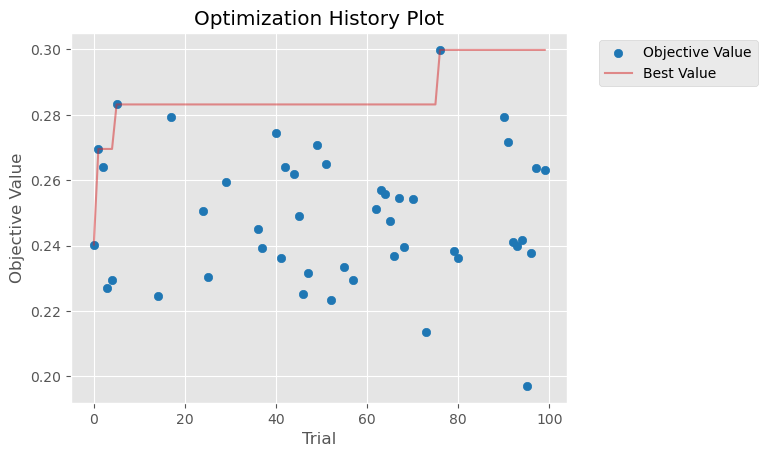

In [119]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-21 23:45:44,675] A new study created in memory with name: no-name-508903fd-c986-46ad-9dd6-4658fcf23266
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


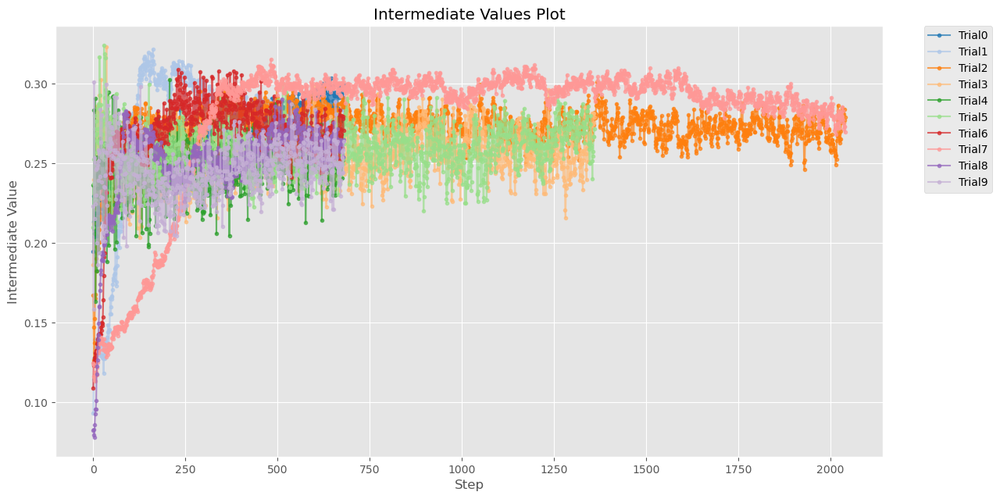

In [120]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


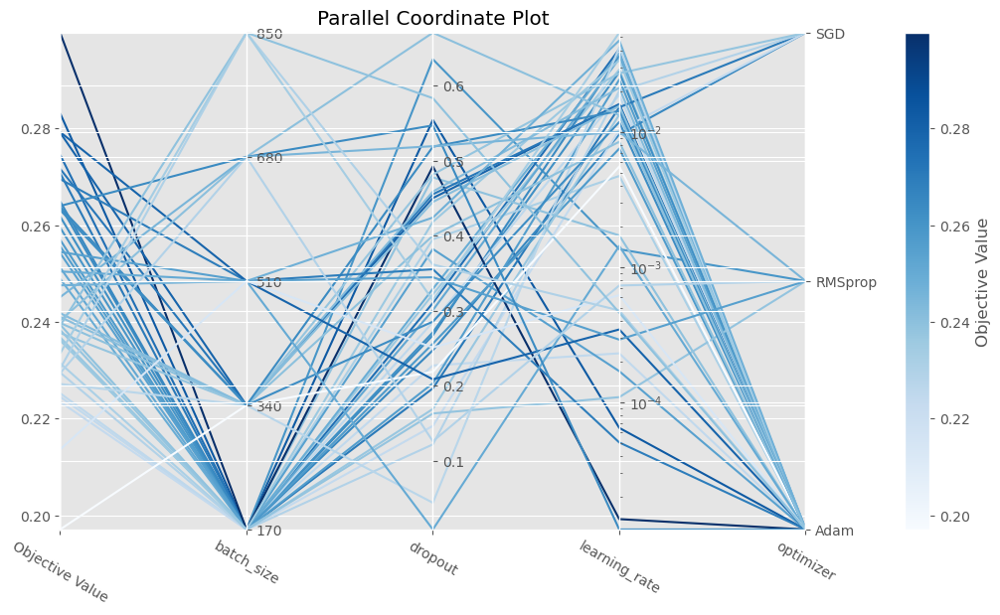

In [121]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-21 23:45:46,143] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


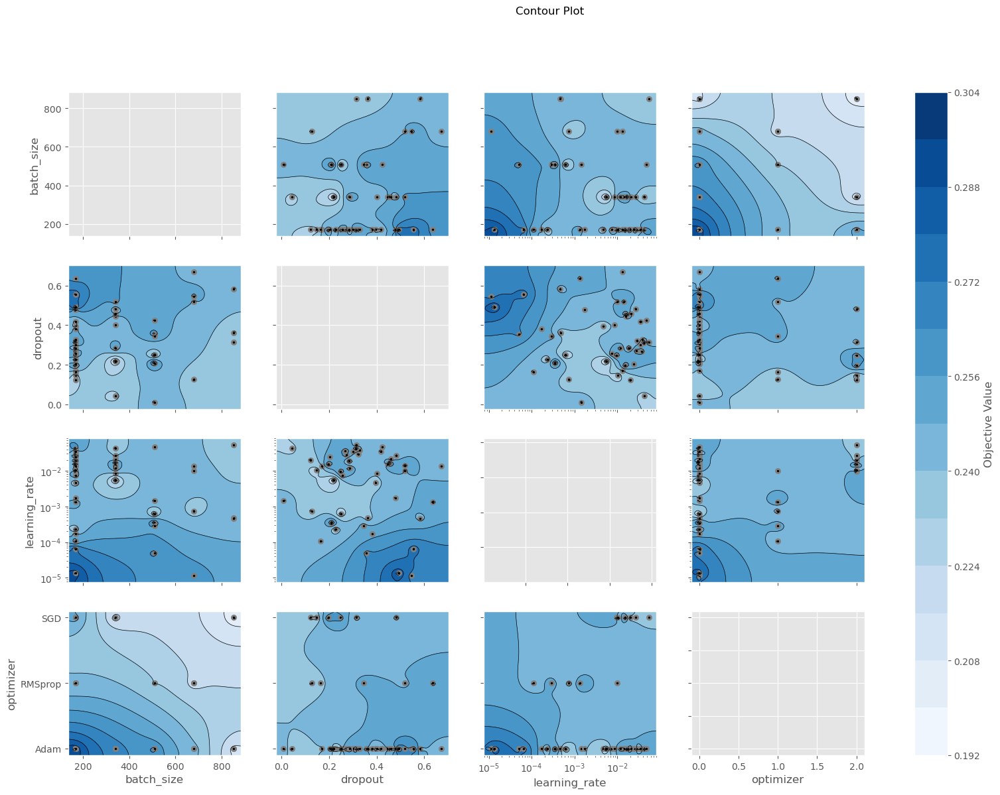

In [122]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='learning_rate'>,
       <Axes: xlabel='optimizer'>], dtype=object)

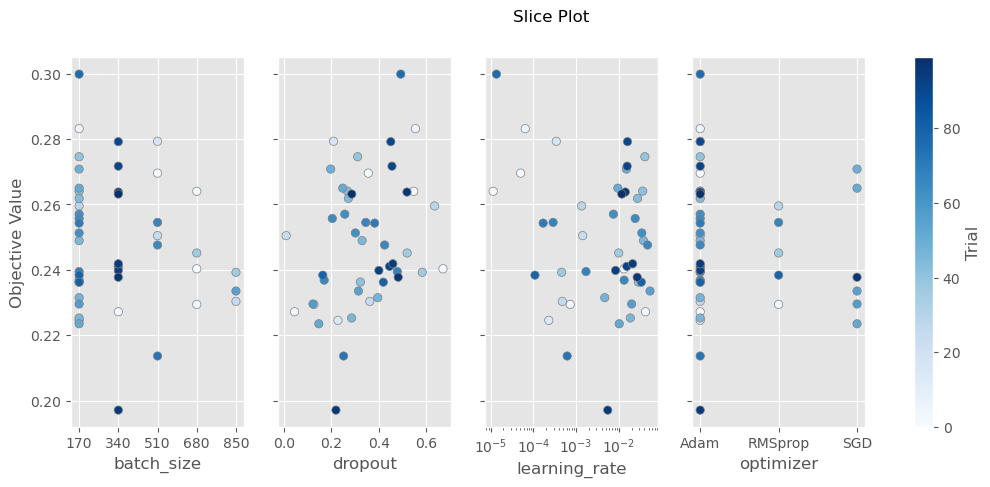

In [123]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

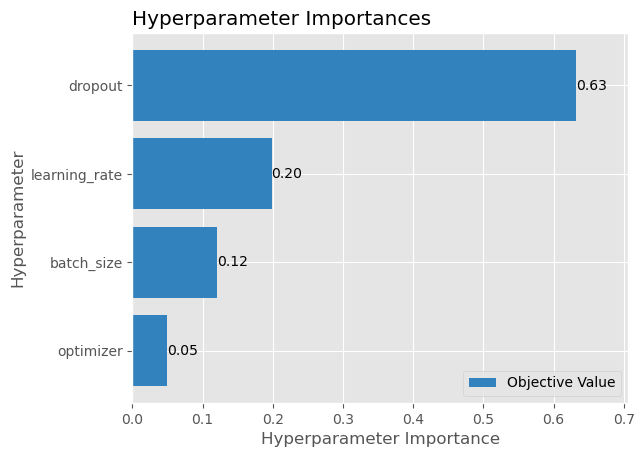

In [124]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

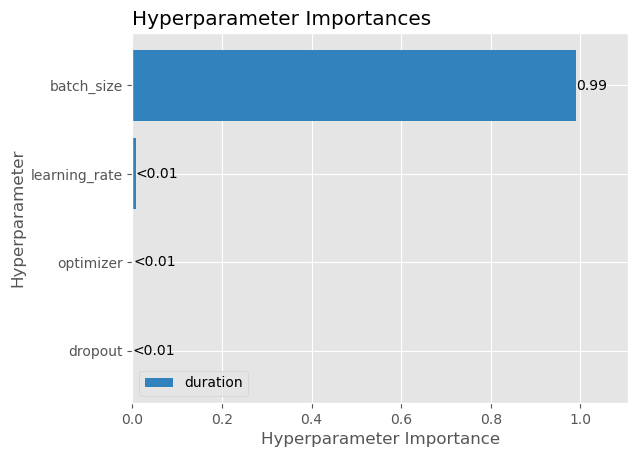

In [125]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

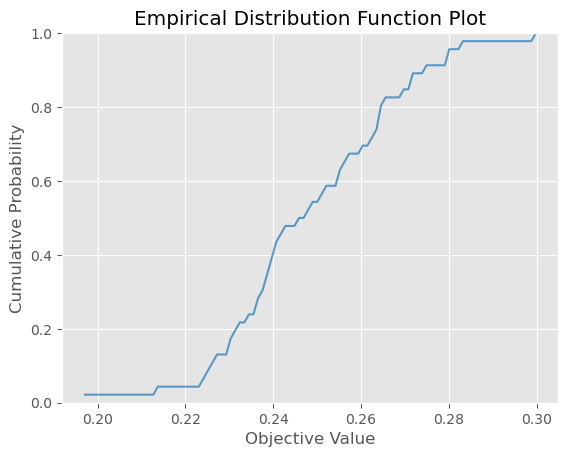

In [126]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-21 23:45:51,159] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


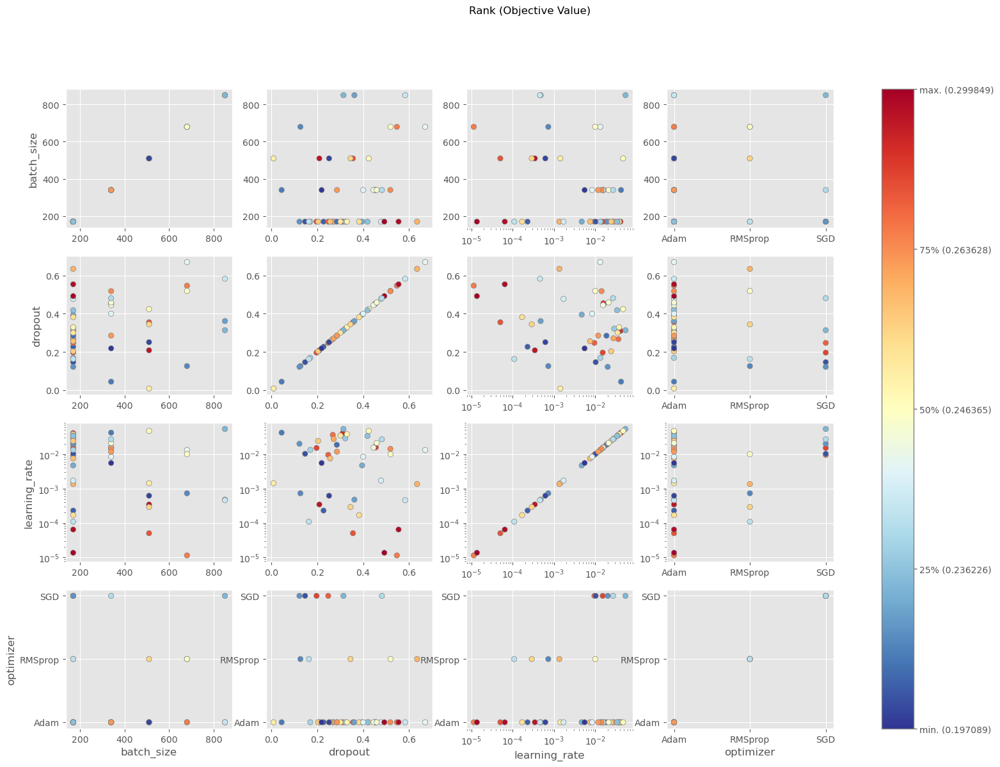

In [127]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


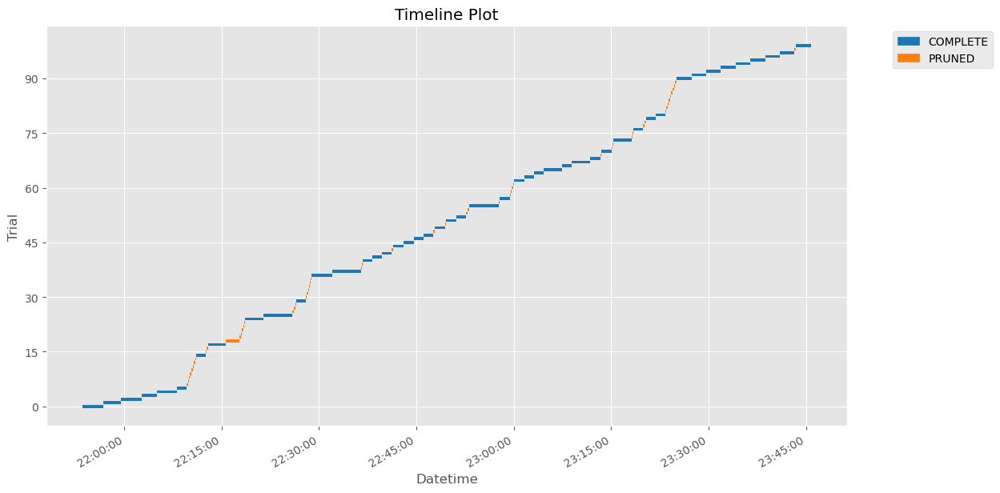

In [128]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda without edge_attr

In [129]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    # fc_layers = 1
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size

    # Create the model
    model = graphLambda_wo_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)

    

    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ratio_results_wo_edge_attrs_trials.pkl')

[I 2024-06-21 23:45:53,633] A new study created in memory with name: no-name-5bd5ad52-c83e-443f-9ddb-a2b91584e6f9
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.03900619315709299, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.12496238383249798}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 23:50:13,831] Trial 0 finished with value: 0.2240057736635208 and parameters: {'learning_rate': 0.03900619315709299, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.12496238383249798}. Best is trial 0 with value: 0.2240057736635208.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0231866388793108, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.39537146697023484}


[I 2024-06-21 23:50:26,729] Trial 1 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.00011349517695126554, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.47759679702644675}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-21 23:53:59,652] Trial 2 finished with value: 0.22431670129299164 and parameters: {'learning_rate': 0.00011349517695126554, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.47759679702644675}. Best is trial 2 with value: 0.22431670129299164.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 0.02405426399272231, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.2769607474018975}


[I 2024-06-21 23:54:12,205] Trial 3 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.055465706634602e-05, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.37763160341521207}


[I 2024-06-21 23:54:24,168] Trial 4 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.8617470471942456e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.3082957718284732}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-21 23:58:54,265] Trial 5 finished with value: 0.27461111545562744 and parameters: {'learning_rate': 1.8617470471942456e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.3082957718284732}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0015477491739320562, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.6316652925609777}


[I 2024-06-21 23:59:07,595] Trial 6 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00022794629819452295, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.6463332991451116}


[I 2024-06-21 23:59:18,759] Trial 7 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014520639927122104, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.658433325172007}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 00:03:40,231] Trial 8 finished with value: 0.20682509243488312 and parameters: {'learning_rate': 0.0014520639927122104, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.658433325172007}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.07115039551526733, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.037577537888562246}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 00:10:49,419] Trial 9 finished with value: 0.2530449628829956 and parameters: {'learning_rate': 0.07115039551526733, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.037577537888562246}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 1.0750606616681133e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.2202316092919762}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 00:13:35,332] Trial 10 finished with value: 0.2501090466976166 and parameters: {'learning_rate': 1.0750606616681133e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.2202316092919762}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007449919718178542, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.01577998288017712}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 00:21:03,115] Trial 11 finished with value: 0.25444963574409485 and parameters: {'learning_rate': 0.007449919718178542, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.01577998288017712}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.007912350023901348, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.07689686915983188}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 00:28:14,861] Trial 12 finished with value: 0.23730169236660004 and parameters: {'learning_rate': 0.007912350023901348, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.07689686915983188}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.005512168890671608, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.20799694927987641}


[I 2024-06-22 00:28:31,615] Trial 13 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.4866289751939176e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.5017486281570472}


[I 2024-06-22 00:28:54,447] Trial 14 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004619256234898284, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 4, 'dropout': 0.7654203965616999}


[I 2024-06-22 00:29:06,662] Trial 15 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00035089290073530644, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.006486581784159938}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 00:33:39,441] Trial 16 finished with value: 0.18067389726638794 and parameters: {'learning_rate': 0.00035089290073530644, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.006486581784159938}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.404651299240863e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.3084368804039185}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 00:40:43,586] Trial 17 finished with value: 0.2316969335079193 and parameters: {'learning_rate': 3.404651299240863e-05, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.3084368804039185}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007213559789726227, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.16300489827370818}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 00:45:49,839] Trial 18 finished with value: 0.2351963073015213 and parameters: {'learning_rate': 0.0007213559789726227, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.16300489827370818}. Best is trial 5 with value: 0.27461111545562744.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0024340329003840677, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.49350090276378705}


[I 2024-06-22 00:46:06,309] Trial 19 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.013448785505131742, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3376208329398223}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 00:48:43,560] Trial 20 finished with value: 0.28826892375946045 and parameters: {'learning_rate': 0.013448785505131742, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3376208329398223}. Best is trial 20 with value: 0.28826892375946045.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.008094606521945668, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3232687100950719}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 00:51:25,512] Trial 21 finished with value: 0.2574527859687805 and parameters: {'learning_rate': 0.008094606521945668, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3232687100950719}. Best is trial 20 with value: 0.28826892375946045.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014034711140335275, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3189564752170861}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 00:54:00,558] Trial 22 finished with value: 0.2527223229408264 and parameters: {'learning_rate': 0.014034711140335275, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3189564752170861}. Best is trial 20 with value: 0.28826892375946045.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.08181902666113708, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.44002821565432987}


[I 2024-06-22 00:54:23,302] Trial 23 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007896817609045295, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3390440145616867}


[I 2024-06-22 00:54:46,476] Trial 24 pruned. Trial was pruned at epoch 102.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0030185561932749797, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.23449304246196784}


[I 2024-06-22 00:55:08,732] Trial 25 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.012574490464525391, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.4124768600875213}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 00:57:48,066] Trial 26 finished with value: 0.23592059314250946 and parameters: {'learning_rate': 0.012574490464525391, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.4124768600875213}. Best is trial 20 with value: 0.28826892375946045.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.0170574575814557e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.5685496765263175}


[I 2024-06-22 00:58:16,238] Trial 27 pruned. Trial was pruned at epoch 126.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004114089698609679, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.2705883294551935}


[I 2024-06-22 00:58:29,242] Trial 28 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.038971956563362935, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.16439610873936036}


[I 2024-06-22 00:58:42,390] Trial 29 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03906210015676492, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3501491607717794}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 01:01:24,745] Trial 30 finished with value: 0.3012617826461792 and parameters: {'learning_rate': 0.03906210015676492, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3501491607717794}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04372370195230815, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.35373447351519166}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 01:04:05,343] Trial 31 finished with value: 0.24148347973823547 and parameters: {'learning_rate': 0.04372370195230815, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.35373447351519166}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.018128378983716605, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.4473062674242187}


[I 2024-06-22 01:04:30,127] Trial 32 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03403817991473589, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.38625388401413663}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 01:07:11,426] Trial 33 finished with value: 0.24565687775611877 and parameters: {'learning_rate': 0.03403817991473589, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.38625388401413663}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.010885341854077297, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.2893364640955086}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 01:09:56,488] Trial 34 finished with value: 0.26092585921287537 and parameters: {'learning_rate': 0.010885341854077297, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.2893364640955086}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0249967312157482, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.275599437313538}


[I 2024-06-22 01:10:11,700] Trial 35 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.057598596625834, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.14350946608607934}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 01:13:51,437] Trial 36 finished with value: 0.2674846053123474 and parameters: {'learning_rate': 0.057598596625834, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.14350946608607934}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.09756841241641391, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.098759695128358}


[I 2024-06-22 01:14:07,243] Trial 37 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001254975419761966, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.12928215429187306}


[I 2024-06-22 01:15:06,789] Trial 38 pruned. Trial was pruned at epoch 356.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0626645222856513, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.5343554454732913}


[I 2024-06-22 01:15:25,134] Trial 39 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.02338079215287494, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.18205671917811175}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 01:20:31,822] Trial 40 finished with value: 0.26298001408576965 and parameters: {'learning_rate': 0.02338079215287494, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.18205671917811175}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.027323617853904195, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.20027721150171285}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 01:25:31,346] Trial 41 finished with value: 0.2572629749774933 and parameters: {'learning_rate': 0.027323617853904195, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.20027721150171285}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.05801119871044925, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 1, 'dropout': 0.24265455107383854}


[I 2024-06-22 01:25:42,208] Trial 42 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.01693705340795798, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.1580157173582163}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 01:30:41,066] Trial 43 finished with value: 0.2493915855884552 and parameters: {'learning_rate': 0.01693705340795798, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.1580157173582163}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.047505405152201294, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.07703396642600807}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 01:35:42,682] Trial 44 finished with value: 0.2207450270652771 and parameters: {'learning_rate': 0.047505405152201294, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.07703396642600807}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.03006249429147311, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.3682401457623345}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 01:40:07,812] Trial 45 finished with value: 0.24119596183300018 and parameters: {'learning_rate': 0.03006249429147311, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 2, 'dropout': 0.3682401457623345}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0039237160789942025, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.41408219191614615}


[I 2024-06-22 01:40:24,493] Trial 46 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0017693393356746137, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.1899668790968078}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 01:45:43,678] Trial 47 finished with value: 0.25179359316825867 and parameters: {'learning_rate': 0.0017693393356746137, 'optimizer': 'SGD', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.1899668790968078}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.977149107524628e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2525509648593351}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 01:50:11,254] Trial 48 finished with value: 0.2878459095954895 and parameters: {'learning_rate': 5.977149107524628e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2525509648593351}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.257187927921431e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.23523670189022383}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 01:54:36,736] Trial 49 finished with value: 0.28177863359451294 and parameters: {'learning_rate': 5.257187927921431e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.23523670189022383}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.427285701314453e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.25844273173565335}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 01:59:07,958] Trial 50 finished with value: 0.2538450360298157 and parameters: {'learning_rate': 8.427285701314453e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.25844273173565335}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.0451784366230808e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.11753234341638064}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:03:36,310] Trial 51 finished with value: 0.23315224051475525 and parameters: {'learning_rate': 2.0451784366230808e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.11753234341638064}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.753897346680085e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2967551906688531}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:08:08,036] Trial 52 finished with value: 0.2710534930229187 and parameters: {'learning_rate': 4.753897346680085e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2967551906688531}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.479524165047425e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.294780876436061}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:12:35,990] Trial 53 finished with value: 0.22302626073360443 and parameters: {'learning_rate': 5.479524165047425e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.294780876436061}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001430984004658004, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.3429011829634106}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:17:03,942] Trial 54 finished with value: 0.2701393961906433 and parameters: {'learning_rate': 0.0001430984004658004, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.3429011829634106}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.651826461162127e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.22433304718587455}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:21:33,981] Trial 55 finished with value: 0.26400744915008545 and parameters: {'learning_rate': 3.651826461162127e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.22433304718587455}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0661342058678874e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.30902794865649336}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:26:06,145] Trial 56 finished with value: 0.254361093044281 and parameters: {'learning_rate': 1.0661342058678874e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.30902794865649336}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.9150044032925385e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3902077958459826}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:30:47,151] Trial 57 finished with value: 0.23203599452972412 and parameters: {'learning_rate': 1.9150044032925385e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.3902077958459826}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.1248369920220366e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.7889524147122087}


[I 2024-06-22 02:31:01,959] Trial 58 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002712015702270407, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.4598000659645911}


[I 2024-06-22 02:31:15,112] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.002998457813223e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.25716092394484574}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 02:38:22,512] Trial 60 finished with value: 0.229959174990654 and parameters: {'learning_rate': 9.002998457813223e-05, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 6, 'dropout': 0.25716092394484574}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.1377194481941984e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.33247178874672056}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:43:02,950] Trial 61 finished with value: 0.2279929518699646 and parameters: {'learning_rate': 5.1377194481941984e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.33247178874672056}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.952271717218444e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.32833184544825134}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:47:33,673] Trial 62 finished with value: 0.2582343816757202 and parameters: {'learning_rate': 1.952271717218444e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.32833184544825134}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015838212092464054, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.36709994302657234}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:52:01,686] Trial 63 finished with value: 0.24109424650669098 and parameters: {'learning_rate': 0.00015838212092464054, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.36709994302657234}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.7533569734444012e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.3455862460877247}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 02:56:44,104] Trial 64 finished with value: 0.22924548387527466 and parameters: {'learning_rate': 2.7533569734444012e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.3455862460877247}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00018260875990448017, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.4131454470118713}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:01:10,285] Trial 65 finished with value: 0.2410312443971634 and parameters: {'learning_rate': 0.00018260875990448017, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.4131454470118713}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.020712985203616e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2940816620102858}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:05:42,168] Trial 66 finished with value: 0.25405269861221313 and parameters: {'learning_rate': 4.020712985203616e-05, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2940816620102858}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011641769102171849, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.24527282723362562}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:08:19,553] Trial 67 finished with value: 0.25063443183898926 and parameters: {'learning_rate': 0.00011641769102171849, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.24527282723362562}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3845131375607948e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21230833158850065}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:12:51,046] Trial 68 finished with value: 0.26980262994766235 and parameters: {'learning_rate': 1.3845131375607948e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21230833158850065}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.59085436003123e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.35688957602311533}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 03:19:56,269] Trial 69 finished with value: 0.24117423593997955 and parameters: {'learning_rate': 6.59085436003123e-05, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.35688957602311533}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.4948000457421274e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2766831111740841}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:22:36,516] Trial 70 finished with value: 0.27359533309936523 and parameters: {'learning_rate': 2.4948000457421274e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2766831111740841}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.631914958180799e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2784310260843215}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:25:23,233] Trial 71 finished with value: 0.2403871864080429 and parameters: {'learning_rate': 2.631914958180799e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2784310260843215}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004870620214494445, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.2702996552855693}


[I 2024-06-22 03:25:46,671] Trial 72 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.926313426367977e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.30973413379742926}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:28:29,091] Trial 73 finished with value: 0.24789585173130035 and parameters: {'learning_rate': 3.926313426367977e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.30973413379742926}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3281366148519877e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.3952965489533024}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:31:12,615] Trial 74 finished with value: 0.26304930448532104 and parameters: {'learning_rate': 1.3281366148519877e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.3952965489533024}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.355645199230929e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.2339969701405192}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:33:54,173] Trial 75 finished with value: 0.2474789172410965 and parameters: {'learning_rate': 8.355645199230929e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.2339969701405192}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.198922655278696e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.4272441077721449}


[I 2024-06-22 03:34:07,370] Trial 76 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.647538687418688e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.3407408607600372}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:36:43,896] Trial 77 finished with value: 0.2482532113790512 and parameters: {'learning_rate': 6.647538687418688e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.3407408607600372}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.9220065354086705e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2981683007370286}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:41:07,222] Trial 78 finished with value: 0.2643239498138428 and parameters: {'learning_rate': 4.9220065354086705e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.2981683007370286}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012389512589590403, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.3802054435508827}


[I 2024-06-22 03:41:20,981] Trial 79 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.595670426245611e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.3137324919668351}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 03:44:10,144] Trial 80 finished with value: 0.2489733099937439 and parameters: {'learning_rate': 1.595670426245611e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 8, 'dropout': 0.3137324919668351}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.3390632964166898e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21793948587531664}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:48:45,269] Trial 81 finished with value: 0.24823400378227234 and parameters: {'learning_rate': 1.3390632964166898e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.21793948587531664}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.4398804959828136e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.17922244580816582}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:53:14,691] Trial 82 finished with value: 0.26873892545700073 and parameters: {'learning_rate': 2.4398804959828136e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.17922244580816582}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.291175599746036e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.25986293774410285}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 03:57:43,183] Trial 83 finished with value: 0.23375728726387024 and parameters: {'learning_rate': 3.291175599746036e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.25986293774410285}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.1766343596729259e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.22298302979079115}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:02:12,355] Trial 84 finished with value: 0.2465561330318451 and parameters: {'learning_rate': 1.1766343596729259e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.22298302979079115}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.6988919443986564e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2852588706902683}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:06:46,809] Trial 85 finished with value: 0.24606594443321228 and parameters: {'learning_rate': 1.6988919443986564e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2852588706902683}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00597112176035182, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.20503496262683632}


[I 2024-06-22 04:07:00,164] Trial 86 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.863661032464658e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.24782257451783066}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 04:09:35,770] Trial 87 finished with value: 0.2508854269981384 and parameters: {'learning_rate': 9.863661032464658e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.24782257451783066}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.3567345936581516e-05, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.35133305115197005}


[I 2024-06-22 04:09:49,372] Trial 88 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.168015722784444e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.3240863620958501}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:14:18,368] Trial 89 finished with value: 0.24433296918869019 and parameters: {'learning_rate': 3.168015722784444e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.3240863620958501}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.236968523314225e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.7000134029629631}


[I 2024-06-22 04:14:41,294] Trial 90 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.3786175401598945e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1398727875479316}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:19:07,520] Trial 91 finished with value: 0.2482186257839203 and parameters: {'learning_rate': 2.3786175401598945e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1398727875479316}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0196895709536642e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1845347652575219}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:23:49,495] Trial 92 finished with value: 0.2547621726989746 and parameters: {'learning_rate': 1.0196895709536642e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1845347652575219}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.9886703500248017e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.20383536504943972}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:28:31,141] Trial 93 finished with value: 0.2608974575996399 and parameters: {'learning_rate': 2.9886703500248017e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.20383536504943972}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001432892100725398, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1710396653054418}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:33:06,653] Trial 94 finished with value: 0.2552243769168854 and parameters: {'learning_rate': 0.0001432892100725398, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.1710396653054418}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.5690210567709425e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2657475586048587}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:37:44,145] Trial 95 finished with value: 0.2862652838230133 and parameters: {'learning_rate': 1.5690210567709425e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2657475586048587}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.609769245906583e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2773350053233332}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 04:42:18,571] Trial 96 finished with value: 0.20629675686359406 and parameters: {'learning_rate': 1.609769245906583e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.2773350053233332}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.155636440782773e-05, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.30620992124557217}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 04:46:01,109] Trial 97 finished with value: 0.23784568905830383 and parameters: {'learning_rate': 6.155636440782773e-05, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.30620992124557217}. Best is trial 30 with value: 0.3012617826461792.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00025746250246047733, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 8, 'dropout': 0.3671711885997529}


[I 2024-06-22 04:46:14,563] Trial 98 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.765453350705058e-05, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2557655638334998}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 04:48:58,700] Trial 99 finished with value: 0.23630566895008087 and parameters: {'learning_rate': 1.765453350705058e-05, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.2557655638334998}. Best is trial 30 with value: 0.3012617826461792.


Best trial:
  Value: 0.3012617826461792
  Params: 
    learning_rate: 0.03906210015676492
    optimizer: SGD
    batch_size: 170
    fc_layers: 5
    dropout: 0.3501491607717794


In [130]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_730/checkpoints/epoch=403-train_loss=0.58-train_f1=0.74-val_loss=3.32-val_f1=0.31.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.03906210015676492, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.3501491607717794}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.3108566403388977     │
│         val_loss          │    3.3175723552703857     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.42      0.32      0.36       108
     HEALTHY       0.31      0.36      0.33       108
         MDD       0.25      0.22      0.24       108
         OCD       0.29      0.30      0.29       108
         SMC       0.31      0.35      0.33       108

    accuracy                           0.31       540
   macro avg       0.31      0.31      0.31       540
weighted avg       0.31      0.31      0.31       540

F1-score: 0.310856657710106


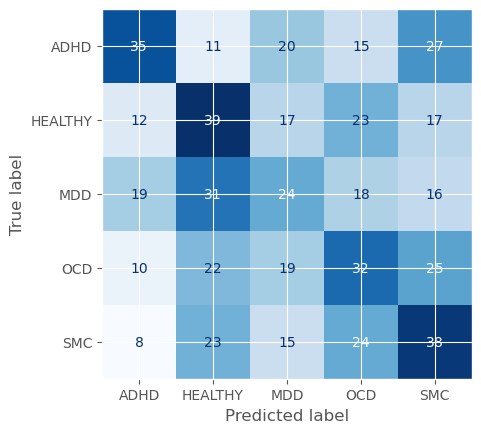

In [131]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_wo_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.19054864346981049    │
│         val_loss          │     3.790252923965454     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.18      0.14      0.16        84
     HEALTHY       0.26      0.31      0.28        84
         MDD       0.17      0.19      0.18        84
         OCD       0.14      0.17      0.15        84
         SMC       0.22      0.16      0.18        96

    accuracy                           0.19       432
   macro avg       0.19      0.19      0.19       432
weighted avg       0.19      0.19      0.19       432

F1-score:
 0.1905486387367446


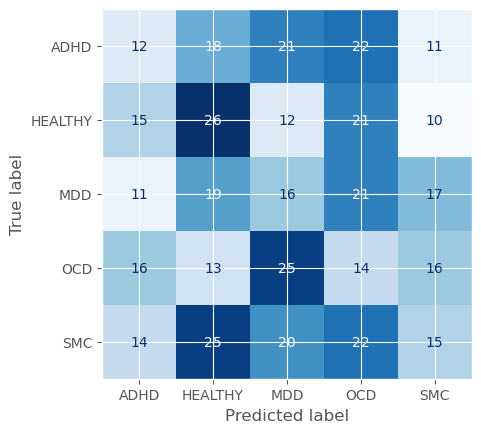

In [132]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [133]:
df_trials = pd.read_pickle('ratio_results_wo_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
30,30,0.301262,2024-06-22 00:58:42.390693,2024-06-22 01:01:24.744887,0 days 00:02:42.354194,170,0.350149,5,0.039062,SGD,/home/tsmolders/lightning_logs/version_730/che...,COMPLETE
20,20,0.288269,2024-06-22 00:46:06.311775,2024-06-22 00:48:43.559232,0 days 00:02:37.247457,170,0.337621,5,0.013449,SGD,/home/tsmolders/lightning_logs/version_720/che...,COMPLETE
48,48,0.287846,2024-06-22 01:45:43.679608,2024-06-22 01:50:11.252167,0 days 00:04:27.572559,510,0.252551,6,0.000060,RMSprop,/home/tsmolders/lightning_logs/version_748/che...,COMPLETE
95,95,0.286265,2024-06-22 04:33:06.654659,2024-06-22 04:37:44.143367,0 days 00:04:37.488708,510,0.265748,7,0.000016,RMSprop,/home/tsmolders/lightning_logs/version_795/che...,COMPLETE
49,49,0.281779,2024-06-22 01:50:11.255796,2024-06-22 01:54:36.735237,0 days 00:04:25.479441,510,0.235237,6,0.000053,RMSprop,/home/tsmolders/lightning_logs/version_749/che...,COMPLETE
5,5,0.274611,2024-06-21 23:54:24.170080,2024-06-21 23:58:54.263381,0 days 00:04:30.093301,510,0.308296,6,0.000019,RMSprop,/home/tsmolders/lightning_logs/version_705/che...,COMPLETE
70,70,0.273595,2024-06-22 03:19:56.271044,2024-06-22 03:22:36.515418,0 days 00:02:40.244374,170,0.276683,7,0.000025,RMSprop,/home/tsmolders/lightning_logs/version_770/che...,COMPLETE
52,52,0.271053,2024-06-22 02:03:36.311900,2024-06-22 02:08:08.034968,0 days 00:04:31.723068,510,0.296755,6,0.000048,RMSprop,/home/tsmolders/lightning_logs/version_752/che...,COMPLETE
54,54,0.270139,2024-06-22 02:12:35.991137,2024-06-22 02:17:03.940809,0 days 00:04:27.949672,510,0.342901,7,0.000143,RMSprop,/home/tsmolders/lightning_logs/version_754/che...,COMPLETE
68,68,0.269803,2024-06-22 03:08:19.554864,2024-06-22 03:12:51.044989,0 days 00:04:31.490125,510,0.212308,6,0.000014,RMSprop,/home/tsmolders/lightning_logs/version_768/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

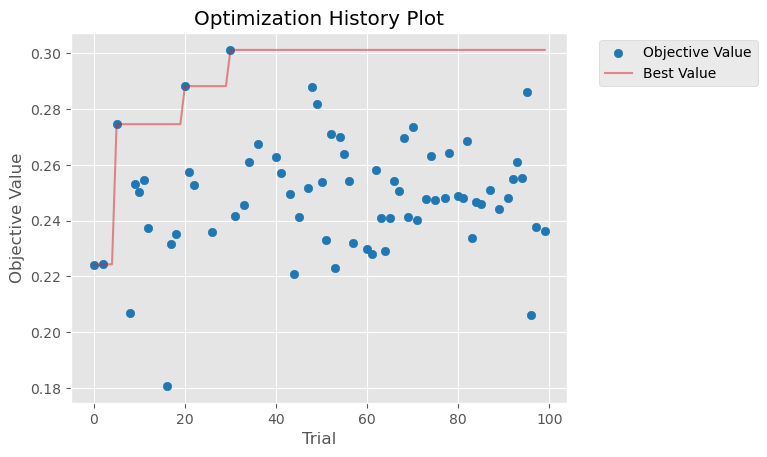

In [134]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-22 04:48:59,721] A new study created in memory with name: no-name-512ed573-2ac0-4c32-8e11-16dc8497ba99
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


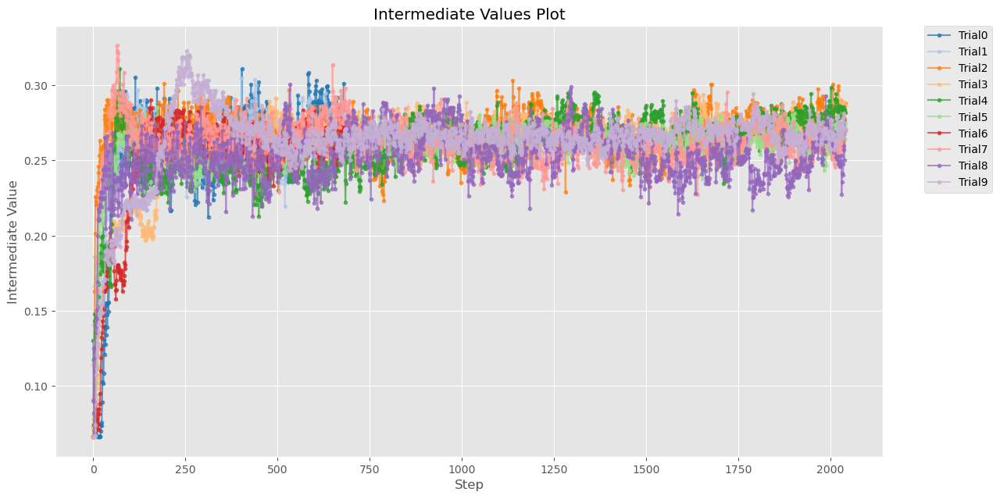

In [135]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


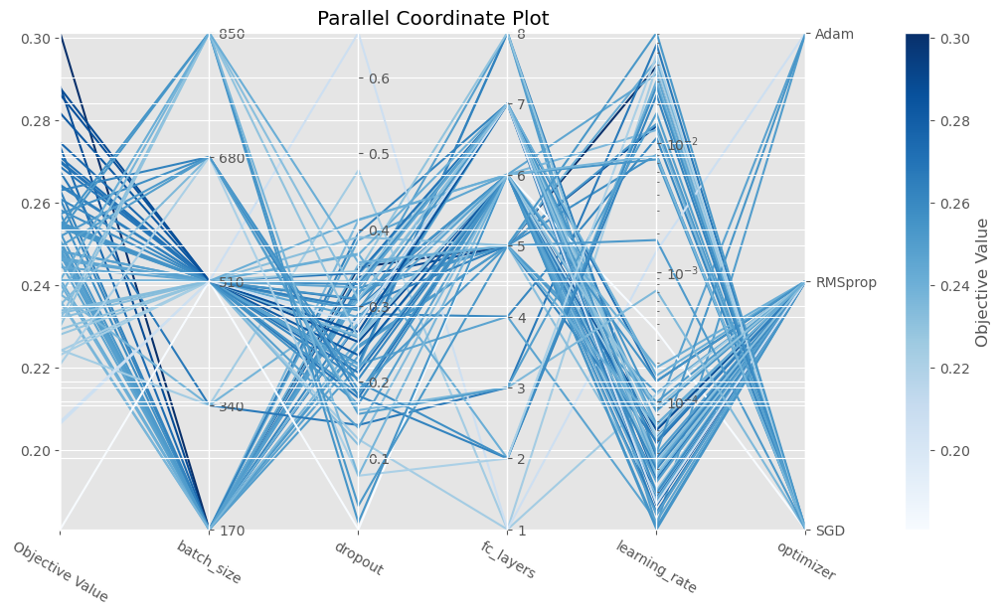

In [136]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-22 04:49:01,019] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


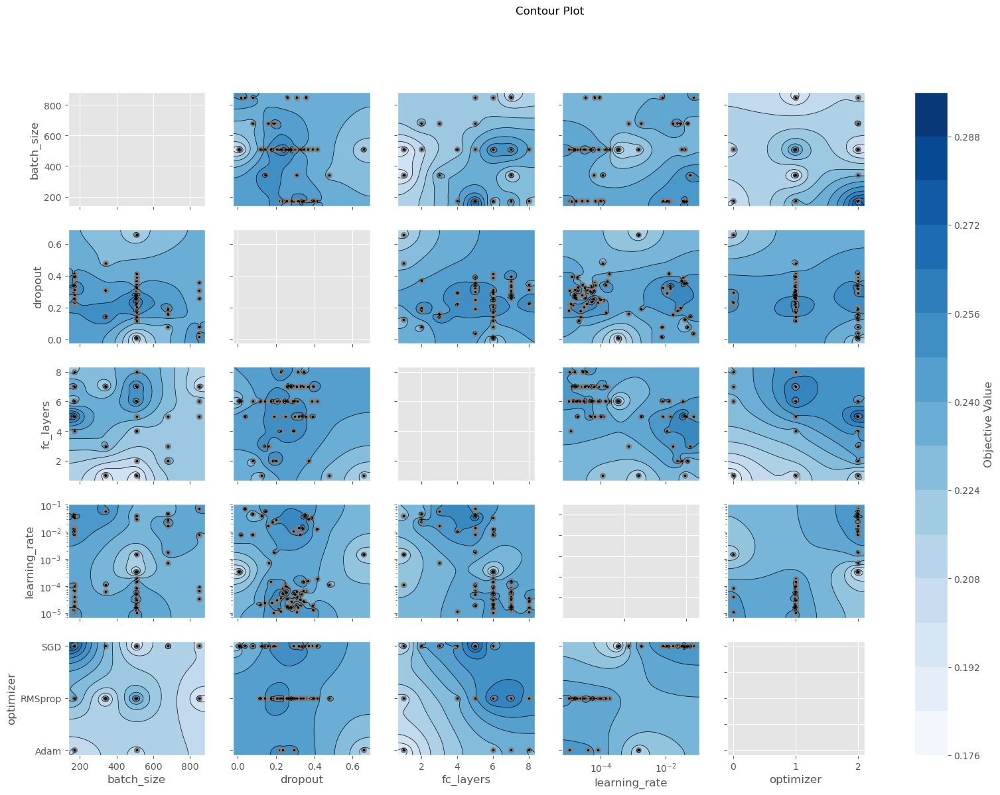

In [137]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

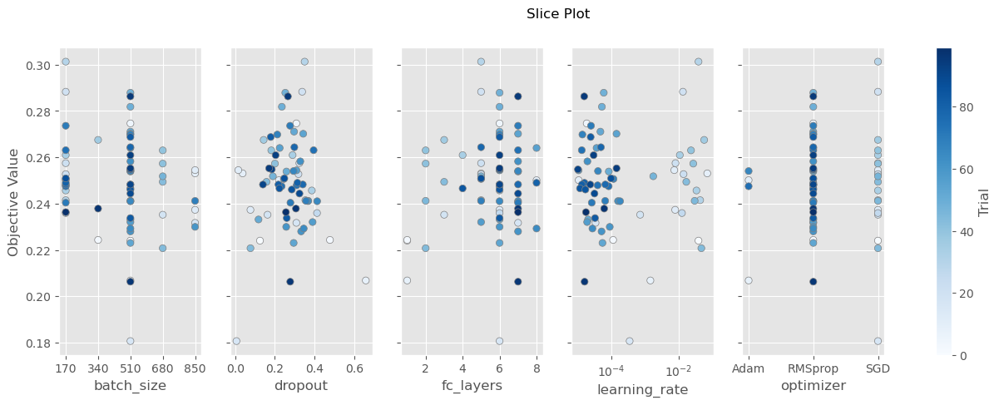

In [138]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

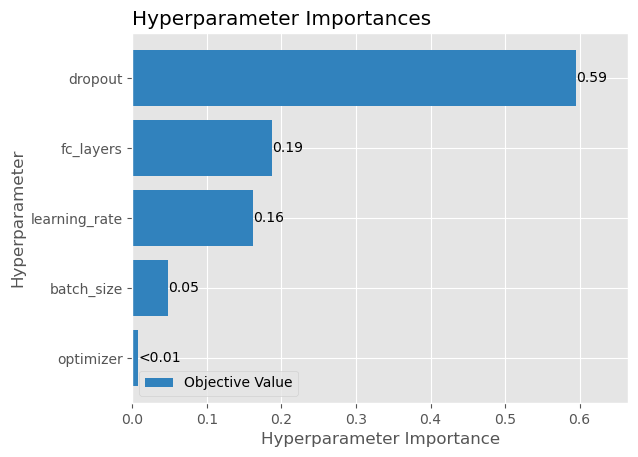

In [139]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

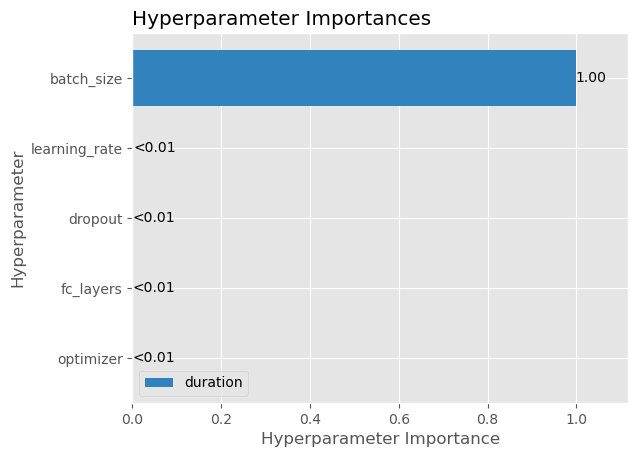

In [140]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

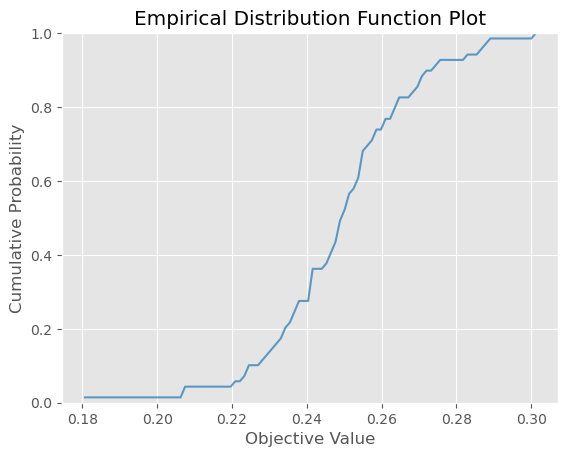

In [141]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-22 04:49:09,211] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


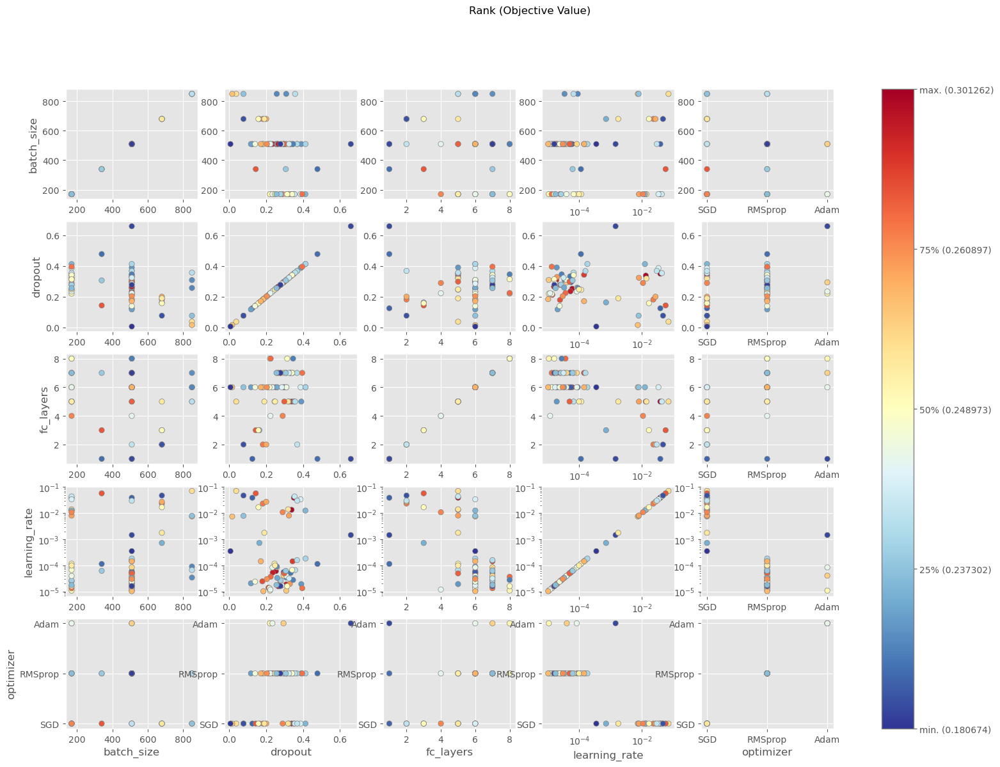

In [142]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


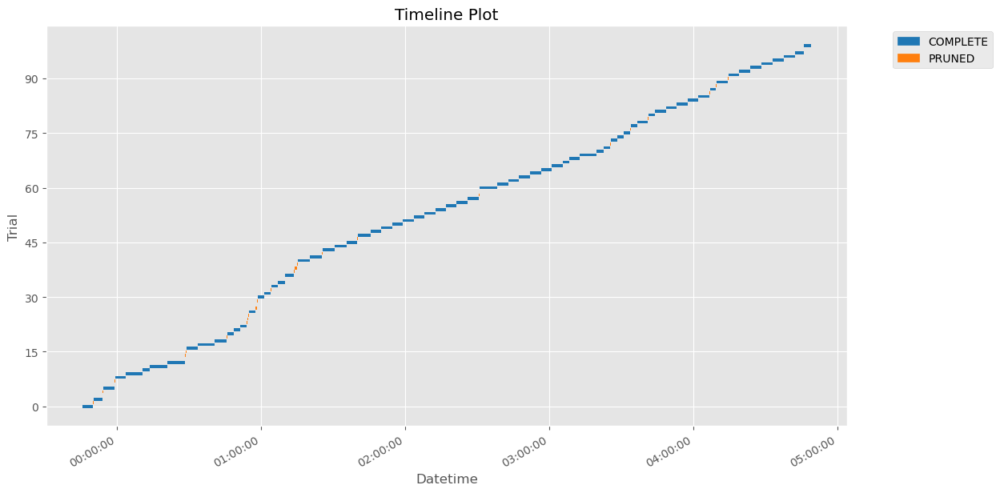

In [143]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)

### Model: graphLambda with edge_attr

In [144]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import RichProgressBar
import logging
import warnings

warnings.filterwarnings("ignore", ".*Consider increasing the value of the `num_workers` argument*")
warnings.filterwarnings("ignore", "Trying to infer the `batch_size` from an ambiguous collection.*")
torch.set_float32_matmul_precision('high')
logging.getLogger("lightning.pytorch.utilities.rank_zero").setLevel(logging.WARNING)
logging.getLogger("lightning.pytorch.accelerators.cuda").setLevel(logging.WARNING)

def objective(trial):
    # Suggest values for the hyperparameters
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    batch_size = trial.suggest_categorical('batch_size', [170, 340, 510, 680, 850])
    fc_layers = trial.suggest_int('fc_layers', 1, 8)
    dropout = trial.suggest_float('dropout', 0, 0.8)
    hyperparameters = dict(learning_rate=learning_rate, optimizer_name=optimizer_name, batch_size=batch_size, fc_layers=fc_layers, dropout=dropout)
    print(f'Tested parameters: {hyperparameters}')
    n_epochs = batch_size * 4 # vary training epochs based on batch size


    # Create the model
    model = graphLambda_w_edge_attr(learning_rate=learning_rate, optimizer_name=optimizer_name, fc_layers=fc_layers, dropout=dropout)

    

    # Create checkpoint callback
    checkpoint_callback = ModelCheckpoint(monitor='val_f1',
                                        mode='max',
                                        save_top_k=3,
                                        filename='{epoch}-{train_loss:.2f}-{train_f1:.2f}-{val_loss:.2f}-{val_f1:.2f}',
                                        )

    # Create the PyTorch Lightning trainer
    trainer = Trainer(
        accelerator='gpu',
        devices=1,
        max_epochs=n_epochs,
        callbacks=[PyTorchLightningPruningCallback(trial, monitor="val_f1"), checkpoint_callback],
        enable_progress_bar=False,
        enable_model_summary=False,
        logger=True,
        enable_checkpointing=True,
    )

    # Define the data loaders
    train_loader = DataLoader(X_train, batch_size=batch_size, shuffle=True,
                              drop_last=True) # , num_workers=0, persistent_workers=True
    val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True) # , num_workers=0, persistent_workers=True

    # Log the hyperparameters
    trainer.logger.log_hyperparams(hyperparameters)

    # Train the model
    trainer.fit(model, train_loader, val_loader)

    # Evaluate the model
    val_f1 = trainer.callback_metrics["val_f1"].item()

    # After training, store the best model path in the trial's user attributes
    trial.set_user_attr("best_model_path", checkpoint_callback.best_model_path)

    return val_f1

study = optuna.create_study(direction='maximize', pruner=optuna.pruners.ThresholdPruner(lower=0.1, n_warmup_steps=100))
study.optimize(objective, n_trials=100)

print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

df = study.trials_dataframe()
df.to_pickle('ratio_results_w_edge_attrs_trials.pkl')

[I 2024-06-22 04:49:12,214] A new study created in memory with name: no-name-b929b3dc-1830-4b6a-b419-8f38b9353ba4
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (10) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 9.7357432700703e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3046934180231422}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 04:52:06,087] Trial 0 finished with value: 0.2678912281990051 and parameters: {'learning_rate': 9.7357432700703e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3046934180231422}. Best is trial 0 with value: 0.2678912281990051.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (5) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 2.23106162428417e-05, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.008124205489015601}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 04:56:19,426] Trial 1 finished with value: 0.24342693388462067 and parameters: {'learning_rate': 2.23106162428417e-05, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.008124205489015601}. Best is trial 0 with value: 0.2678912281990051.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Tested parameters: {'learning_rate': 4.557573815930248e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.19964654001734533}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 05:05:01,506] Trial 2 finished with value: 0.2510474920272827 and parameters: {'learning_rate': 4.557573815930248e-05, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.19964654001734533}. Best is trial 0 with value: 0.2678912281990051.


Tested parameters: {'learning_rate': 2.0253773549482787e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 7, 'dropout': 0.7023311171586412}


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/tsmolders/.conda/envs/py3117/lib/python3.11/site-packages/lightning/pytorch/loops/fit_loop.py:298: The number of training batches (3) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
[I 2024-06-22 05:05:18,379] Trial 3 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.81670658482827e-05, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.3937203029779805}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 05:10:30,110] Trial 4 finished with value: 0.24572108685970306 and parameters: {'learning_rate': 4.81670658482827e-05, 'optimizer': 'RMSprop', 'batch_size': 510, 'fc_layers': 1, 'dropout': 0.3937203029779805}. Best is trial 0 with value: 0.2678912281990051.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003196085002637019, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.18840360449758933}


[I 2024-06-22 05:10:57,116] Trial 5 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004395889764273061, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.4355569034278207}


[I 2024-06-22 05:11:49,165] Trial 6 pruned. Trial was pruned at epoch 361.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.3210380056056064e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.6045473027105749}


[I 2024-06-22 05:12:42,389] Trial 7 pruned. Trial was pruned at epoch 212.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00031186048230431363, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.5193464210844992}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 05:16:55,005] Trial 8 finished with value: 0.2044260948896408 and parameters: {'learning_rate': 0.00031186048230431363, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.5193464210844992}. Best is trial 0 with value: 0.2678912281990051.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.254370582050933e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 3, 'dropout': 0.24735502414029684}


[I 2024-06-22 05:18:46,720] Trial 9 pruned. Trial was pruned at epoch 447.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.054085054531772404, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.018425544573893227}


[I 2024-06-22 05:19:03,168] Trial 10 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002070014593792758, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.23984947961149447}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 05:27:47,554] Trial 11 finished with value: 0.2508634328842163 and parameters: {'learning_rate': 0.0002070014593792758, 'optimizer': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.23984947961149447}. Best is trial 0 with value: 0.2678912281990051.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0025537137557434374, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 5, 'dropout': 0.3351132610646624}


[I 2024-06-22 05:28:04,409] Trial 12 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011342188919166341, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.12491753290823045}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 05:34:10,020] Trial 13 finished with value: 0.29371213912963867 and parameters: {'learning_rate': 0.00011342188919166341, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.12491753290823045}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00012938919058930233, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.12110785783775614}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 05:40:12,821] Trial 14 finished with value: 0.2546663284301758 and parameters: {'learning_rate': 0.00012938919058930233, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.12110785783775614}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008856717969846543, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.3266734389719788}


[I 2024-06-22 05:40:26,435] Trial 15 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012548382796918767, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.07842774898455553}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 05:46:29,747] Trial 16 finished with value: 0.23248335719108582 and parameters: {'learning_rate': 0.0012548382796918767, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.07842774898455553}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.014956228902261849, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 2, 'dropout': 0.1282614269990603}


[I 2024-06-22 05:46:54,579] Trial 17 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.521238085731523e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 6, 'dropout': 0.7809131050441194}


[I 2024-06-22 05:47:23,361] Trial 18 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007586272629595243, 'optimizer_name': 'SGD', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.4971147770683183}


[I 2024-06-22 05:47:37,213] Trial 19 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.038080112906013e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.3066990563717441}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 05:51:52,801] Trial 20 finished with value: 0.23277181386947632 and parameters: {'learning_rate': 1.038080112906013e-05, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 2, 'dropout': 0.3066990563717441}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00012691993512392935, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.10363383312748865}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 05:58:03,712] Trial 21 finished with value: 0.22865135967731476 and parameters: {'learning_rate': 0.00012691993512392935, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.10363383312748865}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.106045734365321e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.16080694220216218}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:04:06,892] Trial 22 finished with value: 0.24832245707511902 and parameters: {'learning_rate': 8.106045734365321e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.16080694220216218}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004056355701110291, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0782232197243621}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:10:25,389] Trial 23 finished with value: 0.25575122237205505 and parameters: {'learning_rate': 0.0004056355701110291, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0782232197243621}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004938553848795711, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.05653137304382001}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:16:29,453] Trial 24 finished with value: 0.28419217467308044 and parameters: {'learning_rate': 0.0004938553848795711, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.05653137304382001}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0030583251959117805, 'optimizer_name': 'RMSprop', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.2545553091433717}


[I 2024-06-22 06:16:45,367] Trial 25 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004067864059668851, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.059904385290331846}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 06:19:46,021] Trial 26 finished with value: 0.2574388384819031 and parameters: {'learning_rate': 0.0004067864059668851, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.059904385290331846}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.62018783369349e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0013455882505707534}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:25:50,940] Trial 27 finished with value: 0.26678088307380676 and parameters: {'learning_rate': 5.62018783369349e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0013455882505707534}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019548350033719438, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.39386930066601156}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:31:56,254] Trial 28 finished with value: 0.21383428573608398 and parameters: {'learning_rate': 0.00019548350033719438, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.39386930066601156}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0013070992763153841, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.16971420480730115}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 06:36:15,579] Trial 29 finished with value: 0.25546810030937195 and parameters: {'learning_rate': 0.0013070992763153841, 'optimizer': 'SGD', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.16971420480730115}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.011192045997756176, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.29289663593516174}


[I 2024-06-22 06:36:42,150] Trial 30 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.507831061777086e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.000946994153470021}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:42:46,928] Trial 31 finished with value: 0.2661146819591522 and parameters: {'learning_rate': 5.507831061777086e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.000946994153470021}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.548516397720625e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.031778487431596475}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:48:51,199] Trial 32 finished with value: 0.23425154387950897 and parameters: {'learning_rate': 4.548516397720625e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.031778487431596475}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.0651429457785914e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.05261217160646407}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 06:55:04,515] Trial 33 finished with value: 0.24817952513694763 and parameters: {'learning_rate': 1.0651429457785914e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.05261217160646407}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.551790585198863e-05, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.13323246047366566}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 07:00:22,222] Trial 34 finished with value: 0.2593892812728882 and parameters: {'learning_rate': 3.551790585198863e-05, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 5, 'dropout': 0.13323246047366566}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005888325978144158, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.21086111360331122}


[I 2024-06-22 07:00:35,792] Trial 35 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00022457319577124532, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.0033767260419891496}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 07:05:57,021] Trial 36 finished with value: 0.23756740987300873 and parameters: {'learning_rate': 0.00022457319577124532, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.0033767260419891496}. Best is trial 13 with value: 0.29371213912963867.


Tested parameters: {'learning_rate': 8.049769261849828e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.18449650297121725}


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:12:13,504] Trial 37 finished with value: 0.22811399400234222 and parameters: {'learning_rate': 8.049769261849828e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.18449650297121725}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001523889475872289, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.4610062153947865}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 07:16:25,765] Trial 38 finished with value: 0.2360791563987732 and parameters: {'learning_rate': 0.0001523889475872289, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 1, 'dropout': 0.4610062153947865}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.5795150359476813e-05, 'optimizer_name': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3664018535597662}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 07:19:22,214] Trial 39 finished with value: 0.13491219282150269 and parameters: {'learning_rate': 1.5795150359476813e-05, 'optimizer': 'SGD', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.3664018535597662}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.9895983565839405e-05, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.5434718946575763}


[I 2024-06-22 07:19:37,683] Trial 40 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.400990128545218e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.012830447084274797}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:25:46,681] Trial 41 finished with value: 0.24370774626731873 and parameters: {'learning_rate': 6.400990128545218e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.012830447084274797}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.951180185636375e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.0937027608706171}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:31:57,284] Trial 42 finished with value: 0.25668662786483765 and parameters: {'learning_rate': 4.951180185636375e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.0937027608706171}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00025313820239689213, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.034211753842960387}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:38:10,174] Trial 43 finished with value: 0.26596730947494507 and parameters: {'learning_rate': 0.00025313820239689213, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.034211753842960387}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.273021488672211e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.0038169043576182014}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:44:15,863] Trial 44 finished with value: 0.247488871216774 and parameters: {'learning_rate': 6.273021488672211e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.0038169043576182014}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 1.8803425449020915e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.057471905993186134}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 07:50:24,123] Trial 45 finished with value: 0.2502279281616211 and parameters: {'learning_rate': 1.8803425449020915e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.057471905993186134}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00010737777669635464, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.14174816331009582}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 07:53:26,602] Trial 46 finished with value: 0.2082454264163971 and parameters: {'learning_rate': 0.00010737777669635464, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.14174816331009582}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 3.165372314252473e-05, 'optimizer_name': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.21844124583105595}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 08:02:02,813] Trial 47 finished with value: 0.12262770533561707 and parameters: {'learning_rate': 3.165372314252473e-05, 'optimizer': 'SGD', 'batch_size': 850, 'fc_layers': 3, 'dropout': 0.21844124583105595}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000530668835043613, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.10183013289767623}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 08:08:10,271] Trial 48 finished with value: 0.2247217297554016 and parameters: {'learning_rate': 0.000530668835043613, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.10183013289767623}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001674842770929412, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.05337867232718509}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 08:11:03,458] Trial 49 finished with value: 0.24720710515975952 and parameters: {'learning_rate': 0.0001674842770929412, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.05337867232718509}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003360303774941445, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09620111352125826}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 08:17:12,953] Trial 50 finished with value: 0.28823229670524597 and parameters: {'learning_rate': 0.0003360303774941445, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.09620111352125826}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003514979137431612, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.6226799710348213}


[I 2024-06-22 08:17:26,933] Trial 51 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001471490269352135, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.10530709244694432}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 08:23:40,644] Trial 52 finished with value: 0.27063995599746704 and parameters: {'learning_rate': 0.001471490269352135, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.10530709244694432}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0012124381232486545, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.15533859929897828}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 08:29:56,677] Trial 53 finished with value: 0.26005062460899353 and parameters: {'learning_rate': 0.0012124381232486545, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.15533859929897828}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.006195558090990649, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.11464857228647447}


[I 2024-06-22 08:30:10,371] Trial 54 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00046457154109120363, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.08408799449455837}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 08:34:35,007] Trial 55 finished with value: 0.2797725200653076 and parameters: {'learning_rate': 0.00046457154109120363, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.08408799449455837}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.002163053236200185, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.2604772384659292}


[I 2024-06-22 08:38:21,662] Trial 56 pruned. Trial was pruned at epoch 1172.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0019397690050834092, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.19757558422589816}


[I 2024-06-22 08:38:41,373] Trial 57 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0005535680310300976, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.08255484949287437}


[I 2024-06-22 08:39:00,967] Trial 58 pruned. Trial was pruned at epoch 101.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0007915347809119105, 'optimizer_name': 'SGD', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.22865383452624138}


[I 2024-06-22 08:39:19,979] Trial 59 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00027380132986595573, 'optimizer_name': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.16907354881842257}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 08:44:40,725] Trial 60 finished with value: 0.20725761353969574 and parameters: {'learning_rate': 0.00027380132986595573, 'optimizer': 'Adam', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.16907354881842257}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0009992038957793831, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.07229321950598441}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 08:50:51,128] Trial 61 finished with value: 0.25514286756515503 and parameters: {'learning_rate': 0.0009992038957793831, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.07229321950598441}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0001114234510218821, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.11763451262632682}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 08:53:49,870] Trial 62 finished with value: 0.2532626986503601 and parameters: {'learning_rate': 0.0001114234510218821, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.11763451262632682}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004740523574207545, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.035658655386271665}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:00:02,402] Trial 63 finished with value: 0.252331018447876 and parameters: {'learning_rate': 0.0004740523574207545, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 6, 'dropout': 0.035658655386271665}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.04686188524360313, 'optimizer_name': 'Adam', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.2800375970655387}


[I 2024-06-22 09:00:18,246] Trial 64 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0014774800630179934, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.10712235870390802}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:06:37,071] Trial 65 finished with value: 0.2130620777606964 and parameters: {'learning_rate': 0.0014774800630179934, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.10712235870390802}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000694947792214459, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.03289937910934567}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 09:11:02,655] Trial 66 finished with value: 0.18232738971710205 and parameters: {'learning_rate': 0.000694947792214459, 'optimizer': 'Adam', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.03289937910934567}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.004403587551572938, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.14179000508964745}


[I 2024-06-22 09:11:16,330] Trial 67 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003331299994986597, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.08276606301206971}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 09:14:09,206] Trial 68 finished with value: 0.25799593329429626 and parameters: {'learning_rate': 0.0003331299994986597, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 5, 'dropout': 0.08276606301206971}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00015775420253208623, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.3527559613372231}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:20:16,531] Trial 69 finished with value: 0.2444678246974945 and parameters: {'learning_rate': 0.00015775420253208623, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.3527559613372231}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 9.413902870965334e-05, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.19408368836626833}


`Trainer.fit` stopped: `max_epochs=2040` reached.
[I 2024-06-22 09:25:40,196] Trial 70 finished with value: 0.2383660525083542 and parameters: {'learning_rate': 9.413902870965334e-05, 'optimizer': 'SGD', 'batch_size': 510, 'fc_layers': 4, 'dropout': 0.19408368836626833}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 6.896514537980298e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0014343684043202007}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:31:44,985] Trial 71 finished with value: 0.2504150867462158 and parameters: {'learning_rate': 6.896514537980298e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.0014343684043202007}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 4.543549640050719e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.04336859283983124}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:37:51,699] Trial 72 finished with value: 0.23790574073791504 and parameters: {'learning_rate': 4.543549640050719e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.04336859283983124}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00023175462137556301, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.06826189030335286}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:43:54,035] Trial 73 finished with value: 0.24063466489315033 and parameters: {'learning_rate': 0.00023175462137556301, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.06826189030335286}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 5.274172358311977e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.021131865187370726}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:50:00,304] Trial 74 finished with value: 0.2412649393081665 and parameters: {'learning_rate': 5.274172358311977e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 4, 'dropout': 0.021131865187370726}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00013216201707002209, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.13210420730527578}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 09:56:07,174] Trial 75 finished with value: 0.19861504435539246 and parameters: {'learning_rate': 0.00013216201707002209, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.13210420730527578}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00018056754767213385, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 2, 'dropout': 0.7909888345589322}


[I 2024-06-22 09:56:20,821] Trial 76 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 2.3847019253986908e-05, 'optimizer_name': 'Adam', 'batch_size': 340, 'fc_layers': 3, 'dropout': 0.4320953176242907}


[I 2024-06-22 09:56:40,872] Trial 77 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 8.957067543722449e-05, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.05733344016436208}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 09:59:36,562] Trial 78 finished with value: 0.26521217823028564 and parameters: {'learning_rate': 8.957067543722449e-05, 'optimizer': 'Adam', 'batch_size': 170, 'fc_layers': 4, 'dropout': 0.05733344016436208}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00039345476492413787, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.09153584318247486}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 10:05:43,507] Trial 79 finished with value: 0.271721750497818 and parameters: {'learning_rate': 0.00039345476492413787, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.09153584318247486}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00031219581411416587, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.09473536892349727}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 10:14:41,706] Trial 80 finished with value: 0.277048259973526 and parameters: {'learning_rate': 0.00031219581411416587, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.09473536892349727}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00038226419942610784, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.08436145264914253}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 10:23:36,074] Trial 81 finished with value: 0.22295665740966797 and parameters: {'learning_rate': 0.00038226419942610784, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.08436145264914253}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006607820705533899, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.1577208504415279}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 10:32:24,242] Trial 82 finished with value: 0.24191482365131378 and parameters: {'learning_rate': 0.0006607820705533899, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.1577208504415279}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002879331783307194, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.09142505675366028}


[I 2024-06-22 10:32:52,939] Trial 83 pruned. Trial was pruned at epoch 183.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0003892467781666733, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.12104951519114021}


`Trainer.fit` stopped: `max_epochs=3400` reached.
[I 2024-06-22 10:41:47,287] Trial 84 finished with value: 0.22033248841762543 and parameters: {'learning_rate': 0.0003892467781666733, 'optimizer': 'RMSprop', 'batch_size': 850, 'fc_layers': 7, 'dropout': 0.12104951519114021}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0008606253254406937, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.7399609194922842}


[I 2024-06-22 10:42:00,960] Trial 85 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004585863710550105, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 7, 'dropout': 0.1436022296006767}


[I 2024-06-22 10:42:59,997] Trial 86 pruned. Trial was pruned at epoch 438.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.001524373331976927, 'optimizer_name': 'RMSprop', 'batch_size': 850, 'fc_layers': 8, 'dropout': 0.17893304885325576}


[I 2024-06-22 10:43:16,356] Trial 87 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00023261312607367069, 'optimizer_name': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.021804388701580264}


`Trainer.fit` stopped: `max_epochs=680` reached.
[I 2024-06-22 10:46:11,910] Trial 88 finished with value: 0.24608114361763 and parameters: {'learning_rate': 0.00023261312607367069, 'optimizer': 'RMSprop', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.021804388701580264}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0010008427389929175, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 8, 'dropout': 0.10465325103423555}


[I 2024-06-22 10:46:26,046] Trial 89 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0002081865348072689, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.0658622422539758}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 10:50:45,369] Trial 90 finished with value: 0.2717996835708618 and parameters: {'learning_rate': 0.0002081865348072689, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.0658622422539758}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00019589829413705457, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.05854427150143016}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 10:55:03,173] Trial 91 finished with value: 0.2600470781326294 and parameters: {'learning_rate': 0.00019589829413705457, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.05854427150143016}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00014110368352934896, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.09813108730134121}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 10:59:23,117] Trial 92 finished with value: 0.26167580485343933 and parameters: {'learning_rate': 0.00014110368352934896, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.09813108730134121}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00011454488281885802, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.04367068762754624}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 11:03:41,096] Trial 93 finished with value: 0.2137957215309143 and parameters: {'learning_rate': 0.00011454488281885802, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 6, 'dropout': 0.04367068762754624}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.00032091575537707064, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 8, 'dropout': 0.07166625518777939}


[I 2024-06-22 11:04:01,257] Trial 94 pruned. Trial was pruned at epoch 102.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0004927213711800616, 'optimizer_name': 'SGD', 'batch_size': 510, 'fc_layers': 6, 'dropout': 0.020337494617275423}


[I 2024-06-22 11:04:17,728] Trial 95 pruned. Trial was pruned at epoch 100.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.000258404176801651, 'optimizer_name': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.1317737994189406}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 11:10:26,569] Trial 96 finished with value: 0.209960475564003 and parameters: {'learning_rate': 0.000258404176801651, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.1317737994189406}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0006045488285000479, 'optimizer_name': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.15717520555446335}


`Trainer.fit` stopped: `max_epochs=1360` reached.
[I 2024-06-22 11:14:58,894] Trial 97 finished with value: 0.2594883441925049 and parameters: {'learning_rate': 0.0006045488285000479, 'optimizer': 'RMSprop', 'batch_size': 340, 'fc_layers': 7, 'dropout': 0.15717520555446335}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 7.248792041226191e-05, 'optimizer_name': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.07405148099272701}


`Trainer.fit` stopped: `max_epochs=2720` reached.
[I 2024-06-22 11:21:21,601] Trial 98 finished with value: 0.2571209669113159 and parameters: {'learning_rate': 7.248792041226191e-05, 'optimizer': 'Adam', 'batch_size': 680, 'fc_layers': 5, 'dropout': 0.07405148099272701}. Best is trial 13 with value: 0.29371213912963867.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Tested parameters: {'learning_rate': 0.0029504078017007387, 'optimizer_name': 'Adam', 'batch_size': 170, 'fc_layers': 7, 'dropout': 0.5624259843991404}


[I 2024-06-22 11:21:48,497] Trial 99 pruned. Trial was pruned at epoch 100.


Best trial:
  Value: 0.29371213912963867
  Params: 
    learning_rate: 0.00011342188919166341
    optimizer: RMSprop
    batch_size: 680
    fc_layers: 3
    dropout: 0.12491753290823045


In [145]:
# print the best model path for later tensorboard visualization
print(f'Best model path: {trial.user_attrs["best_model_path"]}')

Best model path: /home/tsmolders/lightning_logs/version_813/checkpoints/epoch=743-train_loss=0.20-train_f1=0.91-val_loss=3.01-val_f1=0.30.ckpt


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


{'learning_rate': 0.00011342188919166341, 'optimizer': 'RMSprop', 'batch_size': 680, 'fc_layers': 3, 'dropout': 0.12491753290823045}



┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.2980394959449768     │
│         val_loss          │     3.009294271469116     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.32      0.33      0.33       108
     HEALTHY       0.27      0.28      0.27       108
         MDD       0.25      0.24      0.25       108
         OCD       0.33      0.33      0.33       108
         SMC       0.32      0.31      0.31       108

    accuracy                           0.30       540
   macro avg       0.30      0.30      0.30       540
weighted avg       0.30      0.30      0.30       540

F1-score: 0.29803948857511864


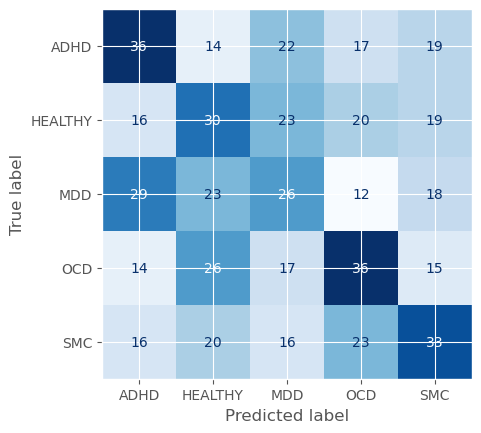

In [146]:
# final eval on val data for the best model during tuning
# get best model
best_model_path = trial.user_attrs["best_model_path"]
print(trial.params)
learning_rate = trial.params['learning_rate']
optimizer_name = trial.params['optimizer']
dropout = trial.params['dropout']
fc_layers = trial.params['fc_layers']
# Load the model directly from the checkpoint
model = graphLambda_w_edge_attr.load_from_checkpoint(best_model_path, learning_rate=learning_rate, optimizer_name=optimizer_name, dropout=dropout, fc_layers=fc_layers)

print(model.hparams)

val_loader = DataLoader(X_val, batch_size=len(X_val), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, val_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, val_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_val

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│          val_f1           │    0.2152291238307953     │
│         val_loss          │     3.334246873855591     │
└───────────────────────────┴───────────────────────────┘

classification report:
               precision    recall  f1-score   support

        ADHD       0.20      0.20      0.20        84
     HEALTHY       0.23      0.26      0.25        84
         MDD       0.19      0.23      0.21        84
         OCD       0.20      0.20      0.20        84
         SMC       0.28      0.19      0.22        96

    accuracy                           0.22       432
   macro avg       0.22      0.22      0.22       432
weighted avg       0.22      0.22      0.22       432

F1-score:
 0.21522912883903295


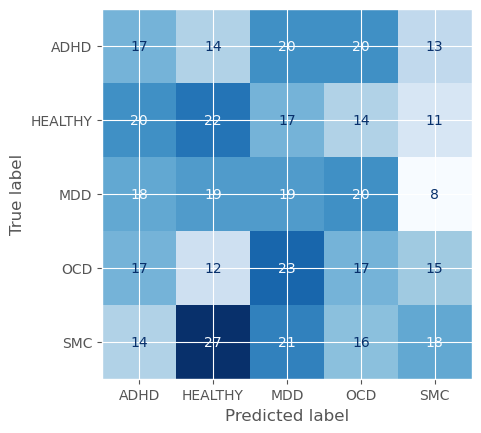

In [147]:
# final eval on test data for the best model during tuning

test_loader = DataLoader(X_test, batch_size=len(X_test), shuffle=False,
                            drop_last=True)

trainer = Trainer(accelerator='gpu', devices=1, enable_progress_bar=False, enable_model_summary=False, logger=False, enable_checkpointing=False)
trainer.validate(model, test_loader)

# compute confusion matrix and classification report with sklearn of best model checkpoint
from sklearn.metrics import f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
y_pred = trainer.predict(model, test_loader)
y_pred = np.concatenate(y_pred).flatten()
y = Y_test

class_labels = le.inverse_transform(sorted(np.unique(y)))
print('classification report:\n', classification_report(y, y_pred, target_names=class_labels))
print('F1-score:\n', f1_score(y, y_pred, average="macro"))
cm = confusion_matrix(y, y_pred)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels).plot(cmap = 'Blues', values_format = 'd', colorbar=False)


In [148]:
df_trials = pd.read_pickle('ratio_results_w_edge_attrs_trials.pkl')
df_trials.sort_values('value', ascending=False).head(10)

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_dropout,params_fc_layers,params_learning_rate,params_optimizer,user_attrs_best_model_path,state
13,13,0.293712,2024-06-22 05:28:04.410786,2024-06-22 05:34:10.017689,0 days 00:06:05.606903,680,0.124918,3,0.000113,RMSprop,/home/tsmolders/lightning_logs/version_813/che...,COMPLETE
50,50,0.288232,2024-06-22 08:11:03.459528,2024-06-22 08:17:12.949731,0 days 00:06:09.490203,680,0.096201,5,0.000336,Adam,/home/tsmolders/lightning_logs/version_850/che...,COMPLETE
24,24,0.284192,2024-06-22 06:10:25.390503,2024-06-22 06:16:29.450859,0 days 00:06:04.060356,680,0.056531,4,0.000494,Adam,/home/tsmolders/lightning_logs/version_824/che...,COMPLETE
55,55,0.279773,2024-06-22 08:30:10.372704,2024-06-22 08:34:35.005021,0 days 00:04:24.632317,340,0.084088,7,0.000465,Adam,/home/tsmolders/lightning_logs/version_855/che...,COMPLETE
80,80,0.277048,2024-06-22 10:05:43.508658,2024-06-22 10:14:41.703168,0 days 00:08:58.194510,850,0.094735,8,0.000312,RMSprop,/home/tsmolders/lightning_logs/version_880/che...,COMPLETE
90,90,0.271800,2024-06-22 10:46:26.047933,2024-06-22 10:50:45.366772,0 days 00:04:19.318839,340,0.065862,6,0.000208,RMSprop,/home/tsmolders/lightning_logs/version_890/che...,COMPLETE
79,79,0.271722,2024-06-22 09:59:36.563151,2024-06-22 10:05:43.504428,0 days 00:06:06.941277,680,0.091536,8,0.000393,RMSprop,/home/tsmolders/lightning_logs/version_879/che...,COMPLETE
52,52,0.270640,2024-06-22 08:17:26.934341,2024-06-22 08:23:40.640729,0 days 00:06:13.706388,680,0.105307,6,0.001471,Adam,/home/tsmolders/lightning_logs/version_852/che...,COMPLETE
0,0,0.267891,2024-06-22 04:49:12.218517,2024-06-22 04:52:06.086252,0 days 00:02:53.867735,170,0.304693,4,0.000097,Adam,/home/tsmolders/lightning_logs/version_800/che...,COMPLETE
27,27,0.266781,2024-06-22 06:19:46.022798,2024-06-22 06:25:50.936771,0 days 00:06:04.913973,680,0.001346,4,0.000056,Adam,/home/tsmolders/lightning_logs/version_827/che...,COMPLETE


#### Visualizations

/tmp/ipykernel_1631227/1755039964.py:2: ExperimentalWarning: plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


<Axes: title={'center': 'Optimization History Plot'}, xlabel='Trial', ylabel='Objective Value'>

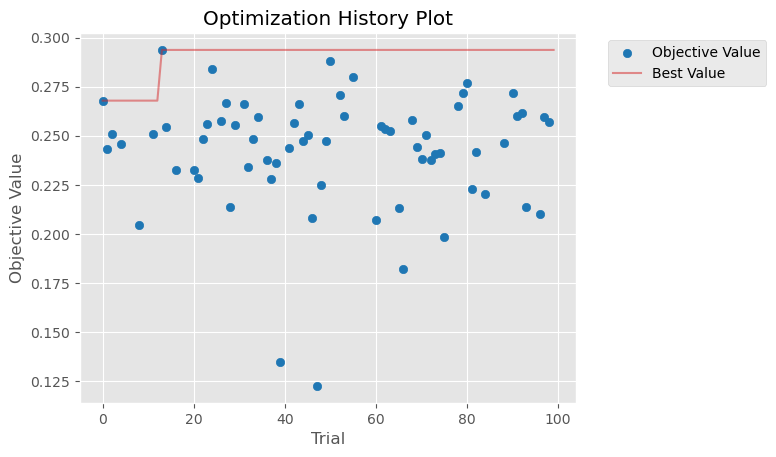

In [149]:
# Visualize the optimization history
plot_optimization_history(study)

[I 2024-06-22 11:21:49,510] A new study created in memory with name: no-name-c21fc1e2-2bb9-4475-9675-1e56c67666d4
/tmp/ipykernel_1631227/3414932042.py:7: ExperimentalWarning: plot_intermediate_values is experimental (supported from v2.2.0). The interface can change in the future.
  plot_intermediate_values(plotted_study)


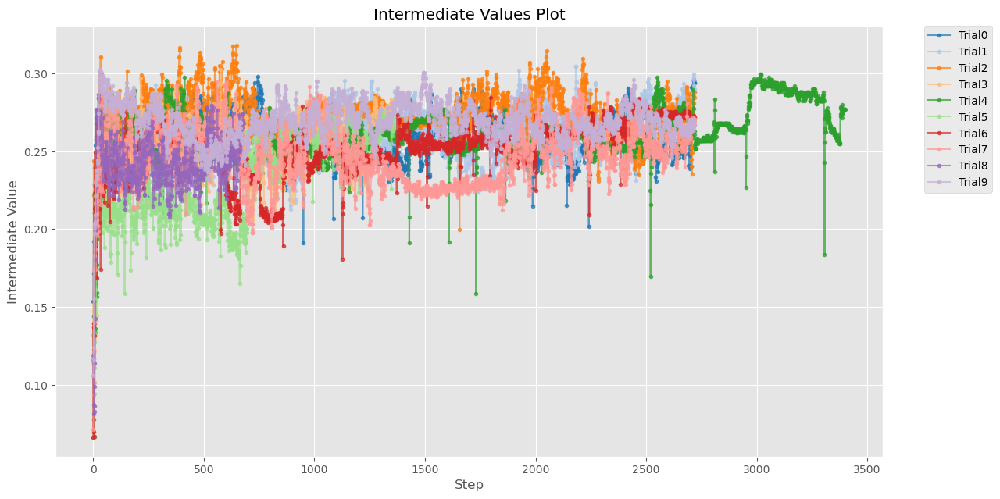

In [150]:
# Visualize the learning curves of the best 10 trials
trials = study.trials
plotted_trials = sorted(trials, key=lambda t: t.value, reverse=True)[:10]
plotted_study = optuna.create_study()
for trial in plotted_trials:
    plotted_study.add_trial(trial)
plot_intermediate_values(plotted_study)
set_size(10, 5)

/tmp/ipykernel_1631227/2919792376.py:2: ExperimentalWarning: plot_parallel_coordinate is experimental (supported from v2.2.0). The interface can change in the future.
  plot_parallel_coordinate(study)


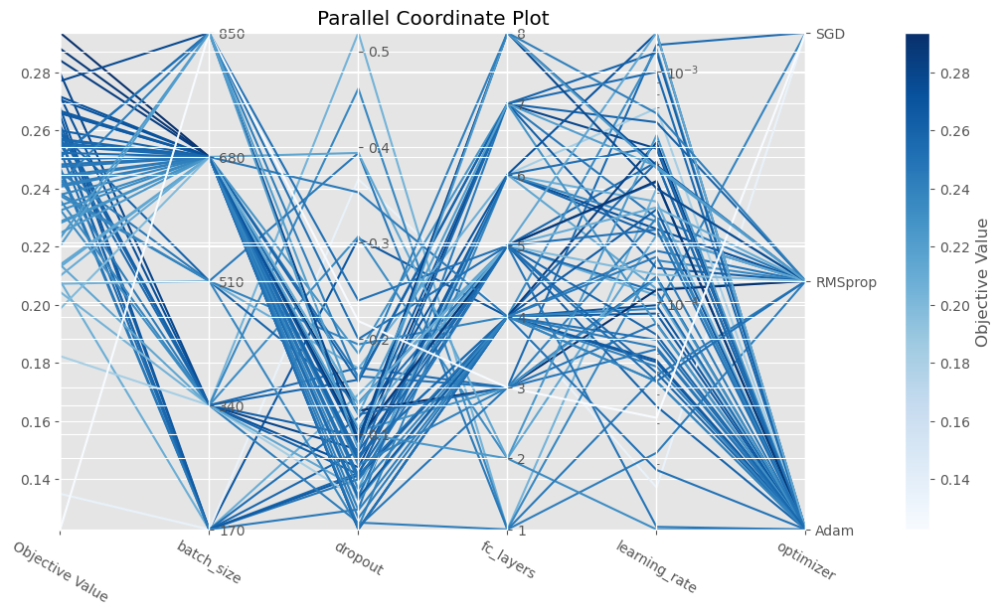

In [151]:
# Visualize high-dimensional parameter relationships.
plot_parallel_coordinate(study)
set_size(10, 5)

/tmp/ipykernel_1631227/624402143.py:2: ExperimentalWarning: plot_contour is experimental (supported from v2.2.0). The interface can change in the future.
  plot_contour(study)
[W 2024-06-22 11:21:50,687] Output figures of this Matplotlib-based `plot_contour` function would be different from those of the Plotly-based `plot_contour`.


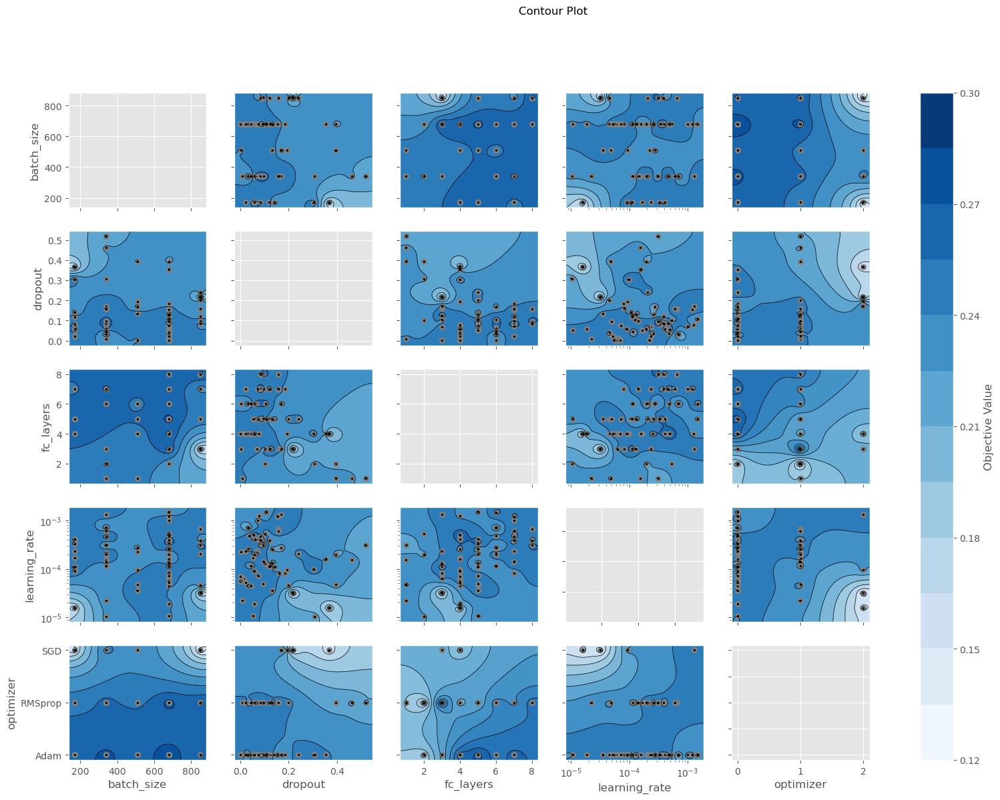

In [152]:
# Visualize hyperparameter relationships
plot_contour(study)
set_size(15, 10)

/tmp/ipykernel_1631227/1888575690.py:2: ExperimentalWarning: plot_slice is experimental (supported from v2.2.0). The interface can change in the future.
  plot_slice(study)


array([<Axes: xlabel='batch_size', ylabel='Objective Value'>,
       <Axes: xlabel='dropout'>, <Axes: xlabel='fc_layers'>,
       <Axes: xlabel='learning_rate'>, <Axes: xlabel='optimizer'>],
      dtype=object)

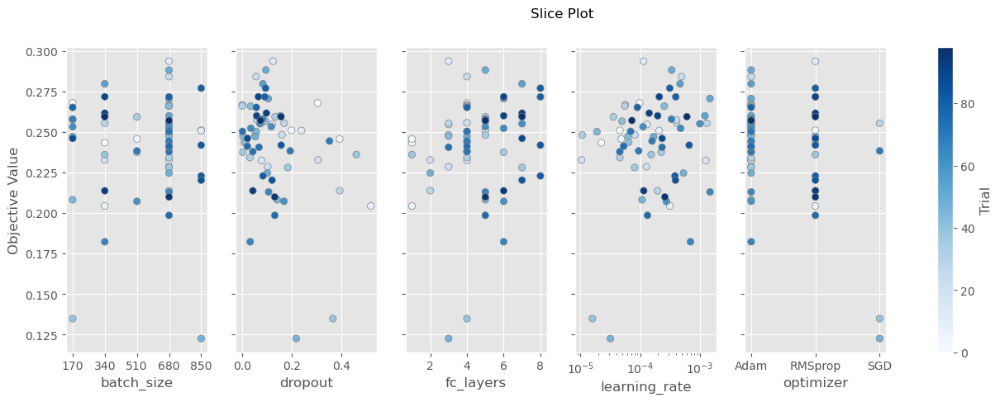

In [153]:
# Visualize individual hyperparameters as slice plot
plot_slice(study)

/tmp/ipykernel_1631227/1473508994.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

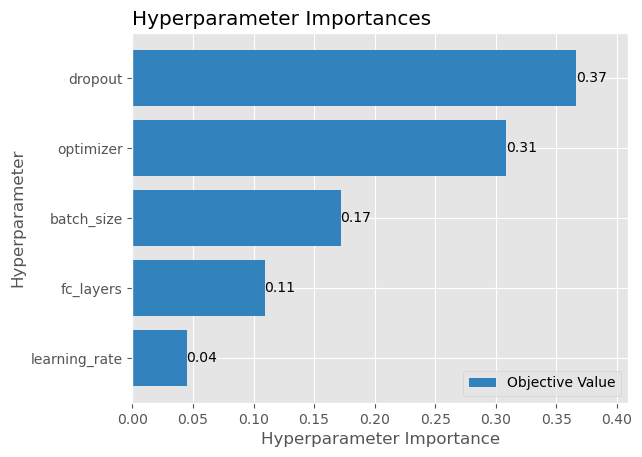

In [154]:
# Visualize parameter importances.
plot_param_importances(study)

/tmp/ipykernel_1631227/3113371256.py:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

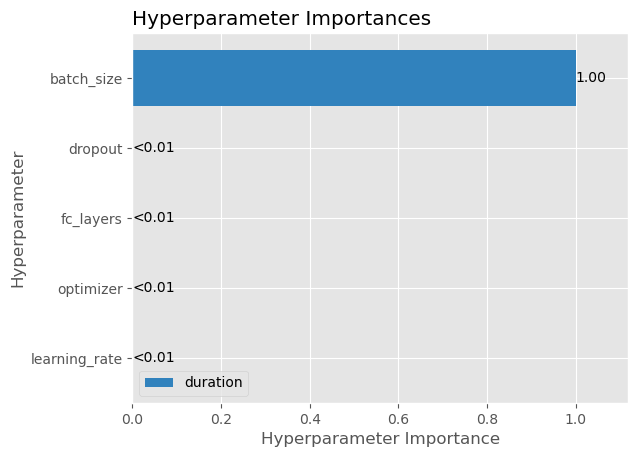

In [155]:
# Learn which hyperparameters are affecting the trial duration with hyperparameter importance.
plot_param_importances(
    study, target=lambda t: t.duration.total_seconds(), target_name="duration"
)

/tmp/ipykernel_1631227/1828777839.py:2: ExperimentalWarning: plot_edf is experimental (supported from v2.2.0). The interface can change in the future.
  plot_edf(study)


<Axes: title={'center': 'Empirical Distribution Function Plot'}, xlabel='Objective Value', ylabel='Cumulative Probability'>

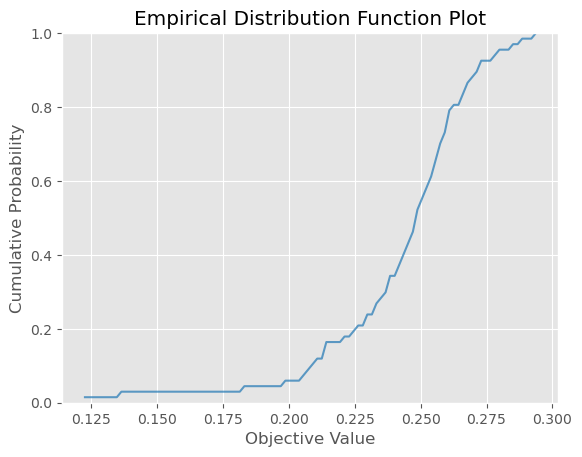

In [156]:
# Visualize empirical distribution function.
plot_edf(study)

/tmp/ipykernel_1631227/1172520691.py:2: ExperimentalWarning: plot_rank is experimental (supported from v3.2.0). The interface can change in the future.
  plot_rank(study)
[W 2024-06-22 11:21:57,654] Output figures of this Matplotlib-based `plot_rank` function would be different from those of the Plotly-based `plot_rank`.


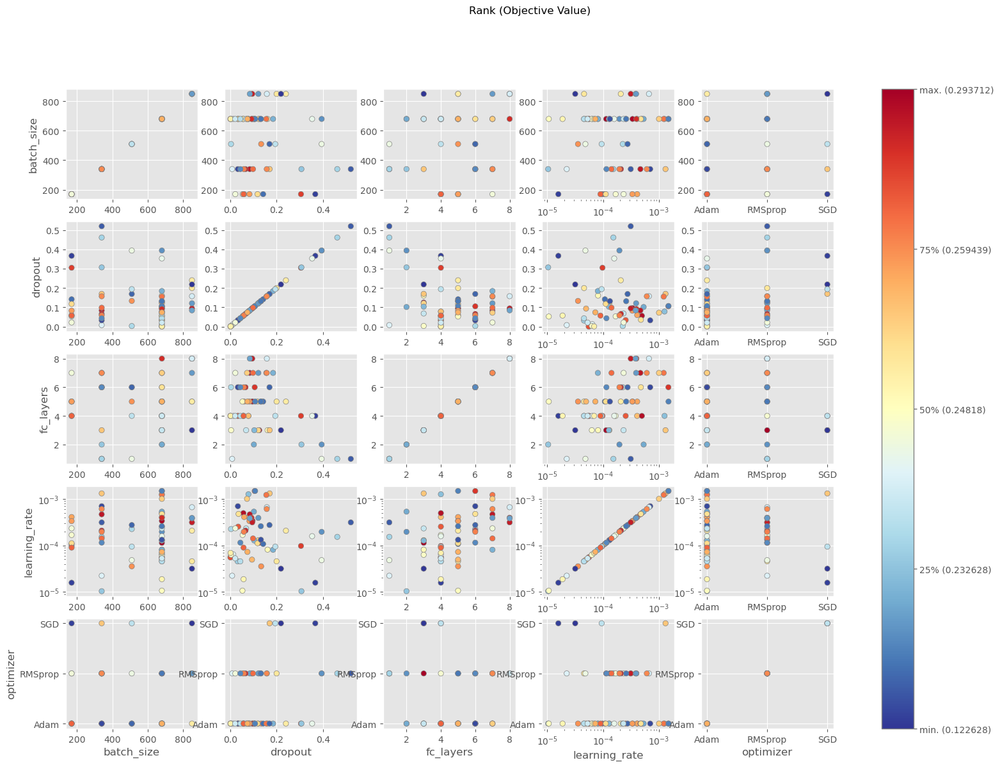

In [157]:
# Visualize parameter relations with scatter plots colored by objective values.
plot_rank(study)
set_size(15, 10)

/tmp/ipykernel_1631227/124343896.py:2: ExperimentalWarning: plot_timeline is experimental (supported from v3.2.0). The interface can change in the future.
  plot_timeline(study)


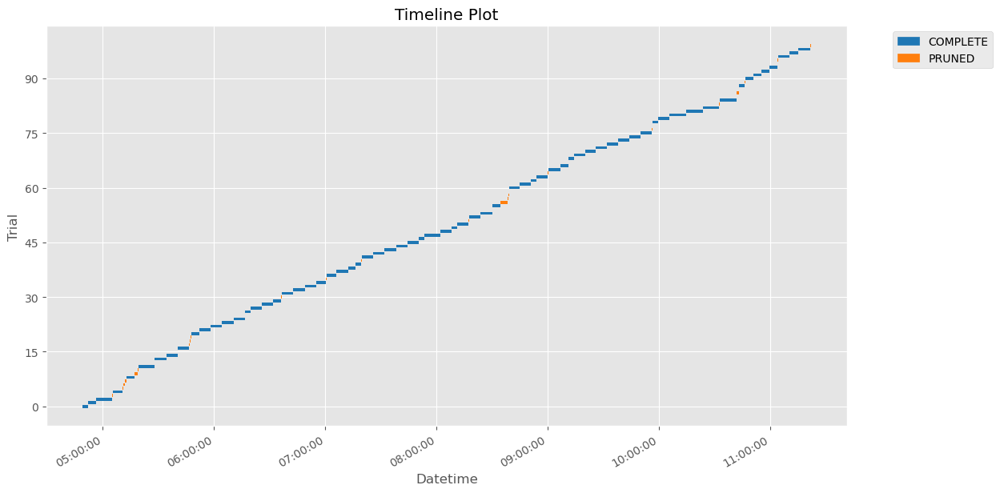

In [158]:
# Visualize the optimization timeline of performed trials.
plot_timeline(study)
set_size(10, 5)